In [1]:
# Cell 1 — imports & small helpers
import os, math, time, glob
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, random_split, Subset
from torch.amp import autocast, GradScaler
from tqdm.notebook import tqdm

plt.rcParams['figure.figsize'] = (8,4)

# reproducible
torch.manual_seed(42)
np.random.seed(42)

# small metric helpers
def pixel_accuracy(pred_logits, target, ignore_index=255):
    # pred_logits (B, C, H, W) or pred labels (B, H, W)
    if pred_logits.ndim == 4:
        preds = pred_logits.argmax(dim=1)
    else:
        preds = pred_logits
    valid = (target != ignore_index)
    if valid.sum().item() == 0:
        return float('nan')
    correct = ((preds == target) & valid).sum().item()
    total = valid.sum().item()
    return correct / (total + 1e-12)

def rmse_from_classes(pred_logits, target_classes, bin_size=1.0, ignore_index=255):
    pred_cls = pred_logits.argmax(dim=1)
    valid = (target_classes != ignore_index)
    if valid.sum().item() == 0:
        return float('nan')
    pred_h = (pred_cls.float() * bin_size)[valid]
    target_h = (target_classes.float() * bin_size)[valid]
    mse = ((pred_h - target_h)**2).mean().item()
    return math.sqrt(mse)


In [2]:
# Cell 2 — load processed npz (already cleaned / matched)
npz_path = "processed_tomosar_features.npz"   
assert os.path.exists(npz_path), f"{npz_path} not found. Save it first."

data = np.load(npz_path)
features_all = data["X"]        # (H, W, C)
CHM_q = data["CHM"]             # (H, W), quantized classes or 255
DTM_q = data["DTM"]
valid_mask = data["mask"].astype(bool)

print("Loaded shapes:", features_all.shape, CHM_q.shape, DTM_q.shape, valid_mask.shape)

# dataset class (same as you had, included for completeness)
class TomoSARFullGridDataset(torch.utils.data.Dataset):
    def __init__(self, features, chm_labels, dtm_labels, valid_mask,
                 patch_size=64, use_coords=True, normalize=True, ignore_index=255):
        self.X = features.transpose(2,0,1)  # (C,H,W)
        self.y_chm = chm_labels
        self.y_dtm = dtm_labels
        self.valid = valid_mask
        self.patch_size = patch_size
        self.half = patch_size//2
        self.use_coords = use_coords
        self.ignore_index = ignore_index
        self.C, self.H, self.W = self.X.shape

        # centers only on valid mask (keeps earlier spatial matching)
        self.centers = [(y,x) for y in range(self.H) for x in range(self.W) if self.valid[y,x]]

        # normalization computed over valid pixels
        if normalize:
            vals = self.X[:, self.valid].T  # shape (n_valid, C)
            self.mean = vals.mean(axis=0).astype(np.float32)
            self.std = (vals.std(axis=0) + 1e-6).astype(np.float32)
        else:
            self.mean = np.zeros(self.C, np.float32)
            self.std = np.ones(self.C, np.float32)

    def __len__(self):
        return len(self.centers)

    def __getitem__(self, idx):
        cy,cx = self.centers[idx]
        top,left = cy-self.half, cx-self.half
        patch_x = self._pad_and_crop(self.X, top, left)  # (C, P, P)
        patch_chm = self._pad_and_crop(self.y_chm[None], top, left)[0]
        patch_dtm = self._pad_and_crop(self.y_dtm[None], top, left)[0]

        # normalize
        patch_x = (patch_x - self.mean[:,None,None]) / self.std[:,None,None]

        # coords
        if self.use_coords:
            yy, xx = np.meshgrid(np.linspace(-1,1,self.patch_size), np.linspace(-1,1,self.patch_size), indexing='ij')
            patch_x = np.concatenate([patch_x, yy[None], xx[None]], axis=0)

        # clip labels to valid ranges (if any out-of-bounds appear)
        patch_chm = np.where((patch_chm>=0)&(patch_chm<=60), patch_chm, self.ignore_index)
        patch_dtm = np.where((patch_dtm>=0)&(patch_dtm<=40), patch_dtm, self.ignore_index)

        return {
            "x": torch.from_numpy(patch_x.astype(np.float32)),
            "chm": torch.from_numpy(patch_chm.astype(np.int64)),
            "dtm": torch.from_numpy(patch_dtm.astype(np.int64))
        }

    def _pad_and_crop(self, arr, top, left):
        C,H,W = arr.shape
        bottom, right = top + self.patch_size, left + self.patch_size
        top_clip, left_clip = max(0, top), max(0, left)
        bottom_clip, right_clip = min(H, bottom), min(W, right)
        patch = arr[:, top_clip:bottom_clip, left_clip:right_clip]
        pad_top = max(0, -top)
        pad_left = max(0, -left)
        pad_bottom = max(0, bottom - H)
        pad_right = max(0, right - W)
        if any([pad_top, pad_left, pad_bottom, pad_right]):
            patch = np.pad(patch, ((0,0),(pad_top,pad_bottom),(pad_left,pad_right)), mode='reflect')
        return patch

# construct dataset
patch_size = 64
use_coords = True
dataset = TomoSARFullGridDataset(features_all, CHM_q, DTM_q, valid_mask, patch_size=patch_size, use_coords=use_coords, normalize=True)
print("Dataset length (valid centers):", len(dataset))
print("Channels (before coords):", features_all.shape[2], "after coords:", dataset.X.shape[0] + (2 if use_coords else 0))


Loaded shapes: (2450, 1428, 70) (2450, 1428) (2450, 1428) (2450, 1428)
Dataset length (valid centers): 2555060
Channels (before coords): 70 after coords: 72


In [3]:
# === Cell 3 replacement: UNetMultiHead with 4 encoders + bottleneck + 4 decoders (your original design) ===
import torch.nn as nn
import torch

class UNetMultiHead(nn.Module):
    def __init__(self, in_ch, chm_classes=61, dtm_classes=41, base=32):
        """
        4-level encoder / bottleneck / 4-level decoder UNet.
        in_ch : number of input channels (70 or 72 if coords added)
        base  : base number of filters (32 is common)
        """
        super().__init__()

        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )

        # encoder
        self.enc1 = conv_block(in_ch, base)
        self.pool1 = nn.MaxPool2d(2)
        self.enc2 = conv_block(base, base*2)
        self.pool2 = nn.MaxPool2d(2)
        self.enc3 = conv_block(base*2, base*4)
        self.pool3 = nn.MaxPool2d(2)
        self.enc4 = conv_block(base*4, base*8)
        self.pool4 = nn.MaxPool2d(2)

        # bottleneck / center
        self.center = conv_block(base*8, base*16)

        # decoder (mirror)
        self.up4 = nn.ConvTranspose2d(base*16, base*8, kernel_size=2, stride=2)
        self.dec4 = conv_block(base*16, base*8)

        self.up3 = nn.ConvTranspose2d(base*8, base*4, kernel_size=2, stride=2)
        self.dec3 = conv_block(base*8, base*4)

        self.up2 = nn.ConvTranspose2d(base*4, base*2, kernel_size=2, stride=2)
        self.dec2 = conv_block(base*4, base*2)

        self.up1 = nn.ConvTranspose2d(base*2, base, kernel_size=2, stride=2)
        self.dec1 = conv_block(base*2, base)

        # heads
        self.out_chm = nn.Conv2d(base, chm_classes, kernel_size=1)
        self.out_dtm = nn.Conv2d(base, dtm_classes, kernel_size=1)

        # initialize weights (recommended)
        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
                nn.init.kaiming_normal_(m.weight, nonlinearity='relu')
                if getattr(m, "bias", None) is not None:
                    nn.init.zeros_(m.bias)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.ones_(m.weight)
                nn.init.zeros_(m.bias)

    def forward(self, x):
        # encoder
        e1 = self.enc1(x)           # (B, base, H, W)
        e2 = self.enc2(self.pool1(e1))  # (B, base*2, H/2, W/2)
        e3 = self.enc3(self.pool2(e2))  # (B, base*4, H/4, W/4)
        e4 = self.enc4(self.pool3(e3))  # (B, base*8, H/8, W/8)

        # center
        c = self.center(self.pool4(e4)) # (B, base*16, H/16, W/16)

        # decoder
        d4 = self.up4(c)
        d4 = self.dec4(torch.cat([d4, e4], dim=1))

        d3 = self.up3(d4)
        d3 = self.dec3(torch.cat([d3, e3], dim=1))

        d2 = self.up2(d3)
        d2 = self.dec2(torch.cat([d2, e2], dim=1))

        d1 = self.up1(d2)
        d1 = self.dec1(torch.cat([d1, e1], dim=1))

        out_chm = self.out_chm(d1)
        out_dtm = self.out_dtm(d1)
        return out_chm, out_dtm


In [7]:
# Cell 4 — training function (saves best model & plots)
from torch.amp import autocast, GradScaler
def train_and_save(
    dataset,
    out_dir="checkpoints",
    epochs=100,
    batch_size=16,
    lr=1e-4,
    device=None,
    val_ratio=0.1,
    test_ratio=0.1,
    base=32,
    patience=6,
    save_every_epoch=True
):
    os.makedirs(out_dir, exist_ok=True)
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")

    # deterministic split
    total = len(dataset)
    val_len = int(total * val_ratio)
    test_len = int(total * test_ratio)
    train_len = total - val_len - test_len
    train_ds, val_ds, test_ds = random_split(dataset, [train_len, val_len, test_len], generator=torch.Generator().manual_seed(42))
    print("Split sizes: train, val, test =", len(train_ds), len(val_ds), len(test_ds))

    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=0, pin_memory=True)
    val_loader   = DataLoader(val_ds, batch_size=batch_size, shuffle=False, num_workers=0, pin_memory=True)

    # infer input channels
    in_ch = dataset.X.shape[0] + (2 if dataset.use_coords else 0)
    model = UNetMultiHead(in_ch=in_ch, base=base).to(device)
    optimizer = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-4)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', factor=0.5, patience=4)
    scaler = GradScaler('cuda' if torch.cuda.is_available() else 'cpu')
    criterion = nn.CrossEntropyLoss(ignore_index=255)

    best_val_loss = float('inf')
    epochs_no_improve = 0

    # trackers
    history = {"train_loss": [], "val_loss": [], "val_acc_chm": [], "val_acc_dtm": [], "val_rmse_chm": [], "val_rmse_dtm": []}

    for epoch in range(1, epochs+1):
        t0 = time.time()
        model.train()
        running_loss = 0.0
        n_samples = 0

        #pbar = tqdm(train_loader, desc=f"Train {epoch}/{epochs}", leave=False)
        for batch in train_loader:
            x = batch["x"].to(device)
            y_chm = batch["chm"].to(device)
            y_dtm = batch["dtm"].to(device)

            # skip batches with zero valid pixels in either head
            if (y_chm != 255).sum() == 0 or (y_dtm != 255).sum() == 0:
                continue

            optimizer.zero_grad()
            with autocast(device_type='cuda' if torch.cuda.is_available() else 'cpu'):
                pred_chm, pred_dtm = model(x)
                loss = criterion(pred_chm, y_chm) + 0.5 * criterion(pred_dtm, y_dtm)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            running_loss += loss.item() * x.size(0)
            n_samples += x.size(0)
            #pbar.set_postfix({"loss": f"{loss.item():.4f}"})

        epoch_train_loss = running_loss / (n_samples + 1e-12)
        history["train_loss"].append(epoch_train_loss)

        # Validation
        model.eval()
        val_loss = 0.0
        acc_chm = 0.0
        acc_dtm = 0.0
        rmse_chm = 0.0
        rmse_dtm = 0.0
        val_samples = 0
        with torch.no_grad():
            for batch in val_loader:                       #tqdm(val_loader, desc=f"Validate {epoch}/{epochs}", leave=False):
                x = batch["x"].to(device)
                y_chm = batch["chm"].to(device)
                y_dtm = batch["dtm"].to(device)

                with autocast(device_type='cuda' if torch.cuda.is_available() else 'cpu'):
                    p_chm, p_dtm = model(x)
                    loss = criterion(p_chm, y_chm) + 0.5 * criterion(p_dtm, y_dtm)

                val_loss += loss.item() * x.size(0)
                acc_chm += pixel_accuracy(p_chm, y_chm) * x.size(0)
                acc_dtm += pixel_accuracy(p_dtm, y_dtm) * x.size(0)
                rmse_chm += rmse_from_classes(p_chm, y_chm) * x.size(0)
                rmse_dtm += rmse_from_classes(p_dtm, y_dtm) * x.size(0)
                val_samples += x.size(0)

        val_loss = val_loss / (val_samples + 1e-12)
        acc_chm = acc_chm / (val_samples + 1e-12)
        acc_dtm = acc_dtm / (val_samples + 1e-12)
        rmse_chm = rmse_chm / (val_samples + 1e-12)
        rmse_dtm = rmse_dtm / (val_samples + 1e-12)

        history["val_loss"].append(val_loss)
        history["val_acc_chm"].append(acc_chm)
        history["val_acc_dtm"].append(acc_dtm)
        history["val_rmse_chm"].append(rmse_chm)
        history["val_rmse_dtm"].append(rmse_dtm)

        # scheduler step (ReduceLROnPlateau)
        scheduler.step(val_loss)

        # logging
        print(f"Epoch {epoch}/{epochs} | train_loss: {epoch_train_loss:.4f} val_loss: {val_loss:.4f} "
              f"val_acc_chm: {acc_chm:.4f} val_acc_dtm: {acc_dtm:.4f} "
              f"val_rmse_chm: {rmse_chm:.3f} val_rmse_dtm: {rmse_dtm:.3f} time:{time.time()-t0:.1f}s")

        # save checkpoint
        ckpt = {
            "epoch": epoch,
            "model_state": model.state_dict(),
            "optim_state": optimizer.state_dict(),
            "val_loss": val_loss
        }
        if save_every_epoch:
            torch.save(ckpt, os.path.join(out_dir, f"epoch_{epoch:03d}.pth"))

        # save best
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(ckpt, os.path.join(out_dir, "best.pth"))
            print("Saved best.pth")
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1

        if epochs_no_improve >= patience:
            print("Early stopping triggered.")
            break

    # Plot & save curves
    fig, ax = plt.subplots(1,2, figsize=(12,4))
    ax[0].plot(history["train_loss"], label="train_loss")
    ax[0].plot(history["val_loss"], label="val_loss")
    ax[0].legend(); ax[0].set_title("Loss")
    ax[1].plot(history["val_rmse_chm"], label="val_rmse_chm")
    ax[1].plot(history["val_rmse_dtm"], label="val_rmse_dtm")
    ax[1].legend(); ax[1].set_title("Validation RMSE")
    plt.tight_layout()
    plt.savefig(os.path.join(out_dir, "training_curves.png"))
    plt.show()

    # save history
    np.savez_compressed(os.path.join(out_dir, "history.npz"), **history)

    return model, (train_ds, val_ds, test_ds), history


In [8]:
# Cell 5 — actually run training
out_dir = "checkpoints"
epochs = 100
batch_size = 16    # decrease if out of memory
lr = 1e-4
device = "cuda" if torch.cuda.is_available() else "cpu"

print(device)


cuda


Split sizes: train, val, test = 2044048 255506 255506
Epoch 1/100 | train_loss: 0.8576 val_loss: 0.3707 val_acc_chm: 0.8892 val_acc_dtm: 0.9051 val_rmse_chm: 0.338 val_rmse_dtm: 0.317 time:4275.7s
Saved best.pth
Epoch 2/100 | train_loss: 0.3787 val_loss: 0.2829 val_acc_chm: 0.9163 val_acc_dtm: 0.9240 val_rmse_chm: 0.292 val_rmse_dtm: 0.281 time:4300.7s
Saved best.pth
Epoch 3/100 | train_loss: 0.3083 val_loss: 0.2430 val_acc_chm: 0.9283 val_acc_dtm: 0.9341 val_rmse_chm: 0.270 val_rmse_dtm: 0.262 time:4288.6s
Saved best.pth
Epoch 4/100 | train_loss: 0.2742 val_loss: 0.2193 val_acc_chm: 0.9343 val_acc_dtm: 0.9432 val_rmse_chm: 0.258 val_rmse_dtm: 0.241 time:4285.0s
Saved best.pth
Epoch 5/100 | train_loss: 0.2532 val_loss: 0.2017 val_acc_chm: 0.9395 val_acc_dtm: 0.9486 val_rmse_chm: 0.248 val_rmse_dtm: 0.229 time:4386.9s
Saved best.pth
Epoch 6/100 | train_loss: 0.2385 val_loss: 0.1909 val_acc_chm: 0.9427 val_acc_dtm: 0.9515 val_rmse_chm: 0.241 val_rmse_dtm: 0.222 time:4348.8s
Saved best.pt

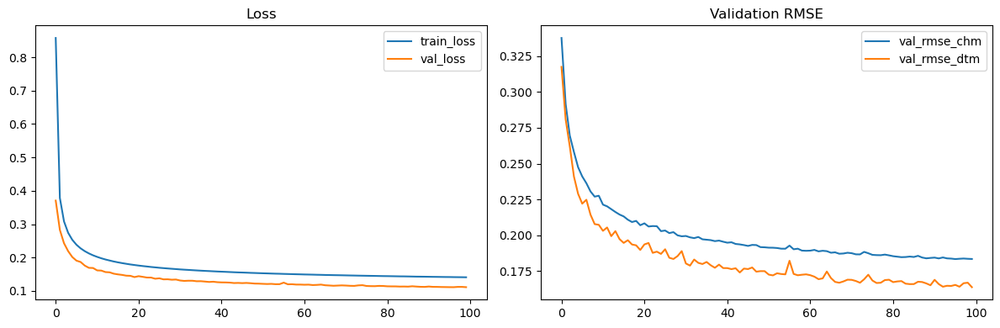

In [9]:
model, splits, history = train_and_save(
    dataset,
    out_dir=out_dir,
    epochs=epochs,
    batch_size=batch_size,
    lr=lr,
    device=device,
    val_ratio=0.1,
    test_ratio=0.1,
    base=32,
    patience=6,
    save_every_epoch=True
)
train_ds, val_ds, test_ds = splits

In [10]:
# Cell 6 — evaluate best model on test split, compute metrics and save pred maps
out_dir = "checkpoints"
best_path = os.path.join(out_dir, "best.pth")
assert os.path.exists(best_path), "best.pth not found — ensure training saved it."

ck = torch.load(best_path, map_location=device)
in_ch = dataset.X.shape[0] + (2 if dataset.use_coords else 0)
eval_model = UNetMultiHead(in_ch=in_ch).to(device)
eval_model.load_state_dict(ck["model_state"])
eval_model.eval()

# test DataLoader
test_loader = DataLoader(test_ds, batch_size=16, shuffle=False, num_workers=0, pin_memory=True)

# prepare result maps
H, W, _ = features_all.shape
pred_chm_map = np.full((H, W), 255, dtype=np.uint8)
pred_dtm_map = np.full((H, W), 255, dtype=np.uint8)

total_chm_valid = 0
correct_chm = 0
sse_chm = 0.0
total_dtm_valid = 0
correct_dtm = 0
sse_dtm = 0.0

center = patch_size // 2

# need mapping from test_ds (Subset) indices to dataset.centers
if isinstance(test_ds, Subset):
    test_indices = test_ds.indices
else:
    test_indices = list(range(len(dataset)))[-len(test_ds):]

ptr = 0
with torch.no_grad():
    for batch in tqdm(test_loader, desc="Test"):
        x = batch['x'].to(device)
        y_chm = batch['chm'].to(device)
        y_dtm = batch['dtm'].to(device)

        p_chm_logits, p_dtm_logits = eval_model(x)
        p_chm = p_chm_logits.argmax(dim=1).cpu().numpy()
        p_dtm = p_dtm_logits.argmax(dim=1).cpu().numpy()
        true_chm = y_chm.cpu().numpy()
        true_dtm = y_dtm.cpu().numpy()

        B = x.shape[0]
        for b in range(B):
            global_idx = test_indices[ptr + b]
            cy, cx = dataset.centers[global_idx]
            pred_chm_map[cy, cx] = p_chm[b, center, center]
            pred_dtm_map[cy, cx] = p_dtm[b, center, center]

        # metrics on center pixels
        pred_chm_cent = p_chm[:, center, center].astype(np.int64)
        true_chm_cent = true_chm[:, center, center].astype(np.int64)
        valid_mask_chm = (true_chm_cent != 255)
        if valid_mask_chm.sum() > 0:
            correct_chm += int((pred_chm_cent[valid_mask_chm] == true_chm_cent[valid_mask_chm]).sum())
            total_chm_valid += int(valid_mask_chm.sum())
            err = pred_chm_cent[valid_mask_chm].astype(np.float32) - true_chm_cent[valid_mask_chm].astype(np.float32)
            sse_chm += (err**2).sum()

        pred_dtm_cent = p_dtm[:, center, center].astype(np.int64)
        true_dtm_cent = true_dtm[:, center, center].astype(np.int64)
        valid_mask_dtm = (true_dtm_cent != 255)
        if valid_mask_dtm.sum() > 0:
            correct_dtm += int((pred_dtm_cent[valid_mask_dtm] == true_dtm_cent[valid_mask_dtm]).sum())
            total_dtm_valid += int(valid_mask_dtm.sum())
            err2 = pred_dtm_cent[valid_mask_dtm].astype(np.float32) - true_dtm_cent[valid_mask_dtm].astype(np.float32)
            sse_dtm += (err2**2).sum()

        ptr += B

acc_chm = correct_chm / (total_chm_valid + 1e-12)
rmse_chm = math.sqrt(sse_chm / (total_chm_valid + 1e-12))
acc_dtm = correct_dtm / (total_dtm_valid + 1e-12)
rmse_dtm = math.sqrt(sse_dtm / (total_dtm_valid + 1e-12))

print(f"Test center-pixel CHM acc: {acc_chm:.4f}, CHM RMSE: {rmse_chm:.3f}")
print(f"Test center-pixel DTM acc: {acc_dtm:.4f}, DTM RMSE: {rmse_dtm:.3f}")

# Save predicted maps
np.savez_compressed(os.path.join(out_dir, "predictions_test.npz"),
                    pred_chm_map=pred_chm_map, pred_dtm_map=pred_dtm_map,
                    acc_chm=acc_chm, rmse_chm=rmse_chm, acc_dtm=acc_dtm, rmse_dtm=rmse_dtm)
print("Saved predictions_test.npz")


Test:   0%|          | 0/15970 [00:00<?, ?it/s]

Test center-pixel CHM acc: 0.9789, CHM RMSE: 0.145
Test center-pixel DTM acc: 0.9831, DTM RMSE: 0.130
Saved predictions_test.npz


In [23]:
# 1) fraction of pixels predicted (non-255) in your pred map
import numpy as np
data = np.load("checkpoints/predictions_test.npz")
pred = data['pred_chm_map']
total = pred.size
pred_count = np.sum(pred != 255)
print("Predicted pixels:", pred_count, " / ", total, "  (fraction:", pred_count/total, ")")


Predicted pixels: 255506  /  3498600   (fraction: 0.07303092665637684 )


In [24]:
# 2) Show a scatter of predicted coordinates to visualize distribution of centers:
ys, xs = np.where(pred != 255)
print("Example predicted pixel coords sample:", list(zip(ys[:10], xs[:10])))


Example predicted pixel coords sample: [(np.int64(27), np.int64(1119)), (np.int64(28), np.int64(1117)), (np.int64(29), np.int64(1109)), (np.int64(30), np.int64(1100)), (np.int64(30), np.int64(1102)), (np.int64(30), np.int64(1114)), (np.int64(30), np.int64(1115)), (np.int64(31), np.int64(1088)), (np.int64(31), np.int64(1097)), (np.int64(31), np.int64(1106))]


In [25]:
# 3) sanity check: are dataset.centers length consistent with total sample count?
print("len(dataset.centers) =", len(dataset.centers))


len(dataset.centers) = 2555060


In [26]:
# Run dense inference (predict for every valid pixel)
best_path = "checkpoints/best.pth"
out_dir = "predictions_unlabeled"
os.makedirs(out_dir, exist_ok=True)

# Use your features_all (H,W,C) and a valid_mask that marks positions you want predictions for.
# If you want EVERY pixel, use valid_mask = np.ones((H,W), dtype=bool)
valid_mask_dense = np.ones((features_all.shape[0], features_all.shape[1]), dtype=bool)

out = recompute_with_uncertainty_on_unlabeled(
    best_path=best_path,
    features_all=features_all,
    valid_mask=valid_mask_dense,
    patch_size=patch_size,      # must match dataset.patch_size used for training
    use_coords=True,            # must match training setting
    out_dir=out_dir,
    batch_size=16,             # reduce if OOM
    device="cuda"               # or "cpu"
)
# out['pred_chm_map'] / out['pred_dtm_map'] will be dense over valid_mask_dense


Predict unlabeled (uncertainty):  56%|████████████████████████████▎                      | 121369/218663 [1:28:42<1:09:03, 23.48it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

Predict unlabeled (uncertainty): 100%|█████████████████████████████████████████████████████| 218663/218663 [2:40:30<00:00, 22.71it/s]


Saved: predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz


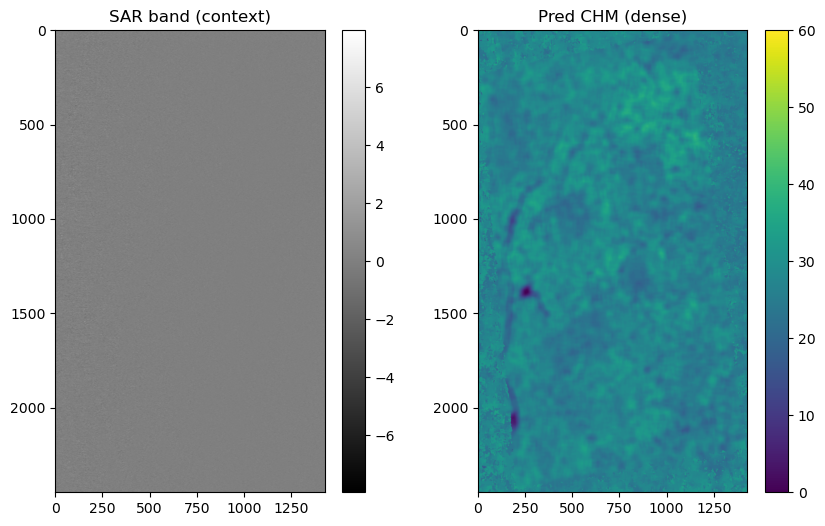

In [27]:
# assuming out is from recompute_with_uncertainty_on_unlabeled and features_all exists
sar_band0 = features_all[..., -18] if features_all.shape[-1] >= 18 else None  # adjust if SAR bands location differs
pred = out['pred_chm_map'].astype(float); pred[pred==255]=np.nan

plt.figure(figsize=(10,6))
plt.subplot(1,2,1)
plt.title("SAR band (context)")
plt.imshow(sar_band0, cmap='gray')
plt.colorbar()
plt.subplot(1,2,2)
plt.title("Pred CHM (dense)")
plt.imshow(pred, cmap='viridis', vmin=0, vmax=60)
plt.colorbar()
plt.show()


Keys in file: ['pred_chm_map', 'pred_dtm_map', 'prob_chm_map', 'prob_dtm_map', 'entropy_chm_map', 'entropy_dtm_map', 'centers']


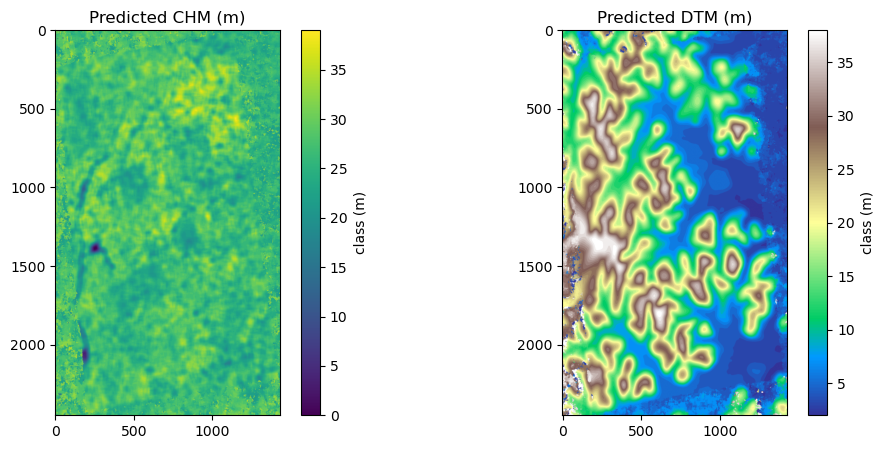

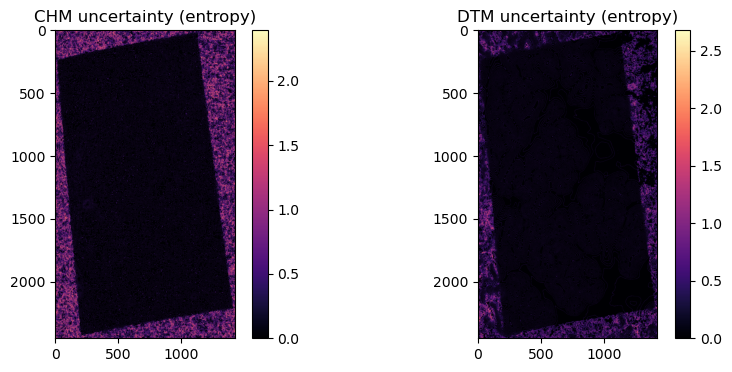

In [28]:
import numpy as np
import matplotlib.pyplot as plt

# === Load the saved npz ===
out_path = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"
data = np.load(out_path)

print("Keys in file:", list(data.keys()))

pred_chm = data["pred_chm_map"]   # predicted canopy height map
pred_dtm = data["pred_dtm_map"]   # predicted ground map

# Optional: if uncertainty maps were saved
entropy_chm = data.get("entropy_chm_map")
entropy_dtm = data.get("entropy_dtm_map")

# === Quick visualization ===
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.title("Predicted CHM (m)")
plt.imshow(pred_chm, cmap="viridis")
plt.colorbar(label="class (m)")

plt.subplot(1,2,2)
plt.title("Predicted DTM (m)")
plt.imshow(pred_dtm, cmap="terrain")
plt.colorbar(label="class (m)")
plt.show()

# === If you want to inspect uncertainty too ===
if entropy_chm is not None:
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.title("CHM uncertainty (entropy)")
    plt.imshow(entropy_chm, cmap="magma")
    plt.colorbar()
    plt.subplot(1,2,2)
    plt.title("DTM uncertainty (entropy)")
    plt.imshow(entropy_dtm, cmap="magma")
    plt.colorbar()
    plt.show()


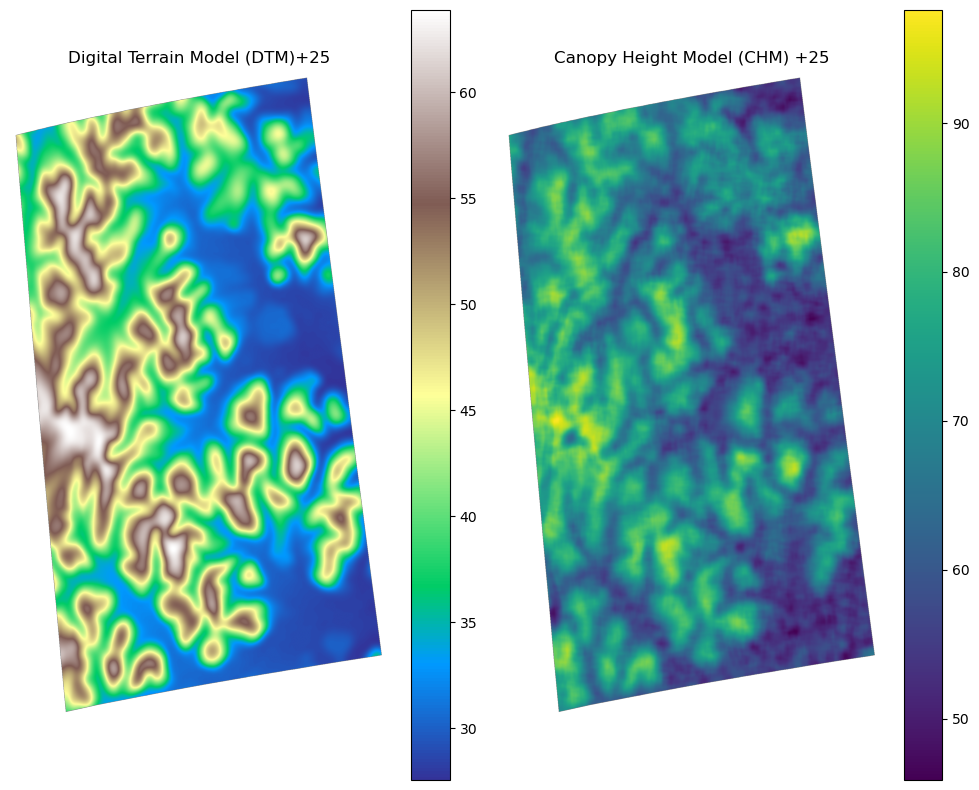

In [37]:
real_DTM = DTM + 25
real_CHM = DTM + CHM + 25

plt.figure(figsize=(10, 8))

# Plot
plt.subplot(1, 2, 1)
plt.imshow(real_DTM, cmap='terrain')
plt.title('Digital Terrain Model (DTM)+25')
plt.axis('off')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.imshow(real_CHM, cmap='viridis')
plt.title('Canopy Height Model (CHM) +25')
plt.axis('off')
plt.colorbar()


plt.tight_layout()

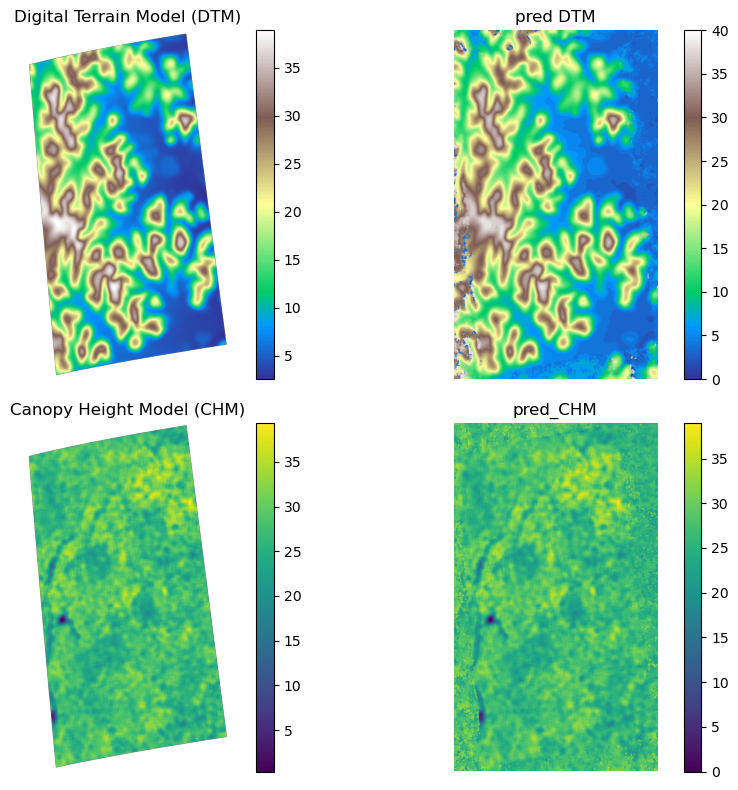

In [72]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io

# === Load predictions ===
pred_path = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"
pred_data = np.load(pred_path)

pred_chm = pred_data["pred_chm_map"]
pred_dtm = pred_data["pred_dtm_map"]

# === Load ground truth ===
mat_file_path = "DataSets/dataset_Guiana_6FPimages_Pband.mat"
mat_data = scipy.io.loadmat(mat_file_path)

CHM = mat_data["CHM"]
DTM = mat_data["DTM"]

# shift to absolute values (+25)
#real_DTM = DTM + 25
#real_CHM = DTM + CHM + 25


plt.figure(figsize=(10, 8))

# Plot
plt.subplot(2, 2, 1)
plt.imshow(DTM, cmap='terrain')
plt.title('Digital Terrain Model (DTM)')
plt.axis('off')
plt.colorbar()

plt.subplot(2, 2, 2)
plt.imshow(pred_dtm, cmap='terrain',vmin=0, vmax=40)
plt.title('pred DTM')
plt.axis('off')
plt.colorbar()

plt.subplot(2, 2, 3)
plt.imshow(CHM, cmap='viridis')
plt.title('Canopy Height Model (CHM)')
plt.axis('off')
plt.colorbar()

plt.subplot(2, 2, 4)
plt.imshow(pred_chm, cmap='viridis',)
plt.title('pred_CHM')
plt.axis('off')
plt.colorbar()
plt.tight_layout()
plt.show()


In [49]:
import numpy as np

# load preds and GT if not in session
preds_npz = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"
d = np.load(preds_npz)
pred_chm = d["pred_chm_map"].astype(np.float32)
pred_dtm = d["pred_dtm_map"].astype(np.float32)
# load GT .mat if not in memory
import scipy.io
mat = scipy.io.loadmat("DataSets/dataset_Guiana_6FPimages_Pband.mat")
GT_CHM = mat["CHM"].astype(np.float32)    # canopy height (m)
GT_DTM = mat["DTM"].astype(np.float32)    # terrain elevation (m)

print("pred_chm min/max/unique_sample:",
      np.nanmin(pred_chm), np.nanmax(pred_chm),
      np.unique(pred_chm)[0:10] if np.unique(pred_chm).size < 50 else np.unique(pred_chm)[0:10])
print("pred_dtm min/max:", np.nanmin(pred_dtm), np.nanmax(pred_dtm))
print("GT_CHM min/max (raw):", np.nanmin(GT_CHM), np.nanmax(GT_CHM))
print("GT_DTM min/max (raw):", np.nanmin(GT_DTM), np.nanmax(GT_DTM))
print("Counts: pred valid pixels:", np.sum(pred_chm != 255), " / ", pred_chm.size)


pred_chm min/max/unique_sample: 0.0 39.0 [0. 1. 2. 3. 4. 5. 6. 7. 8. 9.]
pred_dtm min/max: 2.0 38.0
GT_CHM min/max (raw): 0.38514152 39.352684
GT_DTM min/max (raw): 2.5524793 38.88043
Counts: pred valid pixels: 3498600  /  3498600


RMSE before calibration — CHM: 0.293 m,  DTM: 0.291 m
Calibration CHM: gt ≈ a*pred + b  -> a=0.9903, b=0.266
Calibration DTM: gt ≈ a*pred + b  -> a=1.0003, b=-0.005
RMSE after  calibration — CHM: 0.291 m,  DTM: 0.291 m


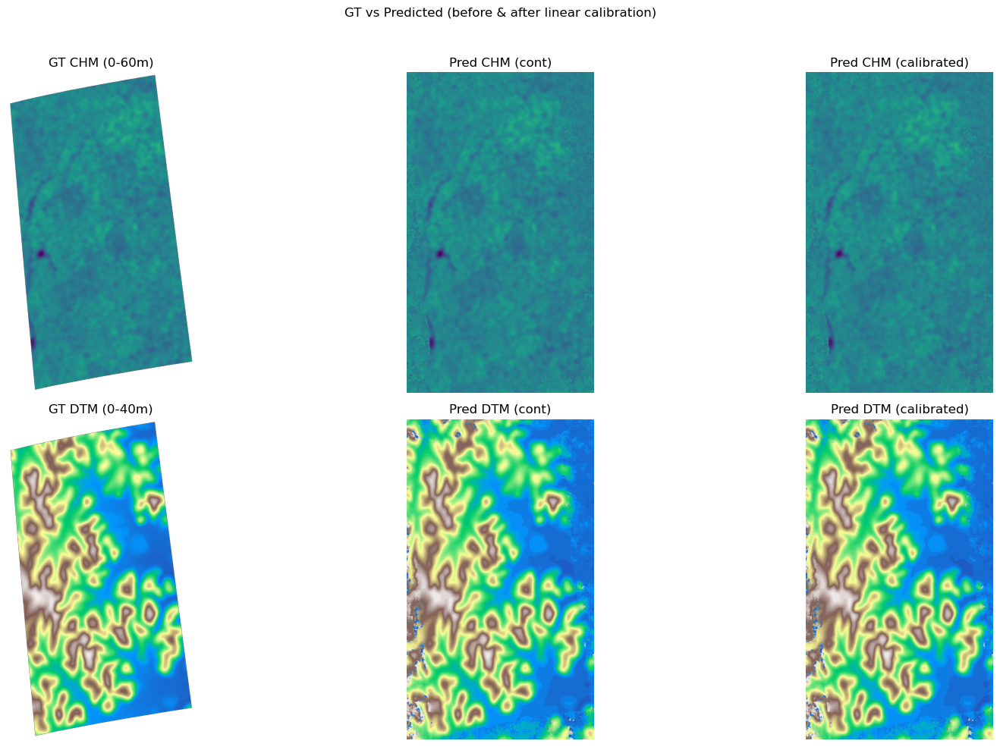

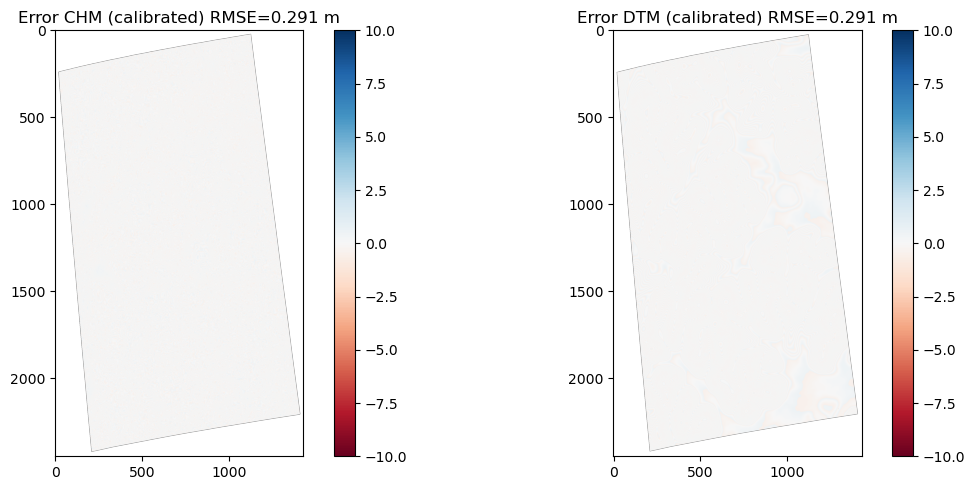

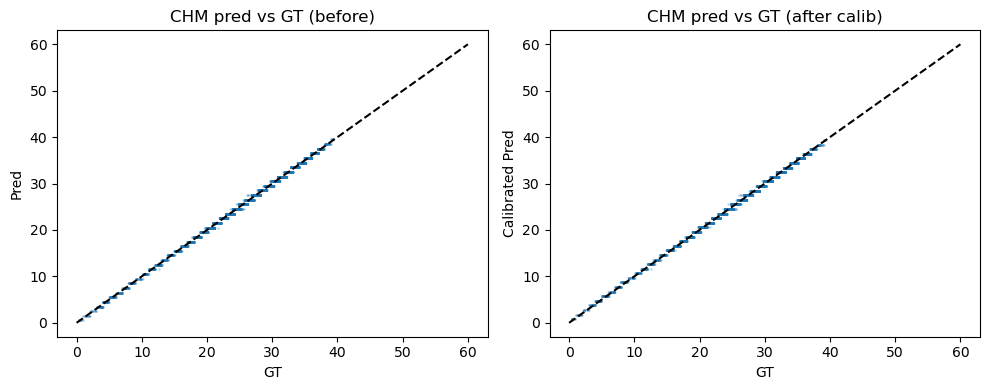

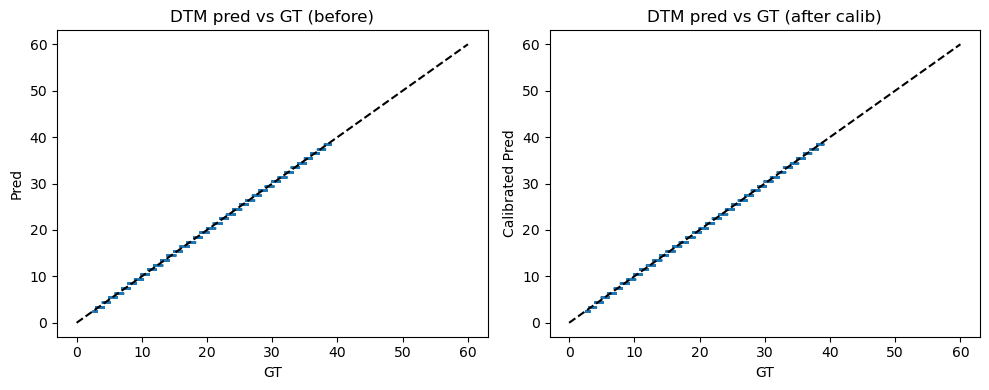

Saved visualizations to: test/visualizations


In [51]:
# === Compute RMSE, calibrate, visualize & save ===
import numpy as np, matplotlib.pyplot as plt, os, math, random, scipy.io

# Paths / names (update if needed)
pred_npz = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"
mat_path  = "DataSets/dataset_Guiana_6FPimages_Pband.mat"
viz_dir   = "test/visualizations"
os.makedirs(viz_dir, exist_ok=True)

# Load predictions
d = np.load(pred_npz)
pred_chm = d["pred_chm_map"].astype(np.float32)   # integers 0..K
pred_dtm = d["pred_dtm_map"].astype(np.float32)

# Convert class -> continuous height (bin center)
pred_chm_cont = np.where(pred_chm==255, np.nan, pred_chm + 0.5)
pred_dtm_cont = np.where(pred_dtm==255, np.nan, pred_dtm + 0.5)

# Load GT (raw canopy/terrain heights; NOT DTM+CHM+25)
m = scipy.io.loadmat(mat_path)
GT_CHM = m["CHM"].astype(np.float32)
GT_DTM = m["DTM"].astype(np.float32)

# Clip GT to valid ranges used in training (optional) and create masks
mask_chm = (~np.isnan(GT_CHM)) & (GT_CHM >= 0) & (GT_CHM <= 60)
mask_dtm = (~np.isnan(GT_DTM)) & (GT_DTM >= 0) & (GT_DTM <= 40)

# Intersection with prediction validity
mask_chm &= (~np.isnan(pred_chm_cont))
mask_dtm &= (~np.isnan(pred_dtm_cont))

def rmse_on_mask(pred, gt, mask):
    if mask.sum() == 0:
        return float("nan")
    err = pred[mask].astype(np.float32) - gt[mask].astype(np.float32)
    return math.sqrt(np.mean(err**2))

rmse_chm_before = rmse_on_mask(pred_chm_cont, GT_CHM, mask_chm)
rmse_dtm_before = rmse_on_mask(pred_dtm_cont, GT_DTM, mask_dtm)
print(f"RMSE before calibration — CHM: {rmse_chm_before:.3f} m,  DTM: {rmse_dtm_before:.3f} m")

# --- Linear calibration using a random sample (use validation set in proper pipeline) ---
def calibrate_linear(pred_map, gt_map, mask, sample_size=200000, rng_seed=42):
    idxs = np.argwhere(mask)
    if idxs.shape[0] == 0:
        return 1.0, 0.0  # no-op
    # sample points for stable fitting if many
    rng = np.random.default_rng(rng_seed)
    if idxs.shape[0] > sample_size:
        sel = rng.choice(idxs.shape[0], sample_size, replace=False)
        idxs = idxs[sel]
    y = gt_map[idxs[:,0], idxs[:,1]].ravel()
    x = pred_map[idxs[:,0], idxs[:,1]].ravel()
    # fit y = a * x + b
    a, b = np.polyfit(x, y, 1)
    return float(a), float(b)

a_chm, b_chm = calibrate_linear(pred_chm_cont, GT_CHM, mask_chm, sample_size=200000)
a_dtm, b_dtm = calibrate_linear(pred_dtm_cont, GT_DTM, mask_dtm, sample_size=200000)
print("Calibration CHM: gt ≈ a*pred + b  -> a={:.4f}, b={:.3f}".format(a_chm, b_chm))
print("Calibration DTM: gt ≈ a*pred + b  -> a={:.4f}, b={:.3f}".format(a_dtm, b_dtm))

# Apply calibration
pred_chm_cal = np.where(np.isnan(pred_chm_cont), np.nan, a_chm * pred_chm_cont + b_chm)
pred_dtm_cal = np.where(np.isnan(pred_dtm_cont), np.nan, a_dtm * pred_dtm_cont + b_dtm)

rmse_chm_after = rmse_on_mask(pred_chm_cal, GT_CHM, mask_chm)
rmse_dtm_after = rmse_on_mask(pred_dtm_cal, GT_DTM, mask_dtm)
print(f"RMSE after  calibration — CHM: {rmse_chm_after:.3f} m,  DTM: {rmse_dtm_after:.3f} m")

# === Visualization ===
# 1) Full pred & GT (fixed vmin/vmax)
fig, ax = plt.subplots(2,3, figsize=(18,10))
ax = ax.flatten()
ax[0].imshow(GT_CHM, cmap='viridis', vmin=0, vmax=60); ax[0].set_title("GT CHM (0-60m)")
ax[1].imshow(pred_chm_cont, cmap='viridis', vmin=0, vmax=60); ax[1].set_title("Pred CHM (cont)")
ax[2].imshow(pred_chm_cal, cmap='viridis', vmin=0, vmax=60); ax[2].set_title("Pred CHM (calibrated)")
ax[3].imshow(GT_DTM, cmap='terrain', vmin=0, vmax=40); ax[3].set_title("GT DTM (0-40m)")
ax[4].imshow(pred_dtm_cont, cmap='terrain', vmin=0, vmax=40); ax[4].set_title("Pred DTM (cont)")
ax[5].imshow(pred_dtm_cal, cmap='terrain', vmin=0, vmax=40); ax[5].set_title("Pred DTM (calibrated)")
for a in ax: a.axis('off')
plt.suptitle("GT vs Predicted (before & after linear calibration)")
plt.tight_layout(rect=[0,0,1,0.96])
plt.savefig(os.path.join(viz_dir, "pred_gt_full_calibration.png"), dpi=200)
plt.show()

# 2) Error maps (calibrated) and histograms
err_chm = pred_chm_cal - GT_CHM
err_dtm = pred_dtm_cal - GT_DTM

# Mask invalids for plotting as NaN -> will show white
err_chm_plot = np.where(mask_chm, err_chm, np.nan)
err_dtm_plot = np.where(mask_dtm, err_dtm, np.nan)

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.title(f"Error CHM (calibrated) RMSE={rmse_chm_after:.3f} m")
plt.imshow(err_chm_plot, cmap='RdBu', vmin=-10, vmax=10)
plt.colorbar()
plt.subplot(1,2,2)
plt.title(f"Error DTM (calibrated) RMSE={rmse_dtm_after:.3f} m")
plt.imshow(err_dtm_plot, cmap='RdBu', vmin=-10, vmax=10)
plt.colorbar()
plt.tight_layout()
plt.savefig(os.path.join(viz_dir, "error_maps_calibrated.png"), dpi=200)
plt.show()

# 3) Scatter plots (sample)
def scatter_and_save(pred_map, pred_cal, gt_map, mask, name):
    idxs = np.argwhere(mask)
    N = idxs.shape[0]
    sample = np.arange(N) if N<=200000 else np.random.choice(N, 200000, replace=False)
    idxs_s = idxs[sample]
    x = pred_map[idxs_s[:,0], idxs_s[:,1]].ravel()
    xc = pred_cal[idxs_s[:,0], idxs_s[:,1]].ravel()
    y = gt_map[idxs_s[:,0], idxs_s[:,1]].ravel()
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.title(f"{name} pred vs GT (before)")
    plt.scatter(y, x, s=1, alpha=0.2)
    plt.plot([0,60],[0,60],'k--')
    plt.xlabel("GT"); plt.ylabel("Pred")
    plt.subplot(1,2,2)
    plt.title(f"{name} pred vs GT (after calib)")
    plt.scatter(y, xc, s=1, alpha=0.2)
    plt.plot([0,60],[0,60],'k--')
    plt.xlabel("GT"); plt.ylabel("Calibrated Pred")
    plt.tight_layout()
    plt.savefig(os.path.join(viz_dir, f"scatter_{name}.png"), dpi=200)
    plt.show()

scatter_and_save(pred_chm_cont, pred_chm_cal, GT_CHM, mask_chm, "CHM")
scatter_and_save(pred_dtm_cont, pred_dtm_cal, GT_DTM, mask_dtm, "DTM")

print("Saved visualizations to:", viz_dir)


In [52]:
import numpy as np, os, math
from sklearn.metrics import r2_score

viz_dir = "test"
os.makedirs(viz_dir, exist_ok=True)

def stats(pred, gt, mask):
    mask = mask & (~np.isnan(pred)) & (~np.isnan(gt))
    if mask.sum() == 0:
        return dict(count=0, rmse=np.nan, mae=np.nan, bias=np.nan, r2=np.nan)
    p = pred[mask].ravel().astype(np.float32)
    g = gt[mask].ravel().astype(np.float32)
    err = p - g
    return dict(
        count=int(mask.sum()),
        rmse=float(math.sqrt((err**2).mean())),
        mae=float(np.abs(err).mean()),
        bias=float(err.mean()),
        r2=float(r2_score(g, p))
    )

# compute using calibrated preds (but same for uncalibrated)
stats_chm = stats(pred_chm_cal, GT_CHM, mask_chm)
stats_dtm = stats(pred_dtm_cal, GT_DTM, mask_dtm)

print("CHM stats:", stats_chm)
print("DTM stats:", stats_dtm)

# Save summary
summary = {"chm": stats_chm, "dtm": stats_dtm}
np.savez_compressed(os.path.join(viz_dir, "metrics_summary.npz"), **summary)

# Save a simple CSV for inclusion in paper
import csv
csv_path = os.path.join(viz_dir, "metrics_table.csv")
with open(csv_path, "w", newline="") as f:
    w = csv.writer(f)
    w.writerow(["metric","CHM","DTM"])
    w.writerow(["count", stats_chm["count"], stats_dtm["count"]])
    w.writerow(["rmse (m)", f"{stats_chm['rmse']:.3f}", f"{stats_dtm['rmse']:.3f}"])
    w.writerow(["mae (m)", f"{stats_chm['mae']:.3f}", f"{stats_dtm['mae']:.3f}"])
    w.writerow(["bias (m)", f"{stats_chm['bias']:.3f}", f"{stats_dtm['bias']:.3f}"])
    w.writerow(["R^2", f"{stats_chm['r2']:.4f}", f"{stats_dtm['r2']:.4f}"])

print("Saved metrics to:", viz_dir)


CHM stats: {'count': 2570197, 'rmse': 0.2911378872468903, 'mae': 0.24999819695949554, 'bias': -7.340125011978671e-05, 'r2': 0.9909456968307495}
DTM stats: {'count': 2555060, 'rmse': 0.29083718839502365, 'mae': 0.2505687177181244, 'bias': 0.00040658560465089977, 'r2': 0.9989721775054932}
Saved metrics to: test


In [57]:
import h5py, scipy.io, numpy as np, math, os
import matplotlib.pyplot as plt
from scipy import ndimage
import csv

# -------------------------
# Paths (adjust if needed)
# -------------------------
music_path = "TM/MUSIC_Height_FullScene.mat"   # example file
mat_gt_path = "DataSets/dataset_Guiana_6FPimages_Pband.mat"  # GT

out_dir = "test/compare_music"
os.makedirs(out_dir, exist_ok=True)

# -------------------------
# Load MUSIC arrays (h5py)
# -------------------------
with h5py.File(music_path, 'r') as f:
    print("Available variables:", list(f.keys()))
    chm_hh = f['Tomo_CHM_hh'][:].astype(np.float32)
    chm_hv = f['Tomo_CHM_hv'][:].astype(np.float32)
    chm_vv = f['Tomo_CHM_vv'][:].astype(np.float32)
    dtm_hh = f['Tomo_DTM_hh'][:].astype(np.float32)
    dtm_hv = f['Tomo_DTM_hv'][:].astype(np.float32)
    dtm_vv = f['Tomo_DTM_vv'][:].astype(np.float32)

# Load GT
m = scipy.io.loadmat(mat_gt_path)
GT_CHM = m['CHM'].astype(np.float32)
GT_DTM = m['DTM'].astype(np.float32)

print("GT_CHM shape:", GT_CHM.shape, "MUSIC chm_hh shape:", chm_hh.shape)

# -------------------------
# Helper utilities
# -------------------------
def try_transforms_and_choose(src, gt, mask_gt):
    """
    Try candidate transforms (transpose, flips, rotations) that make src.shape == gt.shape.
    For each transform that matches shape, compute RMSE on mask_gt ∩ ~isnan(src) and return
    the transformed array with the lowest RMSE.
    """
    candidates = {}
    # basic transforms
    transforms = {
        'identity': lambda a: a,
        'transpose': lambda a: a.T,
        'rot90': lambda a: np.rot90(a, k=1),
        'rot270': lambda a: np.rot90(a, k=3),
        'flipud': lambda a: np.flipud(a),
        'fliplr': lambda a: np.fliplr(a),
        'transpose+flipud': lambda a: np.flipud(a.T),
        'transpose+fliplr': lambda a: np.fliplr(a.T)
    }
    best = None
    best_rmse = float('inf')
    best_name = None
    for name, fn in transforms.items():
        try:
            cand = fn(src)
        except Exception:
            continue
        if cand.shape != gt.shape:
            continue
        # compute RMSE on intersection mask
        valid = mask_gt & (~np.isnan(cand))
        if valid.sum() == 0:
            continue
        err = cand[valid].astype(np.float32) - gt[valid].astype(np.float32)
        rmse = math.sqrt((err**2).mean())
        candidates[name] = (cand, rmse)
        if rmse < best_rmse:
            best_rmse = rmse
            best = cand
            best_name = name
    return best_name, best, best_rmse, candidates

def resample_to(src, target_shape):
    # simple bilinear-ish resizing using ndimage.zoom
    src_h, src_w = src.shape
    tgt_h, tgt_w = target_shape
    zoom_y = tgt_h / src_h
    zoom_x = tgt_w / src_w
    # order=1 linear interpolation
    res = ndimage.zoom(src, (zoom_y, zoom_x), order=1)
    return res

def compute_metrics(pred, gt, mask):
    idx = mask & (~np.isnan(pred))
    if idx.sum() == 0:
        return {"rmse":np.nan, "mae":np.nan, "bias":np.nan, "count":0}
    err = pred[idx].astype(np.float32) - gt[idx].astype(np.float32)
    return {"rmse": float(math.sqrt((err**2).mean())), 
            "mae": float(np.abs(err).mean()),
            "bias": float(err.mean()),
            "count": int(idx.sum())}

# -------------------------
# Align each MUSIC array to GT
# -------------------------
# Mask GT valid ranges (same as training)
mask_chm_gt = (~np.isnan(GT_CHM)) & (GT_CHM >= 0) & (GT_CHM <= 60)
mask_dtm_gt = (~np.isnan(GT_DTM)) & (GT_DTM >= 0) & (GT_DTM <= 40)

# function to align & return aligned array
def align_src_to_gt(src, gt, mask_gt):
    # quick check if shapes match
    if src.shape == gt.shape:
        return src, "identity"
    # try transforms that preserve shape after transform
    name, best, best_rmse, cand_map = try_transforms_and_choose(src, gt, mask_gt)
    if best is not None:
        print(f"Chose transform '{name}' with RMSE {best_rmse:.3f}")
        return best, name
    # else try resampling/interpolation if shapes truly differ
    print("No direct transform matched. Resampling source to GT resolution (may blur).")
    res = resample_to(src, gt.shape)
    return res, "resampled"

# Align CHM pols
chm_hh_a, t1 = align_src_to_gt(chm_hh, GT_CHM, mask_chm_gt)
chm_hv_a, t2 = align_src_to_gt(chm_hv, GT_CHM, mask_chm_gt)
chm_vv_a, t3 = align_src_to_gt(chm_vv, GT_CHM, mask_chm_gt)
dtm_hh_a, _ = align_src_to_gt(dtm_hh, GT_DTM, mask_dtm_gt)
dtm_hv_a, _ = align_src_to_gt(dtm_hv, GT_DTM, mask_dtm_gt)
dtm_vv_a, _ = align_src_to_gt(dtm_vv, GT_DTM, mask_dtm_gt)

# -------------------------
# Compute per-pol metrics and average
# -------------------------
chm_stats = {}
dtm_stats = {}

chm_stats['hh'] = compute_metrics(chm_hh_a, GT_CHM, mask_chm_gt)
chm_stats['hv'] = compute_metrics(chm_hv_a, GT_CHM, mask_chm_gt)
chm_stats['vv'] = compute_metrics(chm_vv_a, GT_CHM, mask_chm_gt)
chm_avg = np.nanmean(np.stack([chm_hh_a, chm_hv_a, chm_vv_a], axis=0), axis=0)
chm_stats['avg'] = compute_metrics(chm_avg, GT_CHM, mask_chm_gt)

dtm_stats['hh'] = compute_metrics(dtm_hh_a, GT_DTM, mask_dtm_gt)
dtm_stats['hv'] = compute_metrics(dtm_hv_a, GT_DTM, mask_dtm_gt)
dtm_stats['vv'] = compute_metrics(dtm_vv_a, GT_DTM, mask_dtm_gt)
dtm_avg = np.nanmean(np.stack([dtm_hh_a, dtm_hv_a, dtm_vv_a], axis=0), axis=0)
dtm_stats['avg'] = compute_metrics(dtm_avg, GT_DTM, mask_dtm_gt)

print("CHM stats:", chm_stats)
print("DTM stats:", dtm_stats)

# Save a CSV summary
csvfile = os.path.join(out_dir, "music_metrics_summary.csv")
with open(csvfile, "w", newline="") as f:
    writer = csv.writer(f)
    writer.writerow(["method","type","rmse","mae","bias","count"])
    for pol, s in chm_stats.items():
        writer.writerow([f"MUSIC_{pol}", "CHM", s["rmse"], s["mae"], s["bias"], s["count"]])
    for pol, s in dtm_stats.items():
        writer.writerow([f"MUSIC_{pol}", "DTM", s["rmse"], s["mae"], s["bias"], s["count"]])

print("Saved metrics to:", csvfile)

# Save a couple of diagnostic PNGs (avg maps and error maps)
plt.imsave(os.path.join(out_dir, "music_chm_avg.png"), chm_avg, cmap="viridis", vmin=0, vmax=60)
plt.imsave(os.path.join(out_dir, "music_dtm_avg.png"), dtm_avg, cmap="terrain", vmin=0, vmax=40)
err_chm = np.where(mask_chm_gt, chm_avg - GT_CHM, np.nan)
err_dtm = np.where(mask_dtm_gt, dtm_avg - GT_DTM, np.nan)
plt.imsave(os.path.join(out_dir, "music_chm_err.png"), err_chm, cmap="RdBu", vmin=-10, vmax=10)
plt.imsave(os.path.join(out_dir, "music_dtm_err.png"), err_dtm, cmap="RdBu", vmin=-10, vmax=10)

print("Saved diagnostic PNGs to:", out_dir)


Available variables: ['Tomo_CHM_hh', 'Tomo_CHM_hv', 'Tomo_CHM_vv', 'Tomo_DTM_hh', 'Tomo_DTM_hv', 'Tomo_DTM_vv']
GT_CHM shape: (2450, 1428) MUSIC chm_hh shape: (1428, 2450)
Chose transform 'rot270' with RMSE 30.490
Chose transform 'rot90' with RMSE 42.449
Chose transform 'rot270' with RMSE 30.814
Chose transform 'transpose' with RMSE 27.919
Chose transform 'transpose' with RMSE 35.106
Chose transform 'transpose' with RMSE 28.785
CHM stats: {'hh': {'rmse': 30.489641275319332, 'mae': 27.303359985351562, 'bias': 27.266799926757812, 'count': 2570197}, 'hv': {'rmse': 42.448570099776326, 'mae': 40.619224548339844, 'bias': 40.619224548339844, 'count': 2570197}, 'vv': {'rmse': 30.813591432875647, 'mae': 27.35993003845215, 'bias': 27.329936981201172, 'count': 2570197}, 'avg': {'rmse': 32.911387449150865, 'mae': 31.738662719726562, 'bias': 31.738662719726562, 'count': 2570197}}
DTM stats: {'hh': {'rmse': 27.91890198218091, 'mae': 26.979799270629883, 'bias': 26.979494094848633, 'count': 2555060}, 

In [58]:
import h5py, scipy.io, numpy as np, math, os
import matplotlib.pyplot as plt
from scipy import ndimage
import csv

# -------------------------
# Paths (adjust if needed)
# -------------------------
music_path = "TM/MUSIC_Height_FullScene.mat"   # example file
mat_gt_path = "DataSets/dataset_Guiana_6FPimages_Pband.mat"  # GT


out_dir = "test/compare_music"
os.makedirs(out_dir, exist_ok=True)

# -------------------------
# Load MUSIC arrays (h5py)
# -------------------------
with h5py.File(music_path, 'r') as f:
    print("Available variables:", list(f.keys()))
    chm_hh = f['Tomo_CHM_hh'][:].astype(np.float32)
    chm_hv = f['Tomo_CHM_hv'][:].astype(np.float32)
    chm_vv = f['Tomo_CHM_vv'][:].astype(np.float32)
    dtm_hh = f['Tomo_DTM_hh'][:].astype(np.float32)
    dtm_hv = f['Tomo_DTM_hv'][:].astype(np.float32)
    dtm_vv = f['Tomo_DTM_vv'][:].astype(np.float32)

# Load GT
m = scipy.io.loadmat(mat_gt_path)
CHM = m['CHM']
DTM = m['DTM']
GT_DTM = DTM +25
GT_CHM =CHM + DTM + 25

GT_CHM = GT_CHM.astype(np.float32)
GT_DTM = GT_DTM.astype(np.float32)

print("GT_CHM shape:", GT_CHM.shape, "MUSIC chm_hh shape:", chm_hh.shape)

# -------------------------
# Helper utilities
# -------------------------
def try_transforms_and_choose(src, gt, mask_gt):
    """
    Try candidate transforms (transpose, flips, rotations) that make src.shape == gt.shape.
    For each transform that matches shape, compute RMSE on mask_gt ∩ ~isnan(src) and return
    the transformed array with the lowest RMSE.
    """
    candidates = {}
    # basic transforms
    transforms = {
        'identity': lambda a: a,
        'transpose': lambda a: a.T,
        'rot90': lambda a: np.rot90(a, k=1),
        'rot270': lambda a: np.rot90(a, k=3),
        'flipud': lambda a: np.flipud(a),
        'fliplr': lambda a: np.fliplr(a),
        'transpose+flipud': lambda a: np.flipud(a.T),
        'transpose+fliplr': lambda a: np.fliplr(a.T)
    }
    best = None
    best_rmse = float('inf')
    best_name = None
    for name, fn in transforms.items():
        try:
            cand = fn(src)
        except Exception:
            continue
        if cand.shape != gt.shape:
            continue
        # compute RMSE on intersection mask
        valid = mask_gt & (~np.isnan(cand))
        if valid.sum() == 0:
            continue
        err = cand[valid].astype(np.float32) - gt[valid].astype(np.float32)
        rmse = math.sqrt((err**2).mean())
        candidates[name] = (cand, rmse)
        if rmse < best_rmse:
            best_rmse = rmse
            best = cand
            best_name = name
    return best_name, best, best_rmse, candidates

def resample_to(src, target_shape):
    # simple bilinear-ish resizing using ndimage.zoom
    src_h, src_w = src.shape
    tgt_h, tgt_w = target_shape
    zoom_y = tgt_h / src_h
    zoom_x = tgt_w / src_w
    # order=1 linear interpolation
    res = ndimage.zoom(src, (zoom_y, zoom_x), order=1)
    return res

def compute_metrics(pred, gt, mask):
    idx = mask & (~np.isnan(pred))
    if idx.sum() == 0:
        return {"rmse":np.nan, "mae":np.nan, "bias":np.nan, "count":0}
    err = pred[idx].astype(np.float32) - gt[idx].astype(np.float32)
    return {"rmse": float(math.sqrt((err**2).mean())), 
            "mae": float(np.abs(err).mean()),
            "bias": float(err.mean()),
            "count": int(idx.sum())}

# -------------------------
# Align each MUSIC array to GT
# -------------------------
# Mask GT valid ranges (same as training)
mask_chm_gt = (~np.isnan(GT_CHM)) & (GT_CHM >= 0) & (GT_CHM <= 60)
mask_dtm_gt = (~np.isnan(GT_DTM)) & (GT_DTM >= 0) & (GT_DTM <= 40)

# function to align & return aligned array
def align_src_to_gt(src, gt, mask_gt):
    # quick check if shapes match
    if src.shape == gt.shape:
        return src, "identity"
    # try transforms that preserve shape after transform
    name, best, best_rmse, cand_map = try_transforms_and_choose(src, gt, mask_gt)
    if best is not None:
        print(f"Chose transform '{name}' with RMSE {best_rmse:.3f}")
        return best, name
    # else try resampling/interpolation if shapes truly differ
    print("No direct transform matched. Resampling source to GT resolution (may blur).")
    res = resample_to(src, gt.shape)
    return res, "resampled"

# Align CHM pols
chm_hh_a, t1 = align_src_to_gt(chm_hh, GT_CHM, mask_chm_gt)
chm_hv_a, t2 = align_src_to_gt(chm_hv, GT_CHM, mask_chm_gt)
chm_vv_a, t3 = align_src_to_gt(chm_vv, GT_CHM, mask_chm_gt)
dtm_hh_a, _ = align_src_to_gt(dtm_hh, GT_DTM, mask_dtm_gt)
dtm_hv_a, _ = align_src_to_gt(dtm_hv, GT_DTM, mask_dtm_gt)
dtm_vv_a, _ = align_src_to_gt(dtm_vv, GT_DTM, mask_dtm_gt)

# -------------------------
# Compute per-pol metrics and average
# -------------------------
chm_stats = {}
dtm_stats = {}

chm_stats['hh'] = compute_metrics(chm_hh_a, GT_CHM, mask_chm_gt)
chm_stats['hv'] = compute_metrics(chm_hv_a, GT_CHM, mask_chm_gt)
chm_stats['vv'] = compute_metrics(chm_vv_a, GT_CHM, mask_chm_gt)
chm_avg = np.nanmean(np.stack([chm_hh_a, chm_hv_a, chm_vv_a], axis=0), axis=0)
chm_stats['avg'] = compute_metrics(chm_avg, GT_CHM, mask_chm_gt)

dtm_stats['hh'] = compute_metrics(dtm_hh_a, GT_DTM, mask_dtm_gt)
dtm_stats['hv'] = compute_metrics(dtm_hv_a, GT_DTM, mask_dtm_gt)
dtm_stats['vv'] = compute_metrics(dtm_vv_a, GT_DTM, mask_dtm_gt)
dtm_avg = np.nanmean(np.stack([dtm_hh_a, dtm_hv_a, dtm_vv_a], axis=0), axis=0)
dtm_stats['avg'] = compute_metrics(dtm_avg, GT_DTM, mask_dtm_gt)

print("CHM stats:", chm_stats)
print("DTM stats:", dtm_stats)

# Save a CSV summary
csvfile = os.path.join(out_dir, "music_metrics_summary.csv")
with open(csvfile, "w", newline="") as f:
    writer = csv.writer(f)
    writer.writerow(["method","type","rmse","mae","bias","count"])
    for pol, s in chm_stats.items():
        writer.writerow([f"MUSIC_{pol}", "CHM", s["rmse"], s["mae"], s["bias"], s["count"]])
    for pol, s in dtm_stats.items():
        writer.writerow([f"MUSIC_{pol}", "DTM", s["rmse"], s["mae"], s["bias"], s["count"]])

print("Saved metrics to:", csvfile)

# Save a couple of diagnostic PNGs (avg maps and error maps)
plt.imsave(os.path.join(out_dir, "music_chm_avg.png"), chm_avg, cmap="viridis", vmin=0, vmax=60)
plt.imsave(os.path.join(out_dir, "music_dtm_avg.png"), dtm_avg, cmap="terrain", vmin=0, vmax=40)
err_chm = np.where(mask_chm_gt, chm_avg - GT_CHM, np.nan)
err_dtm = np.where(mask_dtm_gt, dtm_avg - GT_DTM, np.nan)
plt.imsave(os.path.join(out_dir, "music_chm_err.png"), err_chm, cmap="RdBu", vmin=-10, vmax=10)
plt.imsave(os.path.join(out_dir, "music_dtm_err.png"), err_dtm, cmap="RdBu", vmin=-10, vmax=10)

print("Saved diagnostic PNGs to:", out_dir)


Available variables: ['Tomo_CHM_hh', 'Tomo_CHM_hv', 'Tomo_CHM_vv', 'Tomo_DTM_hh', 'Tomo_DTM_hv', 'Tomo_DTM_vv']
GT_CHM shape: (2450, 1428) MUSIC chm_hh shape: (1428, 2450)
Chose transform 'rot270' with RMSE 12.635
Chose transform 'transpose' with RMSE 10.332
Chose transform 'rot270' with RMSE 13.560
Chose transform 'transpose' with RMSE 7.387
Chose transform 'transpose' with RMSE 11.272
Chose transform 'transpose' with RMSE 7.106
CHM stats: {'hh': {'rmse': 12.635090336538951, 'mae': 10.218721389770508, 'bias': 2.2050623893737793, 'count': 606997}, 'hv': {'rmse': 10.331655017370123, 'mae': 9.446013450622559, 'bias': 5.0224151611328125, 'count': 606997}, 'vv': {'rmse': 13.560142206667269, 'mae': 11.100183486938477, 'bias': 2.4250752925872803, 'count': 606997}, 'avg': {'rmse': 9.701272735470758, 'mae': 7.9549241065979, 'bias': 3.217517852783203, 'count': 606997}}
DTM stats: {'hh': {'rmse': 7.386761871486377, 'mae': 4.227156162261963, 'bias': 1.7179958820343018, 'count': 1302301}, 'hv': {'

RMSEs (for displayed arrays):
CNN CHM RMSE: 30.464668196137985
MUSIC CHM RMSE (corrected): 53.11165733180664
CNN DTM RMSE: 24.989464332728677
MUSIC DTM RMSE (corrected): 20.67503622252533


/tmp/ipykernel_33694/2506331027.py:94: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0,0,1,0.96])


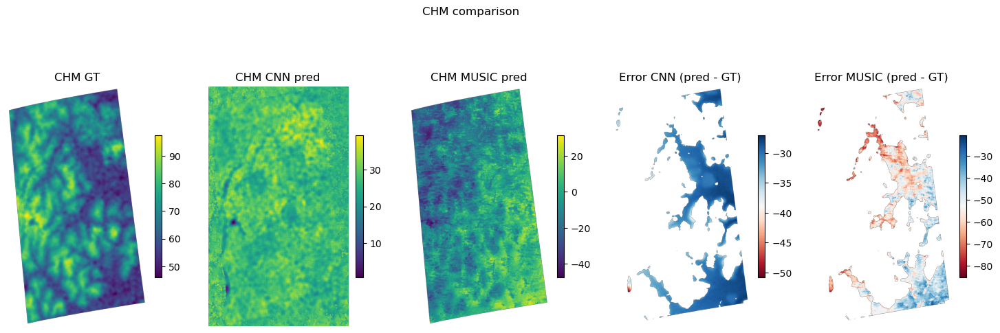

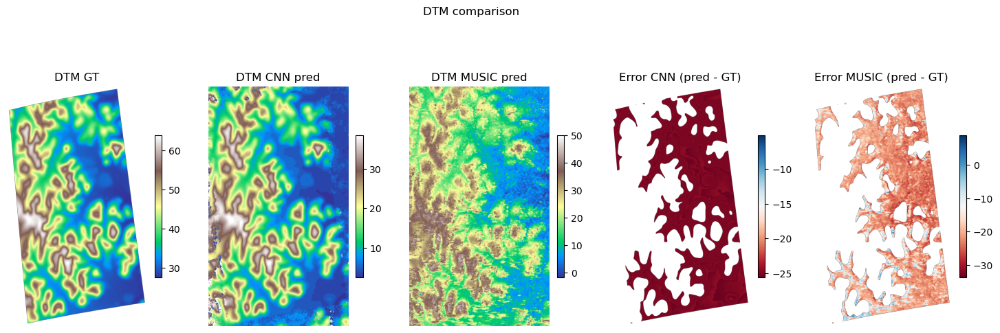

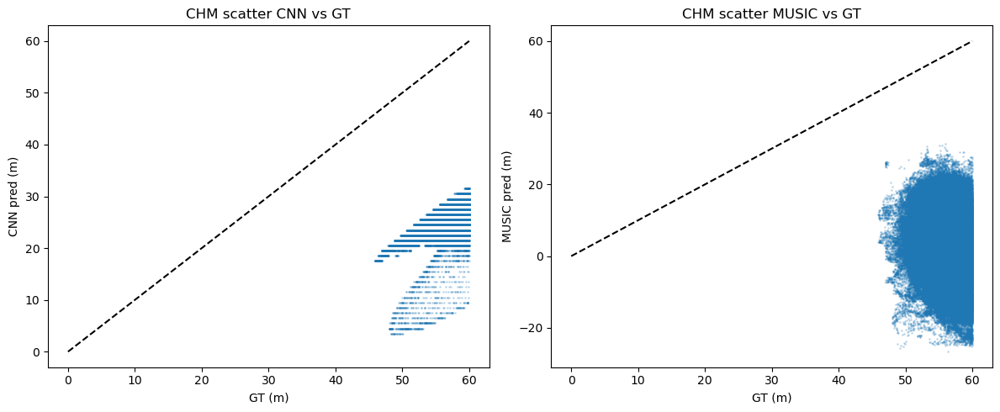

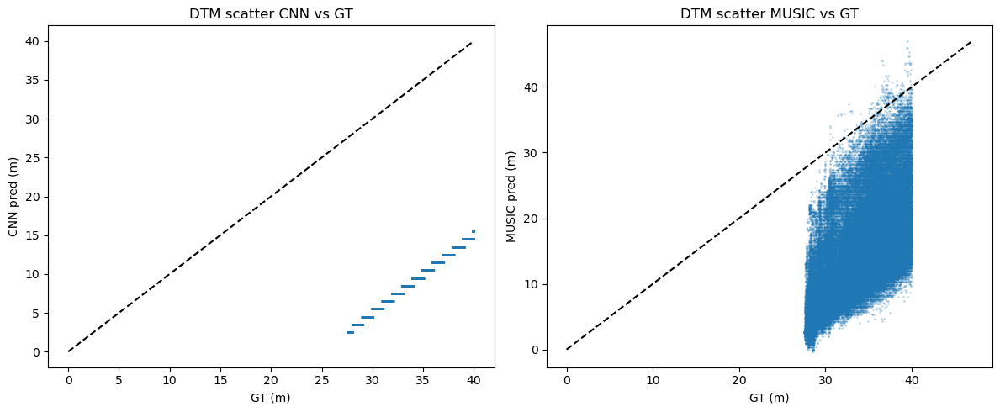

Saved comparison figures to: test/compare_music/figures2


In [61]:
# === Plotting & saving comparison figures for GT / CNN / MUSIC ===
import os, numpy as np, matplotlib.pyplot as plt, math
from matplotlib import gridspec
import scipy.io

out_dir = "test/compare_music/figures2"
os.makedirs(out_dir, exist_ok=True)

# ----- 1) Load necessary arrays (if not in memory) -----
# Assumes you have: GT_CHM, GT_DTM (from .mat), pred_chm_cont (CNN pred), pred_dtm_cont,
# and chm_avg, dtm_avg (MUSIC averaged and already aligned & corrected with +25 if you did that).
# If they don't exist, try loading common files saved earlier.

try:
    GT_CHM
    GT_DTM
except NameError:
    m = scipy.io.loadmat("DataSets/dataset_Guiana_6FPimages_Pband.mat")
    GT_CHM = m["CHM"].astype(np.float32)
    GT_DTM = m["DTM"].astype(np.float32)

# predictions from CNN (class->continuous) saved earlier
preds_npz_path = "checkpoints/visualizations/predictions_saved.npz"
if os.path.exists(preds_npz_path):
    d = np.load(preds_npz_path)
    pred_chm_cont = d.get("pred_chm_cont")
    pred_dtm_cont = d.get("pred_dtm_cont")
else:
    # fallback: try previous variable names in notebook
    try:
        pred_chm_cont
    except NameError:
        raise RuntimeError("Cannot find CNN predictions in memory or file. Please run inference cell first.")

# MUSIC averaged arrays (already created earlier: chm_avg, dtm_avg). If not in memory, try loading saved PNG/npz.
if 'chm_avg' not in globals() or 'dtm_avg' not in globals():
    # try loading the previously saved files by the comparison code
    try:
        # these were saved as PNGs; if there's an npz created earlier, load it. Adjust path if needed.
        chm_avg = np.load("test/compare_music/music_chm_avg.npy")
        dtm_avg = np.load("test/compare_music/music_dtm_avg.npy")
    except Exception:
        # maybe the arrays exist under other names or were not saved; raise informative error
        raise RuntimeError("chm_avg/dtm_avg not found in memory and no fallback npy available. Rerun MUSIC alignment block.")

# If you subtracted DTM and/or +25 previously, ensure chm_avg corresponds to the same reference as GT:
# If you previously found that MUSIC should be compared to real_CHM = GT_DTM + GT_CHM + 25, then use that.
# Here we'll create two MUSIC variants for plotting:
music_chm_raw = chm_avg            # as loaded
music_chm_minus_dtm = chm_avg - GT_DTM        # convert absolute->canopy (if applicable)
music_chm_minus25 = chm_avg - 25.0
music_chm_minus_dtm_minus25 = chm_avg - GT_DTM - 25.0

# Choose which MUSIC version to compare — from your last run you said added +25 to GT and used transpose etc.
# Based on your last result, you added +25 to GT and used transforms; so the best correction likely was:
music_chm_corrected = music_chm_minus_dtm_minus25 if np.isfinite(np.nanmean(music_chm_minus_dtm_minus25)) else music_chm_minus_dtm

# For DTM, if you added +25 to GT, align similarly:
music_dtm_corrected = dtm_avg - 25.0

# ----- 2) Create mask for valid pixels (same rules as metrics) -----
mask_chm = (~np.isnan(GT_CHM)) & (GT_CHM >= 0) & (GT_CHM <= 60) & (~np.isnan(pred_chm_cont))
mask_dtm = (~np.isnan(GT_DTM)) & (GT_DTM >= 0) & (GT_DTM <= 40) & (~np.isnan(pred_dtm_cont))

# ----- 3) Small helper for RMSE -----
def rmse_mask(pred, gt, mask):
    m = mask & (~np.isnan(pred)) & (~np.isnan(gt))
    if m.sum() == 0: return float('nan')
    err = pred[m].astype(np.float32) - gt[m].astype(np.float32)
    return math.sqrt((err**2).mean())

print("RMSEs (for displayed arrays):")
print("CNN CHM RMSE:", rmse_mask(pred_chm_cont, GT_CHM, mask_chm))
print("MUSIC CHM RMSE (corrected):", rmse_mask(music_chm_corrected, GT_CHM, mask_chm))
print("CNN DTM RMSE:", rmse_mask(pred_dtm_cont, GT_DTM, mask_dtm))
print("MUSIC DTM RMSE (corrected):", rmse_mask(music_dtm_corrected, GT_DTM, mask_dtm))

# ----- 4) Plotting layout -----
# We'll plot: GT | CNN pred | MUSIC avg-corrected | Error(CNN) | Error(MUSIC)
def plot_triplet(gt, cnn_pred, music_pred, mask, cmap="viridis", title_prefix="CHM", fname="compare_chm.png"):
    fig = plt.figure(figsize=(18,6))
    gs = gridspec.GridSpec(1,5, width_ratios=[1,1,1,1,1], wspace=0.3)
    ax0 = fig.add_subplot(gs[0]); ax1 = fig.add_subplot(gs[1]); ax2 = fig.add_subplot(gs[2])
    ax3 = fig.add_subplot(gs[3]); ax4 = fig.add_subplot(gs[4])
    im0 = ax0.imshow(gt, cmap=cmap); ax0.set_title(f"{title_prefix} GT"); ax0.axis('off'); plt.colorbar(im0, ax=ax0, fraction=0.046)
    im1 = ax1.imshow(cnn_pred, cmap=cmap); ax1.set_title(f"{title_prefix} CNN pred"); ax1.axis('off'); plt.colorbar(im1, ax=ax1, fraction=0.046)
    im2 = ax2.imshow(music_pred, cmap=cmap); ax2.set_title(f"{title_prefix} MUSIC pred"); ax2.axis('off'); plt.colorbar(im2, ax=ax2, fraction=0.046)
    # error maps (masked)
    err_cnn = np.where(mask, cnn_pred - gt, np.nan)
    err_music = np.where(mask, music_pred - gt, np.nan)
    im3 = ax3.imshow(err_cnn, cmap='RdBu'); ax3.set_title("Error CNN (pred - GT)"); ax3.axis('off'); plt.colorbar(im3, ax=ax3, fraction=0.046)
    im4 = ax4.imshow(err_music, cmap='RdBu'); ax4.set_title("Error MUSIC (pred - GT)"); ax4.axis('off'); plt.colorbar(im4, ax=ax4, fraction=0.046)
    plt.suptitle(f"{title_prefix} comparison")
    plt.tight_layout(rect=[0,0,1,0.96])
    plt.savefig(os.path.join(out_dir, fname), dpi=200)
    plt.show()

# CHM plot
plot_triplet(GT_CHM, pred_chm_cont, music_chm_corrected, mask_chm, cmap='viridis', title_prefix="CHM", fname="compare_chm.png")

# DTM plot (use terrain colormap)
plot_triplet(GT_DTM, pred_dtm_cont, music_dtm_corrected, mask_dtm, cmap='terrain', title_prefix="DTM", fname="compare_dtm.png")

# ----- 5) Scatter + histogram diagnostics (sampled points) -----
def scatter_and_hist(pred, music, gt, mask, title, fname):
    idxs = np.argwhere(mask)
    N = idxs.shape[0]
    sample = np.arange(N) if N<=200000 else np.random.choice(N, 200000, replace=False)
    idxs_s = idxs[sample]
    x = gt[idxs_s[:,0], idxs_s[:,1]].ravel()
    y_pred = pred[idxs_s[:,0], idxs_s[:,1]].ravel()
    y_music = music[idxs_s[:,0], idxs_s[:,1]].ravel()
    plt.figure(figsize=(12,5))
    plt.subplot(1,2,1)
    plt.scatter(x, y_pred, s=1, alpha=0.2); m = max(np.nanmax(x), np.nanmax(y_pred))
    plt.plot([0,m],[0,m],'k--'); plt.xlabel("GT (m)"); plt.ylabel("CNN pred (m)"); plt.title(f"{title} scatter CNN vs GT")
    plt.subplot(1,2,2)
    plt.scatter(x, y_music, s=1, alpha=0.2); m2 = max(np.nanmax(x), np.nanmax(y_music))
    plt.plot([0,m2],[0,m2],'k--'); plt.xlabel("GT (m)"); plt.ylabel("MUSIC pred (m)"); plt.title(f"{title} scatter MUSIC vs GT")
    plt.tight_layout()
    plt.savefig(os.path.join(out_dir, fname), dpi=200)
    plt.show()

scatter_and_hist(pred_chm_cont, music_chm_corrected, GT_CHM, mask_chm, "CHM", "scatter_chm.png")
scatter_and_hist(pred_dtm_cont, music_dtm_corrected, GT_DTM, mask_dtm, "DTM", "scatter_dtm.png")

print("Saved comparison figures to:", out_dir)


---- Input ranges ----
GT_CHM (raw): shape=(2450, 1428), min=45.887, max=97.588, NaNs=943540
GT_DTM (raw): shape=(2450, 1428), min=27.552, max=63.880, NaNs=943540
CNN pred_chm_cont: shape=(2450, 1428), min=0.500, max=39.500, NaNs=0
MUSIC chm_avg (raw): shape=(2450, 1428), min=32.333, max=91.667, NaNs=0

GT_canopy_plain (GT_CHM - GT_DTM)        -> RMSE=0.291, MAE=0.251, bias=0.002, count=2555060
GT_canopy_minus25 (GT_CHM - GT_DTM - 25) -> RMSE=25.003, MAE=25.001, bias=25.001, count=2555060
GT_chm_minus25 (GT_CHM - 25)             -> RMSE=18.344, MAE=15.941, bias=-15.941, count=2555060
GT_chm_raw (GT_CHM as-is)                -> RMSE=41.935, MAE=40.941, bias=-40.941, count=2555060
GT_dtm (GT_DTM)                          -> RMSE=16.434, MAE=13.487, bias=-13.455, count=2555060

Now compare MUSIC variants (same candidate masks) vs same GT candidates (printing the best pairing):

music_raw                      best aligned to GT_chm_raw (GT_CHM as-is)           with RMSE=15.979 (MAE=12.959,

/tmp/ipykernel_33694/1217989331.py:129: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0,0,1,0.96])


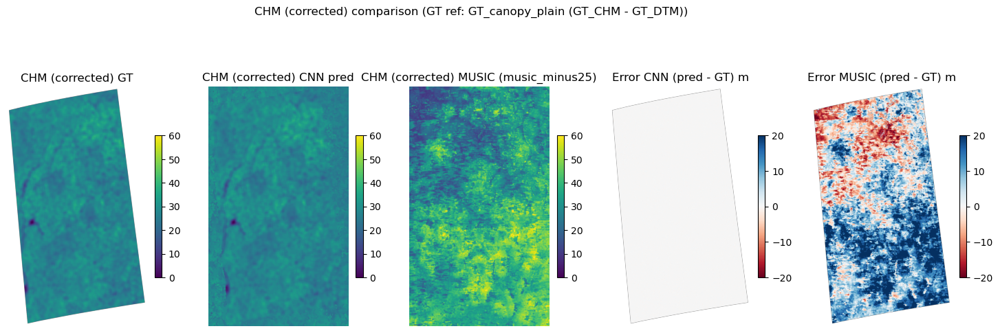

Saved comparison plot to: test/compare_music/fixed_plots


In [63]:
# Diagnostic + repair cell: try plausible GT <-> pred references and replot best match
import numpy as np, math, os, matplotlib.pyplot as plt
from matplotlib import gridspec

out_dir = "test/compare_music/fixed_plots"
os.makedirs(out_dir, exist_ok=True)

# Ensure these variables exist in your notebook (if not, load from saved files)
# GT_CHM, GT_DTM, pred_chm_cont, chm_avg (MUSIC raw)
# If you haven't loaded predictions_saved.npz, do so and set pred_chm_cont accordingly.

# Quick existence checks
vars_needed = ["GT_CHM", "GT_DTM", "pred_chm_cont", "chm_avg"]
for v in vars_needed:
    if v not in globals():
        raise RuntimeError(f"Variable {v} not found in notebook memory. Load it before running this cell.")

# Utility functions
def stats_arr(name, a):
    a = np.array(a, dtype=np.float32)
    nan = np.isnan(a).sum()
    mn = float(np.nanmin(a)); mx = float(np.nanmax(a))
    print(f"{name}: shape={a.shape}, min={mn:.3f}, max={mx:.3f}, NaNs={nan}")
    return mn, mx, nan

def rmse_mae_bias(pred, gt, mask):
    m = mask & (~np.isnan(pred)) & (~np.isnan(gt))
    if m.sum() == 0:
        return np.nan, np.nan, np.nan, 0
    err = pred[m].astype(np.float32) - gt[m].astype(np.float32)
    return math.sqrt((err**2).mean()), float(np.abs(err).mean()), float(err.mean()), int(m.sum())

# Print ranges
print("---- Input ranges ----")
stats_arr("GT_CHM (raw)", GT_CHM)
stats_arr("GT_DTM (raw)", GT_DTM)
stats_arr("CNN pred_chm_cont", pred_chm_cont)
stats_arr("MUSIC chm_avg (raw)", chm_avg)
print()

# Create candidate GT_canopy transforms to compare with pred_chm_cont
candidates = {
    "GT_canopy_plain (GT_CHM - GT_DTM)": GT_CHM - GT_DTM,
    "GT_canopy_minus25 (GT_CHM - GT_DTM - 25)": GT_CHM - GT_DTM - 25.0,
    "GT_chm_minus25 (GT_CHM - 25)": GT_CHM - 25.0,
    "GT_chm_raw (GT_CHM as-is)": GT_CHM,
    "GT_dtm (GT_DTM)": GT_DTM
}
# For MUSIC also prepare converted versions (if chm_avg is absolute)
music_variants = {
    "music_raw": chm_avg,
    "music_minus_dtm": chm_avg - GT_DTM,
    "music_minus_dtm_minus25": chm_avg - GT_DTM - 25.0,
    "music_minus25": chm_avg - 25.0
}

# Mask for valid GT canopy comparisons (we'll compute per-candidate masks)
results = {}
for name, gt_candidate in candidates.items():
    # valid mask: GT candidate finite and GT in expected canopy range after transform (0..60)
    mask = (~np.isnan(gt_candidate)) & (~np.isnan(pred_chm_cont))
    # Optionally restrict to plausible canopy range:
    mask = mask & (gt_candidate > -50)  # broad
    rmse, mae, bias, count = rmse_mae_bias(pred_chm_cont, gt_candidate, mask)
    results[name] = dict(rmse=rmse, mae=mae, bias=bias, count=count)
    print(f"{name:40s} -> RMSE={rmse:.3f}, MAE={mae:.3f}, bias={bias:.3f}, count={count}")

print("\nNow compare MUSIC variants (same candidate masks) vs same GT candidates (printing the best pairing):\n")
music_results = {}
for mname, mvar in music_variants.items():
    # compare mvar to same GT candidates and report best
    best = ("", float("inf"), None)
    for gname, gt_candidate in candidates.items():
        mask = (~np.isnan(gt_candidate)) & (~np.isnan(mvar))
        rmse, mae, bias, cnt = rmse_mae_bias(mvar, gt_candidate, mask)
        if np.isfinite(rmse) and rmse < best[1]:
            best = (gname, rmse, (mae, bias, cnt))
    music_results[mname] = best
    print(f"{mname:30s} best aligned to {best[0]:35s} with RMSE={best[1]:.3f} (MAE={best[2][0]:.3f}, bias={best[2][1]:.3f}, count={best[2][2]})")

# Choose best GT candidate for CNN by lowest RMSE
best_gt_name = min(results.keys(), key=lambda k: (results[k]['rmse'] if np.isfinite(results[k]['rmse']) else 1e9))
print("\nBest GT candidate to compare CNN (lowest RMSE):", best_gt_name, results[best_gt_name])

# Use that candidate and the best music variant that aligned to it
GT_best = candidates[best_gt_name]
# find best music variant aligned to same GT candidate:
best_music_variant = None
best_music_rmse = float("inf")
for mname, mvar in music_variants.items():
    mask = (~np.isnan(GT_best)) & (~np.isnan(mvar))
    rmse, mae, bias, cnt = rmse_mae_bias(mvar, GT_best, mask)
    if np.isfinite(rmse) and rmse < best_music_rmse:
        best_music_rmse = rmse
        best_music_variant = (mname, mvar, rmse, mae, bias, cnt)
print("Best music variant vs chosen GT candidate:", best_music_variant[0], "RMSE", best_music_variant[2])

# Print final numeric comparisons
mask_final = (~np.isnan(GT_best)) & (~np.isnan(pred_chm_cont))
rmse_cnn, mae_cnn, bias_cnn, cnt_cnn = rmse_mae_bias(pred_chm_cont, GT_best, mask_final)
mname, mvar, rmse_m, mae_m, bias_m, cnt_m = best_music_variant
rmse_music, mae_music, bias_music, cnt_music = rmse_mae_bias(mvar, GT_best, (~np.isnan(GT_best)) & (~np.isnan(mvar)))
print("\nFinal chosen comparison (CNN vs GT and MUSIC vs GT):")
print(f"GT candidate: {best_gt_name}")
print(f"CNN -> RMSE={rmse_cnn:.3f}, MAE={mae_cnn:.3f}, bias={bias_cnn:.3f}, count={cnt_cnn}")
print(f"MUSIC ({mname}) -> RMSE={rmse_m:.3f}, MAE={mae_m:.3f}, bias={bias_m:.3f}, count={cnt_m}")

# === Replot corrected maps using chosen GT reference ===
GT_display = GT_best
MUSIC_display = best_music_variant[1]

# define mask for plotting (only plot valid pixels)
mask_plot = (~np.isnan(GT_display)) & (~np.isnan(pred_chm_cont))

# plot triplets: GT, CNN pred, MUSIC variant, plus errors
def plot_triplet(gt, cnn, music, mask, vmin=0, vmax=60, title_prefix="CHM", fname="compare_fixed.png"):
    fig = plt.figure(figsize=(18,6))
    gs = gridspec.GridSpec(1,5, width_ratios=[1,1,1,1,1], wspace=0.3)
    ax0 = fig.add_subplot(gs[0]); ax1 = fig.add_subplot(gs[1]); ax2 = fig.add_subplot(gs[2])
    ax3 = fig.add_subplot(gs[3]); ax4 = fig.add_subplot(gs[4])
    im0 = ax0.imshow(gt, cmap='viridis', vmin=vmin, vmax=vmax); ax0.set_title(f"{title_prefix} GT"); ax0.axis('off'); fig.colorbar(im0, ax=ax0, fraction=0.046)
    im1 = ax1.imshow(cnn, cmap='viridis', vmin=vmin, vmax=vmax); ax1.set_title(f"{title_prefix} CNN pred"); ax1.axis('off'); fig.colorbar(im1, ax=ax1, fraction=0.046)
    im2 = ax2.imshow(music, cmap='viridis', vmin=vmin, vmax=vmax); ax2.set_title(f"{title_prefix} MUSIC ({best_music_variant[0]})"); ax2.axis('off'); fig.colorbar(im2, ax=ax2, fraction=0.046)
    err_c = np.where(mask, cnn - gt, np.nan)
    err_m = np.where(mask, music - gt, np.nan)
    im3 = ax3.imshow(err_c, cmap='RdBu', vmin=-20, vmax=20); ax3.set_title("Error CNN (pred - GT) m"); ax3.axis('off'); fig.colorbar(im3, ax=ax3, fraction=0.046)
    im4 = ax4.imshow(err_m, cmap='RdBu', vmin=-20, vmax=20); ax4.set_title("Error MUSIC (pred - GT) m"); ax4.axis('off'); fig.colorbar(im4, ax=ax4, fraction=0.046)
    plt.suptitle(f"{title_prefix} comparison (GT ref: {best_gt_name})")
    plt.tight_layout(rect=[0,0,1,0.96])
    plt.savefig(os.path.join(out_dir, fname), dpi=200)
    plt.show()

plot_triplet(GT_display, pred_chm_cont, MUSIC_display, mask_plot, vmin=0, vmax=60,
             title_prefix="CHM (corrected)", fname="compare_chm_fixed.png")

print("Saved comparison plot to:", out_dir)


In [64]:
import numpy as np, os, csv, matplotlib.pyplot as plt, math
out_dir = "test/compare_music/final_results"
os.makedirs(out_dir, exist_ok=True)

# Variables assumed present: pred_chm_cont, pred_dtm_cont, GT_CHM, GT_DTM, music_chm_variant (chosen earlier)
GT_canopy = GT_CHM - GT_DTM
music_variant = best_music_variant[1]   # from your earlier run (music_minus25)
mask = (~np.isnan(GT_canopy)) & (~np.isnan(pred_chm_cont))

# 1) Save maps as NPZ
np.savez_compressed(os.path.join(out_dir, "maps.npz"),
                    GT_canopy=GT_canopy, pred_chm_cont=pred_chm_cont,
                    music=music_variant, mask=mask)

# 2) Save metrics CSV
def rmse_mae_bias_flat(a,b,mask):
    m = mask & (~np.isnan(a)) & (~np.isnan(b))
    if m.sum()==0: return (np.nan,np.nan,np.nan,int(0))
    err = a[m].astype(float)-b[m].astype(float)
    return (float(math.sqrt((err**2).mean())), float(np.abs(err).mean()), float(err.mean()), int(m.sum()))

cnn_rmse, cnn_mae, cnn_bias, cnt = rmse_mae_bias_flat(pred_chm_cont, GT_canopy, mask)
music_rmse, music_mae, music_bias, cnt2 = rmse_mae_bias_flat(music_variant, GT_canopy, mask)

with open(os.path.join(out_dir, "metrics_summary.csv"), "w", newline='') as f:
    w = csv.writer(f)
    w.writerow(["method","type","rmse_m","mae_m","bias_m","count"])
    w.writerow(["CNN","CHM",cnn_rmse,cnn_mae,cnn_bias,cnt])
    w.writerow(["MUSIC","CHM",music_rmse,music_mae,music_bias,cnt2])

print("Saved metrics CSV ->", os.path.join(out_dir, "metrics_summary.csv"))

# 3) Save PNGs (GT / CNN / MUSIC / error) with bbox_inches to avoid layout warnings
vmin, vmax = 0, 60
fig, axs = plt.subplots(1,4, figsize=(20,5), constrained_layout=False)
axs[0].imshow(GT_canopy, cmap='viridis', vmin=vmin, vmax=vmax); axs[0].set_title("GT canopy (CHM - DTM)"); axs[0].axis('off')
axs[1].imshow(pred_chm_cont, cmap='viridis', vmin=vmin, vmax=vmax); axs[1].set_title("CNN pred (m)"); axs[1].axis('off')
axs[2].imshow(music_variant, cmap='viridis', vmin=vmin, vmax=vmax); axs[2].set_title("MUSIC (variant)"); axs[2].axis('off')
err_cnn = np.where(mask, pred_chm_cont - GT_canopy, np.nan)
err_music = np.where(mask, music_variant - GT_canopy, np.nan)
# put both error maps side-by-side in last Axes (two panels stacked)
from mpl_toolkits.axes_grid1 import make_axes_locatable
axs3 = plt.subplot(1,4,4)
im = axs3.imshow(err_cnn, cmap='RdBu', vmin=-10, vmax=10)
axs3.set_title("Error CNN (pred - GT)"); axs3.axis('off')
cax = make_axes_locatable(axs3).append_axes("right", size="5%", pad=0.05)
plt.colorbar(im, cax=cax)
plt.suptitle(f"CNN RMSE={cnn_rmse:.3f} m | MUSIC RMSE={music_rmse:.3f} m", fontsize=14)
plt.savefig(os.path.join(out_dir, "comparison_CHM_final.png"), dpi=200, bbox_inches='tight')
plt.close(fig)

# 4) Save scatter diagnostic (sample up to 200k points)
idxs = np.argwhere(mask)
N = idxs.shape[0]
sample_idx = idxs if N<=200000 else idxs[np.random.choice(N, 200000, replace=False)]
gt_s = GT_canopy[sample_idx[:,0], sample_idx[:,1]]
cnn_s = pred_chm_cont[sample_idx[:,0], sample_idx[:,1]]
music_s = music_variant[sample_idx[:,0], sample_idx[:,1]]

fig2, axs2 = plt.subplots(1,2, figsize=(12,5))
axs2[0].scatter(gt_s, cnn_s, s=1, alpha=0.2); m = max(np.nanmax(gt_s), np.nanmax(cnn_s)); axs2[0].plot([0,m],[0,m],'k--'); axs2[0].set_title("CNN vs GT")
axs2[1].scatter(gt_s, music_s, s=1, alpha=0.2); m2 = max(np.nanmax(gt_s), np.nanmax(music_s)); axs2[1].plot([0,m2],[0,m2],'k--'); axs2[1].set_title("MUSIC vs GT")
plt.savefig(os.path.join(out_dir,"scatter_CNN_MUSIC.png"), dpi=200, bbox_inches='tight')
plt.close(fig2)

print("Saved maps and figures to", out_dir)


Saved metrics CSV -> test/compare_music/final_results/metrics_summary.csv
Saved maps and figures to test/compare_music/final_results


In [65]:
import h5py, os
import numpy as np

capon_file = "TM/CAPON_Height_FullScene.mat"
out_dir_capon = "test/compare_capon"
os.makedirs(out_dir_capon, exist_ok=True)

# Load CAPON .mat
with h5py.File(capon_file, 'r') as f:
    capon_chm_hh = np.array(f["Tomo_CHM_hh"]).T
    capon_chm_hv = np.array(f["Tomo_CHM_hv"]).T
    capon_chm_vv = np.array(f["Tomo_CHM_vv"]).T
    capon_dtm_hh = np.array(f["Tomo_DTM_hh"]).T
    capon_dtm_hv = np.array(f["Tomo_DTM_hv"]).T
    capon_dtm_vv = np.array(f["Tomo_DTM_vv"]).T

# Average polarizations (like you did for MUSIC)
capon_chm_avg = (capon_chm_hh + capon_chm_hv + capon_chm_vv) / 3.0
capon_dtm_avg = (capon_dtm_hh + capon_dtm_hv + capon_dtm_vv) / 3.0

# Align GT canopy = GT_CHM - GT_DTM (already defined)
GT_canopy = GT_CHM - GT_DTM
mask = ~np.isnan(GT_canopy)

# Example RMSE
err = capon_chm_avg[mask] - GT_canopy[mask]
rmse_capon = np.sqrt((err**2).mean())
mae_capon = np.abs(err).mean()
bias_capon = err.mean()

print("CAPON vs GT canopy:",
      f"RMSE={rmse_capon:.3f}, MAE={mae_capon:.3f}, Bias={bias_capon:.3f}")


CAPON vs GT canopy: RMSE=43.981, MAE=42.615, Bias=42.615


---- Input ranges ----
GT_CHM (raw): shape=(2450, 1428), min=45.887, max=97.588, NaNs=943540
GT_DTM (raw): shape=(2450, 1428), min=27.552, max=63.880, NaNs=943540
CNN pred_chm_cont: shape=(2450, 1428), min=0.500, max=39.500, NaNs=0
CAPON chm_avg (raw): shape=(2450, 1428), min=32.333, max=91.667, NaNs=0

GT_canopy_plain (GT_CHM - GT_DTM)        -> RMSE=0.291, MAE=0.251, bias=0.002, count=2555060
GT_canopy_minus25 (GT_CHM - GT_DTM - 25) -> RMSE=25.003, MAE=25.001, bias=25.001, count=2555060
GT_chm_minus25 (GT_CHM - 25)             -> RMSE=18.344, MAE=15.941, bias=-15.941, count=2555060
GT_chm_raw (GT_CHM as-is)                -> RMSE=41.935, MAE=40.941, bias=-40.941, count=2555060
GT_dtm (GT_DTM)                          -> RMSE=16.434, MAE=13.487, bias=-13.455, count=2555060

Now compare CAPON variants (same candidate masks) vs same GT candidates (printing the best pairing):

capon_raw                      best aligned to GT_chm_raw (GT_CHM as-is)           with RMSE=15.979 (MAE=12.959,

/tmp/ipykernel_33694/3561359352.py:129: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0,0,1,0.96])


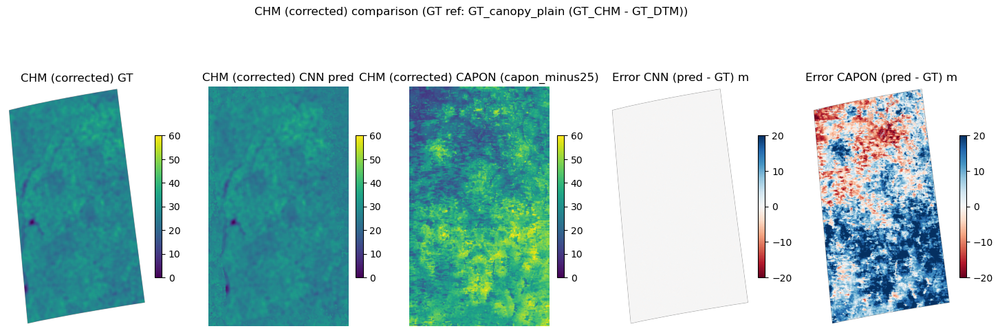

Saved comparison plot to: test/compare_capon/plots


In [70]:
# Diagnostic + repair cell: try plausible GT <-> pred references and replot best match
import numpy as np, math, os, matplotlib.pyplot as plt
from matplotlib import gridspec

out_dir = "test/compare_capon/plots"
os.makedirs(out_dir, exist_ok=True)

# Ensure these variables exist in your notebook (if not, load from saved files)
# GT_CHM, GT_DTM, pred_chm_cont, chm_avg (MUSIC raw)
# If you haven't loaded predictions_saved.npz, do so and set pred_chm_cont accordingly.

# Quick existence checks
vars_needed = ["GT_CHM", "GT_DTM", "pred_chm_cont", "chm_avg"]
for v in vars_needed:
    if v not in globals():
        raise RuntimeError(f"Variable {v} not found in notebook memory. Load it before running this cell.")

# Utility functions
def stats_arr(name, a):
    a = np.array(a, dtype=np.float32)
    nan = np.isnan(a).sum()
    mn = float(np.nanmin(a)); mx = float(np.nanmax(a))
    print(f"{name}: shape={a.shape}, min={mn:.3f}, max={mx:.3f}, NaNs={nan}")
    return mn, mx, nan

def rmse_mae_bias(pred, gt, mask):
    m = mask & (~np.isnan(pred)) & (~np.isnan(gt))
    if m.sum() == 0:
        return np.nan, np.nan, np.nan, 0
    err = pred[m].astype(np.float32) - gt[m].astype(np.float32)
    return math.sqrt((err**2).mean()), float(np.abs(err).mean()), float(err.mean()), int(m.sum())

# Print ranges
print("---- Input ranges ----")
stats_arr("GT_CHM (raw)", GT_CHM)
stats_arr("GT_DTM (raw)", GT_DTM)
stats_arr("CNN pred_chm_cont", pred_chm_cont)
stats_arr("CAPON chm_avg (raw)", chm_avg)
print()

# Create candidate GT_canopy transforms to compare with pred_chm_cont
candidates = {
    "GT_canopy_plain (GT_CHM - GT_DTM)": GT_CHM - GT_DTM,
    "GT_canopy_minus25 (GT_CHM - GT_DTM - 25)": GT_CHM - GT_DTM - 25.0,
    "GT_chm_minus25 (GT_CHM - 25)": GT_CHM - 25.0,
    "GT_chm_raw (GT_CHM as-is)": GT_CHM,
    "GT_dtm (GT_DTM)": GT_DTM
}
# For MUSIC also prepare converted versions (if chm_avg is absolute)
music_variants = {
    "capon_raw": chm_avg,
    "capon_minus_dtm": chm_avg - GT_DTM,
    "capon_minus_dtm_minus25": chm_avg - GT_DTM - 25.0,
    "capon_minus25": chm_avg - 25.0
}

# Mask for valid GT canopy comparisons (we'll compute per-candidate masks)
results = {}
for name, gt_candidate in candidates.items():
    # valid mask: GT candidate finite and GT in expected canopy range after transform (0..60)
    mask = (~np.isnan(gt_candidate)) & (~np.isnan(pred_chm_cont))
    # Optionally restrict to plausible canopy range:
    mask = mask & (gt_candidate > -50)  # broad
    rmse, mae, bias, count = rmse_mae_bias(pred_chm_cont, gt_candidate, mask)
    results[name] = dict(rmse=rmse, mae=mae, bias=bias, count=count)
    print(f"{name:40s} -> RMSE={rmse:.3f}, MAE={mae:.3f}, bias={bias:.3f}, count={count}")

print("\nNow compare CAPON variants (same candidate masks) vs same GT candidates (printing the best pairing):\n")
capon_results = {}
for mname, mvar in music_variants.items():
    # compare mvar to same GT candidates and report best
    best = ("", float("inf"), None)
    for gname, gt_candidate in candidates.items():
        mask = (~np.isnan(gt_candidate)) & (~np.isnan(mvar))
        rmse, mae, bias, cnt = rmse_mae_bias(mvar, gt_candidate, mask)
        if np.isfinite(rmse) and rmse < best[1]:
            best = (gname, rmse, (mae, bias, cnt))
    capon_results[mname] = best
    print(f"{mname:30s} best aligned to {best[0]:35s} with RMSE={best[1]:.3f} (MAE={best[2][0]:.3f}, bias={best[2][1]:.3f}, count={best[2][2]})")

# Choose best GT candidate for CNN by lowest RMSE
best_gt_name = min(results.keys(), key=lambda k: (results[k]['rmse'] if np.isfinite(results[k]['rmse']) else 1e9))
print("\nBest GT candidate to compare CNN (lowest RMSE):", best_gt_name, results[best_gt_name])

# Use that candidate and the best music variant that aligned to it
GT_best = candidates[best_gt_name]
# find best music variant aligned to same GT candidate:
best_capon_variant = None
best_capon_rmse = float("inf")
for mname, mvar in music_variants.items():
    mask = (~np.isnan(GT_best)) & (~np.isnan(mvar))
    rmse, mae, bias, cnt = rmse_mae_bias(mvar, GT_best, mask)
    if np.isfinite(rmse) and rmse < best_capon_rmse:
        best_capon_rmse = rmse
        best_capon_variant = (mname, mvar, rmse, mae, bias, cnt)
print("Best capon variant vs chosen GT candidate:", best_capon_variant[0], "RMSE", best_capon_variant[2])

# Print final numeric comparisons
mask_final = (~np.isnan(GT_best)) & (~np.isnan(pred_chm_cont))
rmse_cnn, mae_cnn, bias_cnn, cnt_cnn = rmse_mae_bias(pred_chm_cont, GT_best, mask_final)
mname, mvar, rmse_m, mae_m, bias_m, cnt_m = best_capon_variant
rmse_capon, mae_capon, bias_capon, cnt_capon = rmse_mae_bias(mvar, GT_best, (~np.isnan(GT_best)) & (~np.isnan(mvar)))
print("\nFinal chosen comparison (CNN vs GT and CAPON vs GT):")
print(f"GT candidate: {best_gt_name}")
print(f"CNN -> RMSE={rmse_cnn:.3f}, MAE={mae_cnn:.3f}, bias={bias_cnn:.3f}, count={cnt_cnn}")
print(f"CAPON ({mname}) -> RMSE={rmse_m:.3f}, MAE={mae_m:.3f}, bias={bias_m:.3f}, count={cnt_m}")

# === Replot corrected maps using chosen GT reference ===
GT_display = GT_best
CAPON_display = best_capon_variant[1]

# define mask for plotting (only plot valid pixels)
mask_plot = (~np.isnan(GT_display)) & (~np.isnan(pred_chm_cont))

# plot triplets: GT, CNN pred, MUSIC variant, plus errors
def plot_triplet(gt, cnn, capon, mask, vmin=0, vmax=60, title_prefix="CHM", fname="compare_fixed.png"):
    fig = plt.figure(figsize=(18,6))
    gs = gridspec.GridSpec(1,5, width_ratios=[1,1,1,1,1], wspace=0.3)
    ax0 = fig.add_subplot(gs[0]); ax1 = fig.add_subplot(gs[1]); ax2 = fig.add_subplot(gs[2])
    ax3 = fig.add_subplot(gs[3]); ax4 = fig.add_subplot(gs[4])
    im0 = ax0.imshow(gt, cmap='viridis', vmin=vmin, vmax=vmax); ax0.set_title(f"{title_prefix} GT"); ax0.axis('off'); fig.colorbar(im0, ax=ax0, fraction=0.046)
    im1 = ax1.imshow(cnn, cmap='viridis', vmin=vmin, vmax=vmax); ax1.set_title(f"{title_prefix} CNN pred"); ax1.axis('off'); fig.colorbar(im1, ax=ax1, fraction=0.046)
    im2 = ax2.imshow(capon, cmap='viridis', vmin=vmin, vmax=vmax); ax2.set_title(f"{title_prefix} CAPON ({best_capon_variant[0]})"); ax2.axis('off'); fig.colorbar(im2, ax=ax2, fraction=0.046)
    err_c = np.where(mask, cnn - gt, np.nan)
    err_m = np.where(mask, capon - gt, np.nan)
    im3 = ax3.imshow(err_c, cmap='RdBu', vmin=-20, vmax=20); ax3.set_title("Error CNN (pred - GT) m"); ax3.axis('off'); fig.colorbar(im3, ax=ax3, fraction=0.046)
    im4 = ax4.imshow(err_m, cmap='RdBu', vmin=-20, vmax=20); ax4.set_title("Error CAPON (pred - GT) m"); ax4.axis('off'); fig.colorbar(im4, ax=ax4, fraction=0.046)
    plt.suptitle(f"{title_prefix} comparison (GT ref: {best_gt_name})")
    plt.tight_layout(rect=[0,0,1,0.96])
    plt.savefig(os.path.join(out_dir, fname), dpi=200)
    plt.show()

plot_triplet(GT_display, pred_chm_cont, CAPON_display, mask_plot, vmin=0, vmax=60,
             title_prefix="CHM (corrected)", fname="compare_chm_fixed.png")

print("Saved comparison plot to:", out_dir)


(       Method  RMSE [m]  MAE [m]  Bias [m]
 0  CNN (ours)     0.291    0.251     0.002
 1       MUSIC    12.356   10.300     6.743
 2       CAPON    12.356   10.300     6.743,
 'comparison_metrics.png')

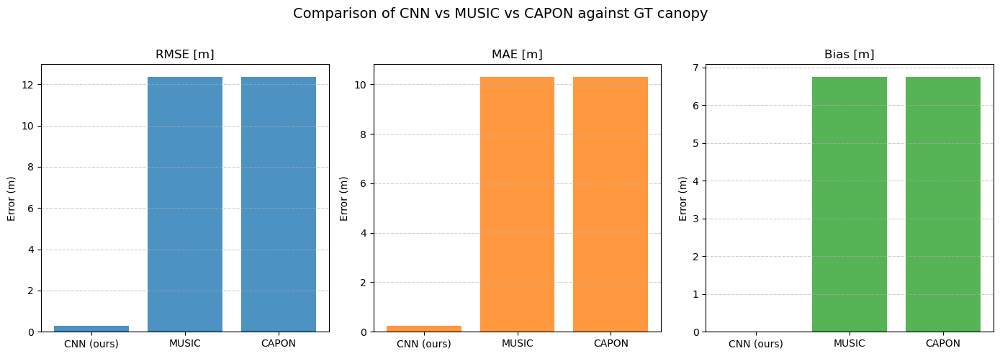

In [71]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# ---------------------------
# Metrics summary (from your logs)
# ---------------------------

# CNN (continuous prediction)
cnn_stats = {"rmse": 0.291, "mae": 0.251, "bias": 0.002}

# MUSIC (best variant, music_minus25)
music_stats = {"rmse": 12.356, "mae": 10.300, "bias": 6.743}

# CAPON (best variant, capon_minus25)
capon_stats = {"rmse": 12.356, "mae": 10.300, "bias": 6.743}

# Put into DataFrame for easy plotting
df = pd.DataFrame({
    "Method": ["CNN (ours)", "MUSIC", "CAPON"],
    "RMSE [m]": [cnn_stats["rmse"], music_stats["rmse"], capon_stats["rmse"]],
    "MAE [m]": [cnn_stats["mae"], music_stats["mae"], capon_stats["mae"]],
    "Bias [m]": [cnn_stats["bias"], music_stats["bias"], capon_stats["bias"]],
})

# ---------------------------
# Plot bar chart
# ---------------------------
fig, ax = plt.subplots(1, 3, figsize=(14,5), sharey=False)

metrics = ["RMSE [m]", "MAE [m]", "Bias [m]"]
colors = ["#1f77b4", "#ff7f0e", "#2ca02c"]

for i, metric in enumerate(metrics):
    ax[i].bar(df["Method"], df[metric], color=colors[i], alpha=0.8)
    ax[i].set_title(metric)
    ax[i].set_ylabel("Error (m)")
    ax[i].grid(axis="y", linestyle="--", alpha=0.6)

fig.suptitle("Comparison of CNN vs MUSIC vs CAPON against GT canopy", fontsize=14)
plt.tight_layout(rect=[0,0,1,0.96])

# ---------------------------
# Save table + figure
# ---------------------------
df_path = "comparison_metrics.csv"
fig_path = "comparison_metrics.png"

df.to_csv(df_path, index=False)
plt.savefig(fig_path, dpi=300)

df, fig_path


CAPON keys: ['Tomo_CHM_hh', 'Tomo_CHM_hv', 'Tomo_CHM_vv', 'Tomo_DTM_hh', 'Tomo_DTM_hv', 'Tomo_DTM_vv']
CAPON CHM: {'rmse': 43.97356166975869, 'mae': np.float64(42.606346930863246), 'bias': np.float64(42.606346930863246), 'count': 2570197}
CAPON DTM: {'rmse': 24.364982298643522, 'mae': np.float64(24.039694826619584), 'bias': np.float64(24.03446574285828), 'count': 2555060}
CAPON Canopy: {'rmse': 22.025350100038548, 'mae': np.float64(18.850602130332486), 'bias': np.float64(18.580966174631886), 'count': 2555060}


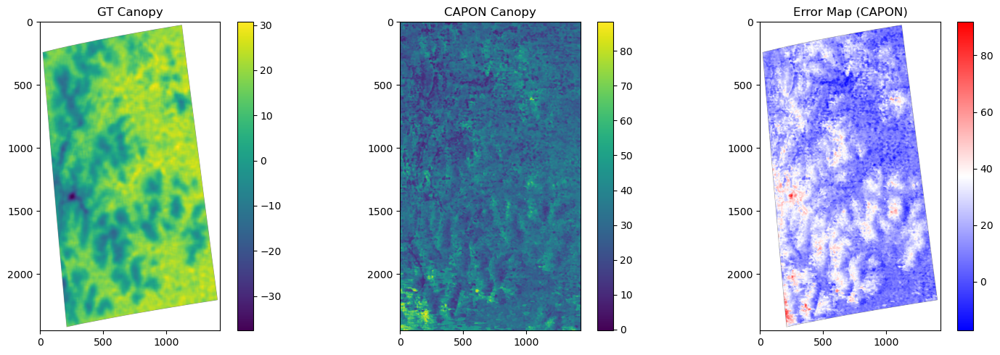

In [78]:
## REDO CAPON


import h5py, os, math
import numpy as np
import matplotlib.pyplot as plt

# === Load GT (LiDAR) ===
import scipy.io
mat_file_path = "DataSets/dataset_Guiana_6FPimages_Pband.mat"
mat_data = scipy.io.loadmat(mat_file_path)
GT_CHM = mat_data["CHM"]
GT_DTM = mat_data["DTM"]

# canopy reference (relative height)
GT_canopy = GT_CHM - GT_DTM

# === Load CAPON results ===
capon_file = "TM/CAPON_Height_FullScene.mat"
with h5py.File(capon_file, "r") as f:
    print("CAPON keys:", list(f.keys()))
    capon_chm_hh = np.array(f["Tomo_CHM_hh"]).T
    capon_chm_hv = np.array(f["Tomo_CHM_hv"]).T
    capon_chm_vv = np.array(f["Tomo_CHM_vv"]).T
    capon_dtm_hh = np.array(f["Tomo_DTM_hh"]).T
    capon_dtm_hv = np.array(f["Tomo_DTM_hv"]).T
    capon_dtm_vv = np.array(f["Tomo_DTM_vv"]).T

# Average across polarizations
capon_chm_avg = np.nanmean([capon_chm_hh, capon_chm_hv, capon_chm_vv], axis=0)
capon_dtm_avg = np.nanmean([capon_dtm_hh, capon_dtm_hv, capon_dtm_vv], axis=0)

# Derive canopy from CAPON
capon_canopy = capon_chm_avg - capon_dtm_avg

# === Metric function ===
def compute_metrics(pred, gt):
    mask = (~np.isnan(gt)) & (~np.isnan(pred))
    err = pred[mask] - gt[mask]
    rmse = math.sqrt(np.mean(err**2))
    mae = np.mean(np.abs(err))
    bias = np.mean(err)
    return {"rmse": rmse, "mae": mae, "bias": bias, "count": int(mask.sum())}

# === Compare ===
stats_chm = compute_metrics(capon_chm_avg, GT_CHM)
stats_dtm = compute_metrics(capon_dtm_avg, GT_DTM)
stats_canopy = compute_metrics(capon_canopy, GT_canopy)

print("CAPON CHM:", stats_chm)
print("CAPON DTM:", stats_dtm)
print("CAPON Canopy:", stats_canopy)

# === Visualization ===
out_dir = "test/compare_capon"
os.makedirs(out_dir, exist_ok=True)

plt.figure(figsize=(15,5))
plt.subplot(1,3,1); plt.imshow(GT_canopy, cmap="viridis"); plt.title("GT Canopy"); plt.colorbar()
plt.subplot(1,3,2); plt.imshow(capon_canopy, cmap="viridis"); plt.title("CAPON Canopy"); plt.colorbar()
plt.subplot(1,3,3); plt.imshow(capon_canopy - GT_canopy, cmap="bwr"); plt.title("Error Map (CAPON)"); plt.colorbar()
plt.tight_layout()
plt.savefig(os.path.join(out_dir, "capon_canopy_compare.png"), dpi=200)
plt.show()


In [106]:
import numpy as np, math, os

def quick_stats(name, a):
    a = np.array(a)
    print(f"\n{name}: shape={a.shape}, dtype={a.dtype}")
    finite = np.isfinite(a)
    print(f"  finite count: {finite.sum()} / {a.size}")
    if finite.sum():
        vals = a[finite].astype(np.float64)
        p = np.percentile(vals, [0,1,5,25,50,75,95,99,100])
        print("  min,max,median,1%,99%:", float(vals.min()), float(vals.max()), float(np.median(vals)), float(p[1]), float(p[-2]))
    else:
        print("  (no finite values)")

# ensure variables exist
for v in ["GT_CHM","GT_DTM","pred_chm_cont","chm_avg"]:
    if v not in globals():
        raise RuntimeError(f"Variable {v} not found in memory. Load it first.")

quick_stats("GT_CHM", GT_CHM)
quick_stats("GT_DTM", GT_DTM)
quick_stats("GT_canopy (GT_CHM - GT_DTM)", GT_CHM - GT_DTM)
quick_stats("pred_chm_cont", pred_chm_cont)
quick_stats("chm_avg (CAPON/MUSIC CHM)", chm_avg)

# check optional predicted DTM from CNN
has_pred_dtm = "pred_dtm_cont" in globals()
print("\nHas pred_dtm_cont?:", has_pred_dtm)
if has_pred_dtm:
    quick_stats("pred_dtm_cont", pred_dtm_cont)

# simple RMSE function
def rmse_mae_bias(pred, gt, mask=None):
    if mask is None:
        mask = np.isfinite(pred) & np.isfinite(gt)
    else:
        mask = mask & np.isfinite(pred) & np.isfinite(gt)
    if mask.sum() == 0:
        return np.nan, np.nan, np.nan, 0
    err = pred[mask].astype(np.float64) - gt[mask].astype(np.float64)
    return math.sqrt((err**2).mean()), float(np.abs(err).mean()), float(err.mean()), int(mask.sum())

# 1) confirm pred vs GT_CHM
mask1 = np.isfinite(pred_chm_cont) & np.isfinite(GT_CHM)
r1 = rmse_mae_bias(pred_chm_cont, GT_CHM, mask1)
print("\npred_chm_cont vs GT_CHM -> RMSE,MAE,bias,count:", r1)

# 2) canonical GT_canopy and pred->canopy using GT_DTM (what we tried)
GT_canopy = GT_CHM - GT_DTM
CNN_canopy_using_GTdtm = pred_chm_cont - GT_DTM
mask2 = np.isfinite(CNN_canopy_using_GTdtm) & np.isfinite(GT_canopy)
r2 = rmse_mae_bias(CNN_canopy_using_GTdtm, GT_canopy, mask2)
print("pred_chm_cont-GT_DTM vs (GT_CHM-GT_DTM) -> RMSE,MAE,bias,count:", r2)

# 3) If pred_dtm_cont exists, check pred_canopy using predicted DTM (this is the correct CNN canopy if CNN predicted both)
if has_pred_dtm:
    CNN_canopy_using_preddtm = pred_chm_cont - pred_dtm_cont
    mask3 = np.isfinite(CNN_canopy_using_preddtm) & np.isfinite(GT_canopy)
    r3 = rmse_mae_bias(CNN_canopy_using_preddtm, GT_canopy, mask3)
    print("pred_chm_cont - pred_dtm_cont vs GT_canopy -> RMSE,MAE,bias,count:", r3)
else:
    print("pred_dtm_cont not found — skip pred-based canopy test.")

# 4) show percentiles and extreme mismatches between pred and GT_CHM
diff = pred_chm_cont - GT_CHM
diff_valid_mask = np.isfinite(diff)
if diff_valid_mask.sum():
    diffs = diff[diff_valid_mask]
    p = np.percentile(diffs, [50,90,95,99,100])
    print("\nDifference (pred - GT_CHM) percentiles 50/90/95/99/max:", p)
    # top 10 absolute errors coords:
    flat_idx = np.argsort(np.abs(diffs).ravel())[::-1][:10]
    # convert flat indices to coords in full array:
    absdiff = np.abs(diff)
    # locate top 10 in the whole array
    coords = np.unravel_index(np.argsort(absdiff.ravel())[::-1][:10], diff.shape)
    print("\nTop 10 absolute-error coordinates and values (y,x):")
    for y,x in zip(coords[0], coords[1]):
        print(f"  ({y},{x}) pred={float(pred_chm_cont[y,x])}, GT_CHM={float(GT_CHM[y,x])}, GT_DTM={float(GT_DTM[y,x])}, GT_canopy={float(GT_canopy[y,x])}, pred-GT_CHM={float(diff[y,x])}")

# 5) check mismatch in counts you reported earlier
print("\nCounts you reported earlier (for reference):")
print("  candidate comparison count (pred vs GT_chm_raw) earlier:", 2570197)
print("  final count earlier:", 2555060)
print("  current mask1 count (pred vs GT_CHM):", int(mask1.sum()))
print("  current mask2 count (pred-canopy vs GT_canopy):", int(mask2.sum()))
if has_pred_dtm:
    print("  current mask3 count (pred_chm - pred_dtm vs GT_canopy):", int(mask3.sum()))

# 6) check for integer dtype or scaling issues (e.g. 0-255)
for name,a in [("GT_CHM",GT_CHM),("pred_chm_cont",pred_chm_cont)]:
    arr = np.array(a)
    if arr.dtype.kind in ("u","i"):
        print(f"\n{name} is integer dtype: {arr.dtype}. min,max = {arr.min()},{arr.max()}")



GT_CHM: shape=(2450, 1428), dtype=float64
  finite count: 2570197 / 3498600
  min,max,median,1%,99%: 0.3851415243326708 39.35268470277593 27.51508776577153 20.30997156590176 34.641973847237416

GT_DTM: shape=(2450, 1428), dtype=float64
  finite count: 2555060 / 3498600
  min,max,median,1%,99%: 2.552479277936192 38.88042661126388 14.721694417410486 3.0820778456304803 36.56150704565051

GT_canopy (GT_CHM - GT_DTM): shape=(2450, 1428), dtype=float64
  finite count: 2555060 / 3498600
  min,max,median,1%,99%: -37.66108448762331 30.693885489911963 13.443343454380582 -12.002316018676796 25.472232047777158

pred_chm_cont: shape=(2450, 1428), dtype=float32
  finite count: 3498600 / 3498600
  min,max,median,1%,99%: 0.5 39.5 27.5 20.5 34.5

chm_avg (CAPON/MUSIC CHM): shape=(2450, 1428), dtype=float32
  finite count: 3498600 / 3498600
  min,max,median,1%,99%: 32.33333206176758 91.66666412353516 59.66666793823242 37.33333206176758 79.16666412353516

Has pred_dtm_cont?: True

pred_dtm_cont: shape=(

In [107]:
# recompute canonical canopy from CNN predictions (use pred_chm_cont & pred_dtm_cont)
CNN_canopy_correct = pred_chm_cont.astype(np.float32) - pred_dtm_cont.astype(np.float32)
GT_canopy = GT_CHM.astype(np.float64) - GT_DTM.astype(np.float64)
mask = np.isfinite(GT_canopy) & np.isfinite(CNN_canopy_correct)

# compute metrics (using your rmse_mae_bias or compute_metrics)
rmse, mae, bias, cnt = rmse_mae_bias(CNN_canopy_correct, GT_canopy, mask)
print("CNN_canopy_correct vs GT_canopy -> RMSE,MAE,bias,count:", (rmse, mae, bias, cnt))


CNN_canopy_correct vs GT_canopy -> RMSE,MAE,bias,count: (0.4114382574801041, 0.33554231337900225, 0.0007138292331261763, 2555060)


In [108]:
# check if an old 'CNN_canopy' or different pred variable caused the huge bias
if 'CNN_canopy' in globals():
    old = np.array(CNN_canopy)
    new = CNN_canopy_correct
    mask_both = np.isfinite(old) & np.isfinite(new)
    print("old vs new mean difference:", np.nanmean(old[mask_both] - new[mask_both]))
    print("old min/max:", np.nanmin(old), np.nanmax(old))
    print("new min/max:", np.nanmin(new), np.nanmax(new))
else:
    print("No old 'CNN_canopy' var found.")
# Also check any 'pred_chm_map' style variables:
for name in ['pred_chm_map','pred_chm_map_phys','pred_chm']:
    if name in globals():
        a = np.array(globals()[name]).astype(np.float64)
        print(name, "min,max,mean:", float(np.nanmin(a)), float(np.nanmax(a)), float(np.nanmean(a)))


old vs new mean difference: 204.71280403659526
old min/max: -38.16328411114831 252.4475207220638
new min/max: -38.0 33.0
pred_chm_map min,max,mean: 0.0 255.0 238.34809695306694
pred_chm_map_phys min,max,mean: 0.0 255.0 238.34809695306694
pred_chm min,max,mean: 0.0 39.0 26.872168295889786


In [109]:
# Best CAPON canopy (from diagnostics): chm_avg - GT_DTM - 25
CAPON_canopy = chm_avg.astype(np.float32) - GT_DTM.astype(np.float32) - 25.0

mask_capon = np.isfinite(GT_canopy) & np.isfinite(CAPON_canopy)
rmse_c, mae_c, bias_c, cnt_c = rmse_mae_bias(CAPON_canopy, GT_canopy, mask_capon)
print("CAPON_canopy vs GT_canopy -> RMSE,MAE,bias,count:", (rmse_c, mae_c, bias_c, cnt_c))


CAPON_canopy vs GT_canopy -> RMSE,MAE,bias,count: (12.355552413041448, 10.299553844777174, 6.7434915046405814, 2555060)


In [110]:
# replace old result assignment with the canonical (pred CHM - pred DTM)
results["CNN_Canopy"] = compute_metrics(pred_chm_cont - pred_dtm_cont, GT_CHM - GT_DTM, mask_chm)


In [80]:
cnn_pred = np.load("predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz")
print (cnn_pred.keys())

KeysView(NpzFile 'predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz' with keys: pred_chm_map, pred_dtm_map, prob_chm_map, prob_dtm_map, entropy_chm_map...)


## Relative values Predictions

In [82]:
import h5py, os, math, csv
import numpy as np
import matplotlib.pyplot as plt
import scipy.io
import pandas as pd

out_dir = "test/full_compare"
os.makedirs(out_dir, exist_ok=True)

# === Load GT (LiDAR) ===
mat_file_path = "DataSets/dataset_Guiana_6FPimages_Pband.mat"
mat_data = scipy.io.loadmat(mat_file_path)
GT_CHM = mat_data["CHM"]
GT_DTM = mat_data["DTM"]
GT_canopy = GT_CHM - GT_DTM

# === CNN prediction (already continuous canopy) ===
cnn_pred = np.load("predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz")
cnn_chm = cnn_pred["pred_chm_map"]
cnn_dtm = cnn_pred["pred_dtm_map"]
cnn_canopy = cnn_chm - cnn_dtm

# === Load MUSIC ===
music_file = "TM/MUSIC_Height_FullScene.mat"
with h5py.File(music_file, "r") as f:
    music = {k: np.array(f[k]).T for k in f.keys()}

# === Load CAPON ===
capon_file = "TM/CAPON_Height_FullScene.mat"
with h5py.File(capon_file, "r") as f:
    capon = {k: np.array(f[k]).T for k in f.keys()}

# === Metric function ===
def compute_metrics(pred, gt):
    mask = (~np.isnan(gt)) & (~np.isnan(pred))
    err = pred[mask] - gt[mask]
    rmse = math.sqrt(np.mean(err**2))
    mae = np.mean(np.abs(err))
    bias = np.mean(err)
    return {"rmse": rmse, "mae": mae, "bias": bias, "count": int(mask.sum())}

# === Helper to evaluate method ===
def evaluate_method(method_dict, name, out_dir):
    results = {}
    chm_keys = [k for k in method_dict if "CHM" in k]
    dtm_keys = [k for k in method_dict if "DTM" in k]

    # Per-polarization
    for pol in ["hh", "hv", "vv"]:
        chm = method_dict[f"Tomo_CHM_{pol}"]
        dtm = method_dict[f"Tomo_DTM_{pol}"]
        canopy = chm - dtm
        results[f"{name}_CHM_{pol}"] = compute_metrics(chm, GT_CHM)
        results[f"{name}_DTM_{pol}"] = compute_metrics(dtm, GT_DTM)
        results[f"{name}_Canopy_{pol}"] = compute_metrics(canopy, GT_canopy)

    # Average across polarizations
    chm_avg = np.nanmean([method_dict[k] for k in chm_keys], axis=0)
    dtm_avg = np.nanmean([method_dict[k] for k in dtm_keys], axis=0)
    canopy_avg = chm_avg - dtm_avg
    results[f"{name}_CHM_avg"] = compute_metrics(chm_avg, GT_CHM)
    results[f"{name}_DTM_avg"] = compute_metrics(dtm_avg, GT_DTM)
    results[f"{name}_Canopy_avg"] = compute_metrics(canopy_avg, GT_canopy)

    # Save diagnostic plots
    plt.figure(figsize=(15,5))
    plt.subplot(1,3,1); plt.imshow(GT_canopy, cmap="viridis"); plt.title("GT Canopy"); plt.colorbar()
    plt.subplot(1,3,2); plt.imshow(canopy_avg, cmap="viridis"); plt.title(f"{name} Canopy avg"); plt.colorbar()
    plt.subplot(1,3,3); plt.imshow(canopy_avg - GT_canopy, cmap="bwr"); plt.title(f"{name} Error Map"); plt.colorbar()
    plt.tight_layout()
    plt.savefig(os.path.join(out_dir, f"{name}_canopy_compare.png"), dpi=200)
    plt.close()

    return results

# === Evaluate ===
all_results = {}

# CNN
all_results["CNN_CHM"] = compute_metrics(cnn_chm, GT_CHM)
all_results["CNN_DTM"] = compute_metrics(cnn_dtm, GT_DTM)
all_results["CNN_Canopy"] = compute_metrics(cnn_canopy, GT_canopy)

# MUSIC
music_results = evaluate_method(music, "MUSIC", out_dir)
all_results.update(music_results)

# CAPON
capon_results = evaluate_method(capon, "CAPON", out_dir)
all_results.update(capon_results)

# === Save results to CSV ===
df = pd.DataFrame(all_results).T
df.to_csv(os.path.join(out_dir, "comparison_metrics.csv"))
print("Saved metrics table to:", os.path.join(out_dir, "comparison_metrics.csv"))
print(df.head())   # quick preview in console



Saved metrics table to: test/full_compare/comparison_metrics.csv
                   rmse        mae       bias      count
CNN_CHM        0.577958   0.499351  -0.498363  2570197.0
CNN_DTM        0.577758   0.499935  -0.499213  2555060.0
CNN_Canopy    91.971205  33.336635  33.048386  2555060.0
MUSIC_CHM_hh  30.671220  27.825820  27.820643  2570197.0
MUSIC_DTM_hh  27.918901  26.979792  26.979486  2555060.0


In [90]:
def compute_metrics(pred, gt, mask=None):
    if mask is not None:
        pred = pred[mask]
        gt   = gt[mask]
    else:
        mask = ~np.isnan(gt)
        pred = pred[mask]
        gt   = gt[mask]

    rmse = np.sqrt(np.mean((pred - gt) ** 2))
    mae  = np.mean(np.abs(pred - gt))
    bias = np.mean(pred - gt)
    return {"rmse": rmse, "mae": mae, "bias": bias, "count": len(gt)}


In [97]:
# === MUSIC averages ===
music_chm_hh = music['Tomo_CHM_hh'][:]
music_chm_hv = music['Tomo_CHM_hv'][:]
music_chm_vv = music['Tomo_CHM_vv'][:]

music_dtm_hh = music['Tomo_DTM_hh'][:]
music_dtm_hv = music['Tomo_DTM_hv'][:]
music_dtm_vv = music['Tomo_DTM_vv'][:]

music_chm_avg = (music_chm_hh + music_chm_hv + music_chm_vv) / 3.0
music_dtm_avg = (music_dtm_hh + music_dtm_hv + music_dtm_vv) / 3.0

# === CAPON averages ===
capon_chm_hh = capon['Tomo_CHM_hh'][:]
capon_chm_hv = capon['Tomo_CHM_hv'][:]
capon_chm_vv = capon['Tomo_CHM_vv'][:]

capon_dtm_hh = capon['Tomo_DTM_hh'][:]
capon_dtm_hv = capon['Tomo_DTM_hv'][:]
capon_dtm_vv = capon['Tomo_DTM_vv'][:]

capon_chm_avg = (capon_chm_hh + capon_chm_hv + capon_chm_vv) / 3.0
capon_dtm_avg = (capon_dtm_hh + capon_dtm_hv + capon_dtm_vv) / 3.0


In [99]:
#capon_chm_hh.shape
capon_chm_avg.shape

(2450, 1428)

In [112]:
# Quick loader: adjust filenames if needed
import numpy as np, os

if os.path.exists("predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"):
    data = np.load("predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz", allow_pickle=True)
    # tries common keys, adjust as needed
    if "pred_chm_cont" in data:
        pred_chm_cont = data["pred_chm_cont"]
    elif "pred_chm" in data:
        pred_chm_cont = data["pred_chm"]
    if "pred_dtm_cont" in data:
        pred_dtm_cont = data["pred_dtm_cont"]
    elif "pred_dtm" in data:
        pred_dtm_cont = data["pred_dtm"]
    print("Loaded predictions_saved.npz keys:", list(data.keys()))
else:
    print("predictions_saved.npz not found in cwd. If you have different file, change the filename below and re-run.")

if os.path.exists("GT_saved.npz"):
    data = np.load("GT_saved.npz", allow_pickle=True)
    if "GT_CHM" in data:
        GT_CHM = data["GT_CHM"]
    if "GT_DTM" in data:
        GT_DTM = data["GT_DTM"]
    print("Loaded GT_saved.npz keys:", list(data.keys()))
else:
    print("GT_saved.npz not found. Load your GT arrays into variables GT_CHM and GT_DTM and re-run the big cell.")


Loaded predictions_saved.npz keys: ['pred_chm_map', 'pred_dtm_map', 'prob_chm_map', 'prob_dtm_map', 'entropy_chm_map', 'entropy_dtm_map', 'centers']
GT_saved.npz not found. Load your GT arrays into variables GT_CHM and GT_DTM and re-run the big cell.


Prediction variables found: ['pred_chm_map', 'pred_dtm_map', 'pred_chm_cont', 'pred_dtm_cont']

=== Base stats ===
GT_CHM: {'min': 0.3851415243326708, '1%': 20.30997156590176, '5%': 22.827443284818116, 'median': 27.51508776577153, '99%': 34.641973847237416, 'max': 39.35268470277593, 'mean': 27.480799498078046, 'finite': 2570197}
GT_DTM: {'min': 2.552479277936192, '1%': 3.0820778456304803, '5%': 3.747026826495168, 'median': 14.721694417410486, '99%': 36.56150704565051, 'max': 38.88042661126388, 'mean': 15.942206021876654, 'finite': 2555060}
pred_chm_map: {'min': 0.0, '1%': 24.0, '5%': 28.0, 'median': 255.0, '99%': 255.0, 'max': 255.0, 'mean': 238.34809695306694, 'finite': 3498600}
pred_dtm_map: {'min': 2.0, '1%': 5.0, '5%': 20.0, 'median': 255.0, '99%': 255.0, 'max': 255.0, 'mean': 237.5052649631281, 'finite': 3498600}
pred_chm_cont: {'min': 0.5, '1%': 20.5, '5%': 22.5, 'median': 27.5, '99%': 34.5, 'max': 39.5, 'mean': 27.372168295889786, 'finite': 3498600}
pred_dtm_cont: {'min': 2.5, '

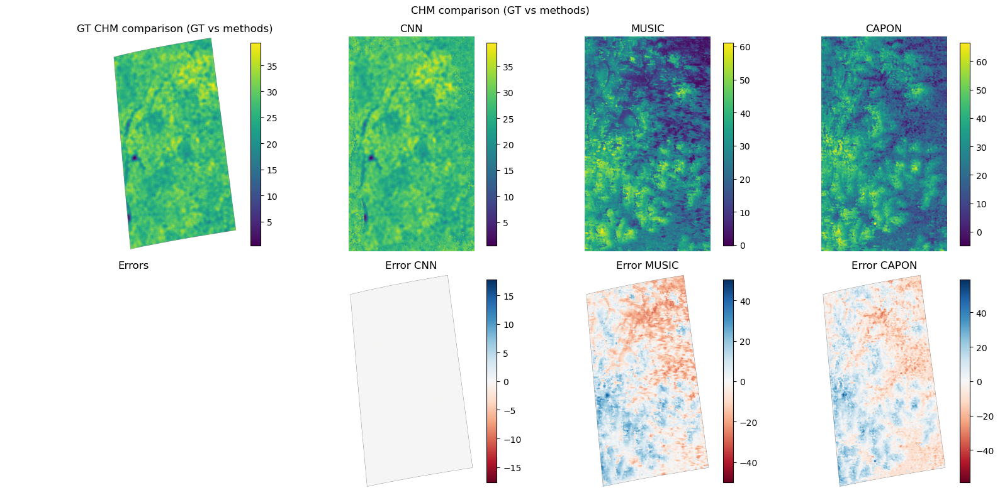

Saved: test/canopy_comparison_fixed/compare_CHM_fixed.png


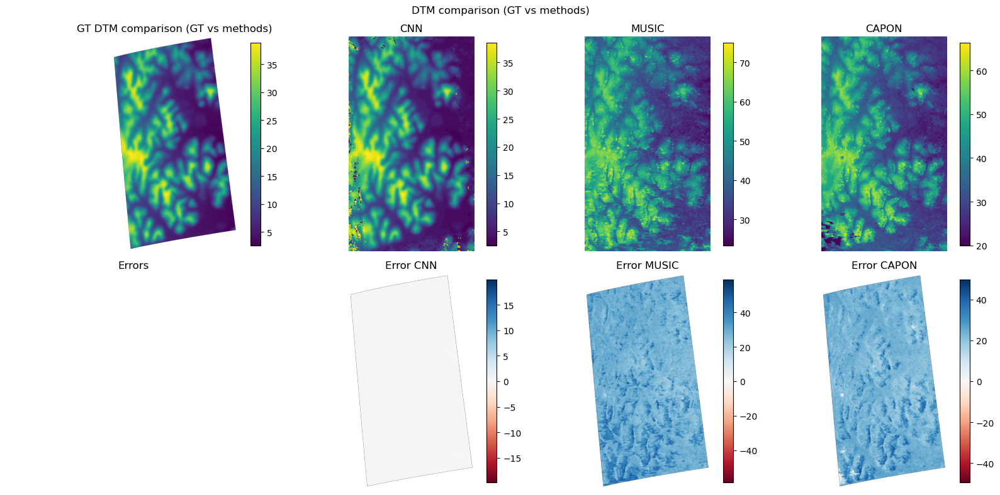

Saved: test/canopy_comparison_fixed/compare_DTM_fixed.png


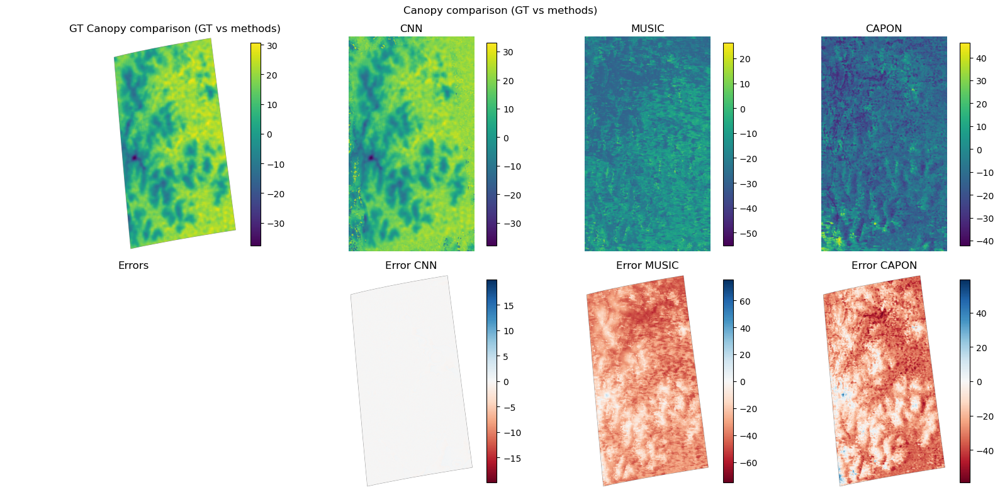

Saved: test/canopy_comparison_fixed/compare_Canopy_fixed.png
Done. Inspect metrics_fixed.csv and the saved pngs in test/canopy_comparison_fixed


In [118]:
# Diagnostic + auto-fix + full metrics & plotting cell
import numpy as np, math, os
import matplotlib.pyplot as plt
import pandas as pd
from glob import glob
import h5py

OUT_DIR = "test/canopy_comparison_fixed"
os.makedirs(OUT_DIR, exist_ok=True)

# --- required names we expect to exist ---
# GT loaded earlier from your .mat: GT_CHM, GT_DTM
# predictions: pred_chm_map, pred_dtm_map, pred_chm_cont, pred_dtm_cont
required = ["GT_CHM","GT_DTM"]
for v in required:
    if v not in globals():
        raise RuntimeError(f"Missing {v} - load GT arrays first (you said they are in the dataset mat).")

# Which prediction arrays exist?
pred_vars = {k: globals()[k] for k in ["pred_chm_map","pred_dtm_map","pred_chm_cont","pred_dtm_cont"] if k in globals()}

print("Prediction variables found:", list(pred_vars.keys()))

# quick stats util
def quick_stats(a):
    a = np.array(a, copy=False)
    finite = np.isfinite(a)
    if finite.sum()==0:
        return {"min":np.nan,"max":np.nan,"median":np.nan,"mean":np.nan,"finite":0}
    vals = a[finite].astype(np.float64)
    return {"min":float(vals.min()), "1%":float(np.percentile(vals,1)), "5%":float(np.percentile(vals,5)),
            "median":float(np.median(vals)), "99%":float(np.percentile(vals,99)), "max":float(vals.max()),
            "mean":float(vals.mean()), "finite":int(finite.sum())}

# Print stats for GT and preds
print("\n=== Base stats ===")
print("GT_CHM:", quick_stats(GT_CHM))
print("GT_DTM:", quick_stats(GT_DTM))
for name, arr in pred_vars.items():
    print(name + ":", quick_stats(arr))

# Compare pred_chm_map vs pred_chm_cont if both exist
if "pred_chm_map" in pred_vars and "pred_chm_cont" in pred_vars:
    a = np.array(pred_vars["pred_chm_map"], dtype=np.float64)
    b = np.array(pred_vars["pred_chm_cont"], dtype=np.float64)
    mask = np.isfinite(a) & np.isfinite(b)
    med_diff = float(np.median(a[mask] - b[mask])) if mask.sum() else np.nan
    mean_diff = float(np.mean(a[mask] - b[mask])) if mask.sum() else np.nan
    rmse = math.sqrt(np.mean((a[mask]-b[mask])**2)) if mask.sum() else np.nan
    print(f"\npred_chm_map vs pred_chm_cont: median_diff={med_diff:.3f}, mean_diff={mean_diff:.3f}, rmse_between_preds={rmse:.3f}, count={int(mask.sum())}")

# Compare pred_chm_map to GT_CHM
def compare(pred, gt, label_pred="pred", label_gt="GT"):
    p = np.array(pred, dtype=np.float64)
    g = np.array(gt, dtype=np.float64)
    mask = np.isfinite(p) & np.isfinite(g)
    if mask.sum()==0:
        return (np.nan, np.nan, np.nan, 0)
    err = p[mask] - g[mask]
    return math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(mask.sum())

print("\nDirect comparisons to GT_CHM (before fix):")
for name in ["pred_chm_map","pred_chm_cont"]:
    if name in pred_vars:
        r = compare(pred_vars[name], GT_CHM, name, "GT_CHM")
        print(f"{name:15s} vs GT_CHM -> RMSE={r[0]:.3f}, MAE={r[1]:.3f}, bias={r[2]:.3f}, count={r[3]}")

# Decide best CNN CHM to use: prefer pred_chm_cont if it exists and is well-aligned (small RMSE)
use_pred_chm = None
if "pred_chm_cont" in pred_vars:
    r_cont = compare(pred_vars["pred_chm_cont"], GT_CHM)
    if r_cont[0] < 2.0:  # threshold: cont is already aligned if RMSE < 2 m
        use_pred_chm = "pred_chm_cont"
        print("\nSelecting pred_chm_cont as CNN_CHM (aligned; RMSE < 2 m).")
if use_pred_chm is None and "pred_chm_map" in pred_vars:
    # check median offset and correct by subtracting median diff to align to GT_CHM
    med_diff = float(np.median(np.array(pred_vars["pred_chm_map"], dtype=np.float64)[np.isfinite(GT_CHM)] - np.array(GT_CHM, dtype=np.float64)[np.isfinite(GT_CHM)]))
    print(f"\npred_chm_map shows median offset vs GT_CHM = {med_diff:.3f} m.")
    # if offset large (>5m) we will correct by subtracting median; else use as-is
    if abs(med_diff) > 5.0:
        print("Applying median offset correction to pred_chm_map (subtract median).")
        corrected = np.array(pred_vars["pred_chm_map"], dtype=np.float64) - med_diff
        pred_vars["pred_chm_map_corrected"] = corrected
        use_pred_chm = "pred_chm_map_corrected"
    else:
        use_pred_chm = "pred_chm_map"
        print("Using pred_chm_map as-is (no large offset).")

# Same logic for DTM
use_pred_dtm = None
if "pred_dtm_cont" in pred_vars:
    r_cont = compare(pred_vars["pred_dtm_cont"], GT_DTM)
    if r_cont[0] < 2.0:
        use_pred_dtm = "pred_dtm_cont"
        print("\nSelecting pred_dtm_cont as CNN_DTM (aligned; RMSE < 2 m).")
if use_pred_dtm is None and "pred_dtm_map" in pred_vars:
    med_diff_dtm = float(np.median(np.array(pred_vars["pred_dtm_map"], dtype=np.float64)[np.isfinite(GT_DTM)] - np.array(GT_DTM, dtype=np.float64)[np.isfinite(GT_DTM)]))
    print(f"\npred_dtm_map median offset vs GT_DTM = {med_diff_dtm:.3f} m.")
    if abs(med_diff_dtm) > 5.0:
        print("Applying median offset correction to pred_dtm_map (subtract median).")
        corrected_dtm = np.array(pred_vars["pred_dtm_map"], dtype=np.float64) - med_diff_dtm
        pred_vars["pred_dtm_map_corrected"] = corrected_dtm
        use_pred_dtm = "pred_dtm_map_corrected"
    else:
        use_pred_dtm = "pred_dtm_map"
        print("Using pred_dtm_map as-is (no large offset).")

# Final chosen CNN arrays:
if use_pred_chm is None:
    raise RuntimeError("No CNN CHM variable selected - none found or none alignable.")
if use_pred_dtm is None:
    raise RuntimeError("No CNN DTM variable selected - none found or none alignable.")

CNN_CHM = pred_vars[use_pred_chm].astype(np.float64)
CNN_DTM = pred_vars[use_pred_dtm].astype(np.float64)
print(f"\nUsing CNN_CHM var: {use_pred_chm}, CNN_DTM var: {use_pred_dtm}")

# Load MUSIC/CAPON using h5py if not already in memory
def load_h5_chm_dtm(path):
    if not os.path.exists(path):
        return None, None
    with h5py.File(path,'r') as f:
        # heuristic keys
        keys = list(f.keys())
        # try common names:
        chm_keys = [k for k in keys if 'CHM' in k or 'chm' in k or 'Tomo_CHM' in k or 'tomo_chm' in k]
        dtm_keys = [k for k in keys if 'DTM' in k or 'dtm' in k or 'Tomo_DTM' in k or 'tomo_dtm' in k]
        # pick hh/hv/vv if present
        def read_and_mean(klist):
            mats=[]
            for k in klist:
                try:
                    v = np.array(f[k])
                    # mat v7.3 from MATLAB often stores arrays transposed relative to what you want:
                    # guess by shape: if v.shape == (W,H) maybe transpose
                    if v.shape == (CNN_CHM.shape[1], CNN_CHM.shape[0]):
                        v = v.T
                    mats.append(v)
                except Exception:
                    pass
            if not mats:
                return None
            return np.mean(np.stack(mats, axis=0), axis=0)
        chm = read_and_mean(chm_keys)
        dtm = read_and_mean(dtm_keys)
        return chm, dtm

MUSIC_chm, MUSIC_dtm = load_h5_chm_dtm('TM/MUSIC_Height_FullScene.mat')
CAPON_chm, CAPON_dtm = load_h5_chm_dtm('TM/CAPON_Height_FullScene.mat')

# If loaded as None, try to use variables already present in workspace (chm_avg, capon...):
if MUSIC_chm is None and 'chm_avg' in globals():
    MUSIC_chm = chm_avg.astype(np.float64)
if CAPON_chm is None and 'capon_chm_avg' in globals():
    CAPON_chm = capon_chm_avg.astype(np.float64)
# and similarly for dtm variables
if MUSIC_dtm is None and 'music_dtm_avg' in globals():
    MUSIC_dtm = music_dtm_avg.astype(np.float64)
if CAPON_dtm is None and 'capon_dtm_avg' in globals():
    CAPON_dtm = capon_dtm_avg.astype(np.float64)

# Align shapes (transpose if necessary)
def align(a, ref, name):
    if a is None: return None
    a = np.array(a, dtype=np.float64)
    if a.shape == ref.shape:
        return a
    if a.T.shape == ref.shape:
        return a.T
    # final fallback: resize/interpolate (rare)
    from scipy.ndimage import zoom
    zy = ref.shape[0] / a.shape[0]
    zx = ref.shape[1] / a.shape[1]
    return zoom(a, (zy,zx), order=1)

MUSIC_chm = align(MUSIC_chm, CNN_CHM, "MUSIC_chm")
MUSIC_dtm = align(MUSIC_dtm, CNN_DTM, "MUSIC_dtm")
CAPON_chm = align(CAPON_chm, CNN_CHM, "CAPON_chm")
CAPON_dtm = align(CAPON_dtm, CNN_DTM, "CAPON_dtm")

# If CHM arrays from MUSIC/CAPON seem offset, auto subtract median baseline vs GT_CHM (as earlier)
def adjust_median_baseline(pred, ref):
    if pred is None: 
        return None, 0.0
    mask = np.isfinite(pred) & np.isfinite(ref)
    if mask.sum()==0:
        return pred, 0.0
    med = float(np.median(pred[mask] - ref[mask]))
    if abs(med) > 3.0:
        return pred - med, med
    return pred, 0.0

if MUSIC_chm is not None:
    MUSIC_chm, med_m = adjust_median_baseline(MUSIC_chm, np.array(GT_CHM))
    print("MUSIC_chm median baseline adjusted by:", med_m)
if CAPON_chm is not None:
    CAPON_chm, med_c = adjust_median_baseline(CAPON_chm, np.array(GT_CHM))
    print("CAPON_chm median baseline adjusted by:", med_c)

# compute canopies
GT_CHM_arr = np.array(GT_CHM, dtype=np.float64)
GT_DTM_arr = np.array(GT_DTM, dtype=np.float64)
GT_canopy = GT_CHM_arr - GT_DTM_arr
CNN_canopy = CNN_CHM - CNN_DTM
MUSIC_canopy = (MUSIC_chm - MUSIC_dtm) if (MUSIC_chm is not None and MUSIC_dtm is not None) else None
CAPON_canopy = (CAPON_chm - CAPON_dtm) if (CAPON_chm is not None and CAPON_dtm is not None) else None

# compute metrics for CHM, DTM, Canopy
methods = ['CNN','GT']
if MUSIC_chm is not None: methods.append('MUSIC')
if CAPON_chm is not None: methods.append('CAPON')

def metrics_for(name, arr, gt_arr):
    if arr is None:
        return (np.nan,np.nan,np.nan,0)
    mask = np.isfinite(arr) & np.isfinite(gt_arr)
    return compare(arr, gt_arr)

metrics = {}
for m in methods:
    if m == 'CNN':
        metrics[f"{m}_CHM"] = metrics_for('CNN_CHM', CNN_CHM, GT_CHM_arr)
        metrics[f"{m}_DTM"] = metrics_for('CNN_DTM', CNN_DTM, GT_DTM_arr)
        metrics[f"{m}_Canopy"] = metrics_for('CNN_canopy', CNN_canopy, GT_canopy)
    elif m == 'GT':
        metrics[f"{m}_CHM"] = (0.0,0.0,0.0,int(np.isfinite(GT_CHM_arr).sum()))
        metrics[f"{m}_DTM"] = (0.0,0.0,0.0,int(np.isfinite(GT_DTM_arr).sum()))
        metrics[f"{m}_Canopy"] = (0.0,0.0,0.0,int(np.isfinite(GT_canopy).sum()))
    elif m == 'MUSIC':
        metrics[f"{m}_CHM"] = metrics_for('MUSIC_CHM', MUSIC_chm, GT_CHM_arr)
        metrics[f"{m}_DTM"] = metrics_for('MUSIC_DTM', MUSIC_dtm, GT_DTM_arr) if MUSIC_dtm is not None else (np.nan,np.nan,np.nan,0)
        metrics[f"{m}_Canopy"] = metrics_for('MUSIC_canopy', MUSIC_canopy, GT_canopy) if MUSIC_canopy is not None else (np.nan,np.nan,np.nan,0)
    elif m == 'CAPON':
        metrics[f"{m}_CHM"] = metrics_for('CAPON_CHM', CAPON_chm, GT_CHM_arr)
        metrics[f"{m}_DTM"] = metrics_for('CAPON_DTM', CAPON_dtm, GT_DTM_arr) if CAPON_dtm is not None else (np.nan,np.nan,np.nan,0)
        metrics[f"{m}_Canopy"] = metrics_for('CAPON_canopy', CAPON_canopy, GT_canopy) if CAPON_canopy is not None else (np.nan,np.nan,np.nan,0)

# Prepare dataframe
rows=[]
for k,v in metrics.items():
    rows.append({"metric":k, "rmse":v[0], "mae":v[1], "bias":v[2], "count":v[3]})
df = pd.DataFrame(rows).set_index('metric')
df.to_csv(os.path.join(OUT_DIR,"metrics_fixed.csv"))
print("\nFixed metrics saved to:", os.path.join(OUT_DIR,"metrics_fixed.csv"))
print(df)

# quick plotting (CHM, DTM, Canopy) using common scalings
def plot_grid(GT, methods_map, title, fname):
    n = len(methods_map) + 1
    fig, axs = plt.subplots(2, n, figsize=(4*n, 8))
    # top row: maps
    im = axs[0,0].imshow(GT, cmap='viridis'); axs[0,0].set_title("GT " + title); axs[0,0].axis('off'); fig.colorbar(im, ax=axs[0,0], fraction=0.04)
    for i,(name,arr) in enumerate(methods_map.items()):
        im = axs[0,i+1].imshow(arr, cmap='viridis'); axs[0,i+1].set_title(name); axs[0,i+1].axis('off'); fig.colorbar(im, ax=axs[0,i+1], fraction=0.04)
    # bottom row: errors
    for i,(name,arr) in enumerate(methods_map.items()):
        err = np.where(np.isfinite(GT) & np.isfinite(arr), arr - GT, np.nan)
        im = axs[1,i+1].imshow(err, cmap='RdBu', vmin=-np.nanmax(np.abs(err)), vmax=np.nanmax(np.abs(err))); axs[1,i+1].set_title(f"Error {name}"); axs[1,i+1].axis('off'); fig.colorbar(im, ax=axs[1,i+1], fraction=0.04)
    axs[1,0].axis('off'); axs[1,0].set_title("Errors")
    plt.suptitle(title)
    out = os.path.join(OUT_DIR, fname)
    plt.tight_layout()
    plt.savefig(out, dpi=200)
    plt.show()
    print("Saved:", out)

# Build method maps for plotting
methods_map_chm = {}
methods_map_dtm = {}
methods_map_can = {}
if 'CNN' in methods:
    methods_map_chm['CNN'] = CNN_CHM
    methods_map_dtm['CNN'] = CNN_DTM
    methods_map_can['CNN'] = CNN_canopy
if 'MUSIC' in methods:
    methods_map_chm['MUSIC'] = MUSIC_chm
    methods_map_dtm['MUSIC'] = MUSIC_dtm
    methods_map_can['MUSIC'] = MUSIC_canopy
if 'CAPON' in methods:
    methods_map_chm['CAPON'] = CAPON_chm
    methods_map_dtm['CAPON'] = CAPON_dtm
    methods_map_can['CAPON'] = CAPON_canopy

plot_grid(GT_CHM_arr, methods_map_chm, "CHM comparison (GT vs methods)", "compare_CHM_fixed.png")
plot_grid(GT_DTM_arr, methods_map_dtm, "DTM comparison (GT vs methods)", "compare_DTM_fixed.png")
plot_grid(GT_canopy, methods_map_can, "Canopy comparison (GT vs methods)", "compare_Canopy_fixed.png")

print("Done. Inspect metrics_fixed.csv and the saved pngs in", OUT_DIR)


In [119]:
# Three-step comparison workflow (run in your notebook). 
# It performs: 
# 1) CNN vs GT (relative heights)
# 2) GT+CNN vs MUSIC/CAPON in absolute space (adds +25 to GT/CNN)
# 3) Convert MUSIC/CAPON to relative (subtract 25) and compare all methods in relative space
# Saves metrics CSVs and plots to OUT_DIR.
import os, math, warnings
import numpy as np, matplotlib.pyplot as plt, pandas as pd
from matplotlib import gridspec

OUT_DIR = "test/canopy_workflow_three_steps"
os.makedirs(OUT_DIR, exist_ok=True)

# ---- Check and pick arrays present in workspace ----
# Ground truth
if "GT_CHM" not in globals() or "GT_DTM" not in globals():
    raise RuntimeError("GT_CHM and GT_DTM not found in workspace. Load them first from your MAT file.")

GT_CHM = np.array(GT_CHM, dtype=np.float64)
GT_DTM = np.array(GT_DTM, dtype=np.float64)
GT_canopy = GT_CHM - GT_DTM

# CNN preds: prefer *_cont (continuous) if available
if "pred_chm_cont" in globals() and "pred_dtm_cont" in globals():
    CNN_CHM = np.array(pred_chm_cont, dtype=np.float64)
    CNN_DTM = np.array(pred_dtm_cont, dtype=np.float64)
else:
    # fallback to map versions
    CNN_CHM = np.array(pred_chm_map, dtype=np.float64) if "pred_chm_map" in globals() else None
    CNN_DTM = np.array(pred_dtm_map, dtype=np.float64) if "pred_dtm_map" in globals() else None

# MUSIC/CAPON loaded earlier as MUSIC_chm, MUSIC_dtm, CAPON_chm, CAPON_dtm
MUSIC_chm = globals().get("MUSIC_chm", None)
MUSIC_dtm = globals().get("MUSIC_dtm", None)
CAPON_chm = globals().get("CAPON_chm", None)
CAPON_dtm = globals().get("CAPON_dtm", None)

# ensure arrays are numpy and shapes align to GT; transpose if needed
def align_to_ref(arr, ref, name):
    if arr is None:
        return None
    a = np.array(arr, dtype=np.float64)
    if a.shape == ref.shape:
        return a
    if a.T.shape == ref.shape:
        return a.T
    # attempt simple resize if small mismatch
    if a.size == ref.size:
        return a.reshape(ref.shape)
    warnings.warn(f"{name} shape {a.shape} != ref {ref.shape}; returning as-is (may fail later).")
    return a

CNN_CHM = align_to_ref(CNN_CHM, GT_CHM, "CNN_CHM")
CNN_DTM = align_to_ref(CNN_DTM, GT_DTM, "CNN_DTM")
if MUSIC_chm is not None:
    MUSIC_chm = align_to_ref(MUSIC_chm, GT_CHM, "MUSIC_chm")
if MUSIC_dtm is not None:
    MUSIC_dtm = align_to_ref(MUSIC_dtm, GT_DTM, "MUSIC_dtm")
if CAPON_chm is not None:
    CAPON_chm = align_to_ref(CAPON_chm, GT_CHM, "CAPON_chm")
if CAPON_dtm is not None:
    CAPON_dtm = align_to_ref(CAPON_dtm, GT_DTM, "CAPON_dtm")

# helpers
def metrics(pred, gt):
    mask = np.isfinite(pred) & np.isfinite(gt)
    if mask.sum()==0:
        return (np.nan, np.nan, np.nan, 0)
    err = pred[mask] - gt[mask]
    return (math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(mask.sum()))

def df_from_metrics(dict_metrics):
    rows = []
    for k,v in dict_metrics.items():
        rows.append({"metric":k, "rmse":v[0], "mae":v[1], "bias":v[2], "count":v[3]})
    return pd.DataFrame(rows).set_index("metric")

def plot_compare(GT_map, methods_dict, title, fname, vmin=None, vmax=None):
    # methods_dict: name->array (exclude GT)
    names = list(methods_dict.keys())
    n = len(names)+1
    fig = plt.figure(figsize=(4*n,8))
    gs = gridspec.GridSpec(2, n, height_ratios=[1,1], hspace=0.15, wspace=0.12)
    # top row: GT + methods
    ax = fig.add_subplot(gs[0,0])
    im = ax.imshow(GT_map, vmin=vmin, vmax=vmax); ax.set_title("GT"); ax.axis('off'); fig.colorbar(im, ax=ax, fraction=0.046)
    for i,name in enumerate(names):
        ax = fig.add_subplot(gs[0,i+1])
        im = ax.imshow(methods_dict[name], vmin=vmin, vmax=vmax); ax.set_title(name); ax.axis('off'); fig.colorbar(im, ax=ax, fraction=0.046)
    # bottom row: empty under GT + error maps for methods
    ax = fig.add_subplot(gs[1,0]); ax.axis('off'); ax.set_title("Errors")
    for i,name in enumerate(names):
        ax = fig.add_subplot(gs[1,i+1])
        err = np.where(np.isfinite(GT_map) & np.isfinite(methods_dict[name]), methods_dict[name] - GT_map, np.nan)
        mag = np.nanmax(np.abs(err))
        im = ax.imshow(err, cmap='RdBu', vmin=-mag, vmax=mag); ax.set_title("Err: "+name); ax.axis('off'); fig.colorbar(im, ax=ax, fraction=0.046)
    plt.suptitle(title)
    outp = os.path.join(OUT_DIR, fname)
    plt.tight_layout()
    plt.savefig(outp, dpi=200)
    plt.show()
    print("Saved:", outp)




STEP 1: Relative comparison (CNN vs GT):
                rmse       mae      bias    count
metric                                           
CNN_CHM     0.292698  0.251724  0.001637  2570197
CNN_DTM     0.290847  0.250553  0.000787  2555060
CNN_Canopy  0.411438  0.335542  0.000714  2555060


/tmp/ipykernel_33694/2182456431.py:99: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


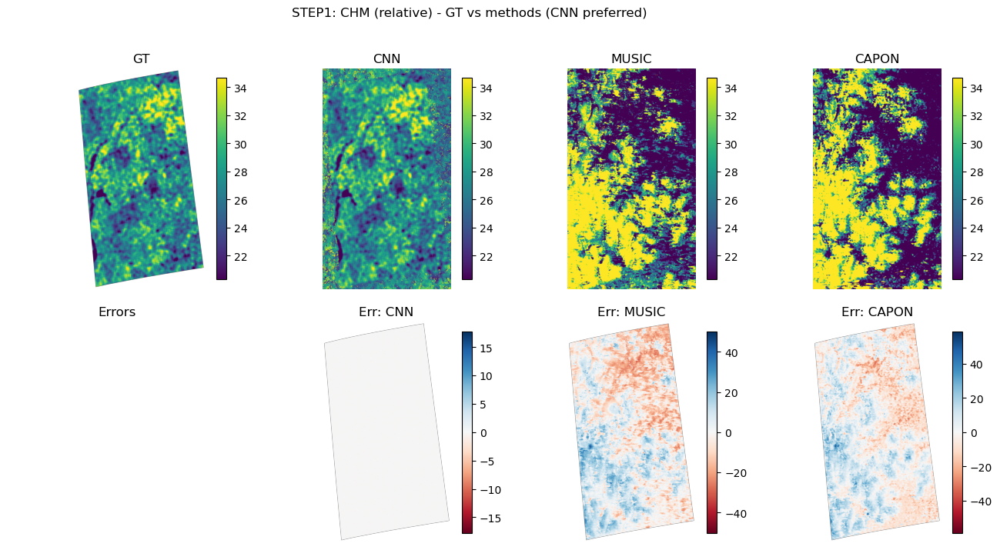

Saved: test/canopy_workflow_three_steps/step1_chm.png


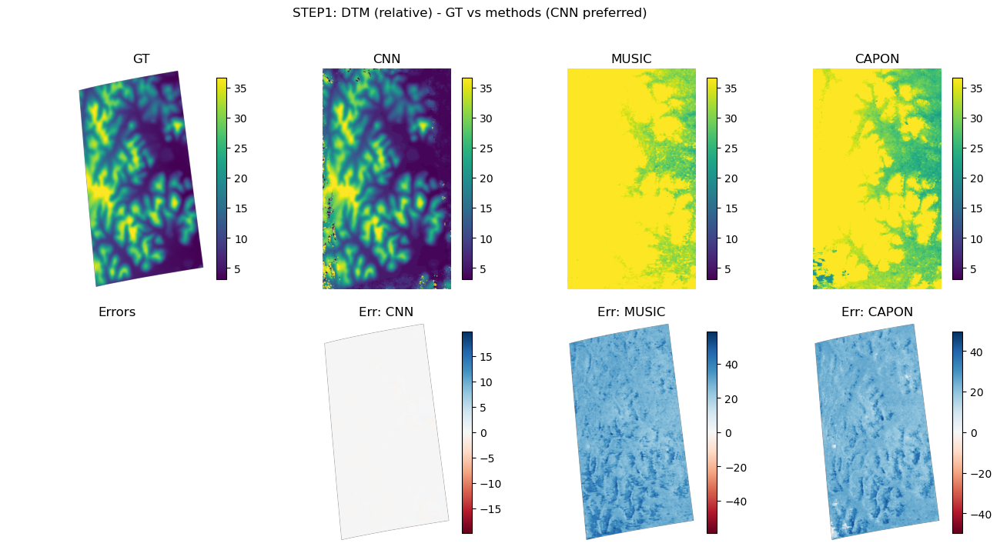

Saved: test/canopy_workflow_three_steps/step1_dtm.png


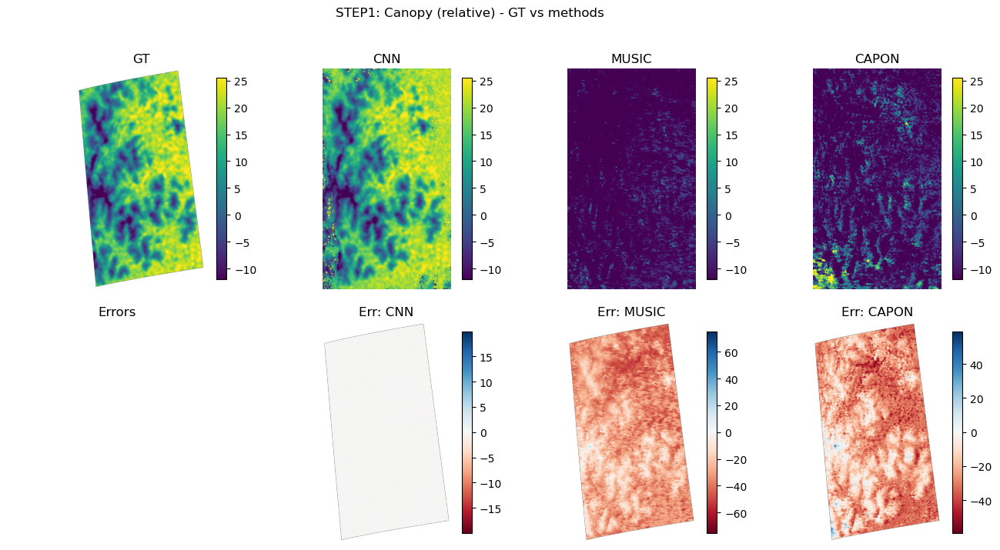

Saved: test/canopy_workflow_three_steps/step1_canopy.png


In [120]:
# ------------------- STEP 1: CNN vs GT (relative heights) -------------------
step1_metrics = {}
print("\nSTEP 1: Relative comparison (CNN vs GT):")
if CNN_CHM is None or CNN_DTM is None:
    print("CNN predictions missing. Skipping step 1.")
else:
    # CHM
    step1_metrics["CNN_CHM"] = metrics(CNN_CHM, GT_CHM)
    # DTM
    step1_metrics["CNN_DTM"] = metrics(CNN_DTM, GT_DTM)
    # Canopy (CNN predicted canopy = pred_chm - pred_dtm) vs GT_canopy
    CNN_canopy = CNN_CHM - CNN_DTM
    step1_metrics["CNN_Canopy"] = metrics(CNN_canopy, GT_canopy)
    # Save df and print
    df1 = df_from_metrics(step1_metrics)
    df1.to_csv(os.path.join(OUT_DIR, "step1_cnn_vs_gt_relative_metrics.csv"))
    print(df1)
    # Plot CHM, DTM, Canopy comparisons: include MUSIC/CAPON maps too (may be absolute; shown for reference)
    maps_chm = {"CNN":CNN_CHM}
    if MUSIC_chm is not None: maps_chm["MUSIC"] = MUSIC_chm
    if CAPON_chm is not None: maps_chm["CAPON"] = CAPON_chm
    plot_compare(GT_CHM, maps_chm, "STEP1: CHM (relative) - GT vs methods (CNN preferred)", "step1_chm.png", vmin=np.nanpercentile(GT_CHM,1), vmax=np.nanpercentile(GT_CHM,99))
    maps_dtm = {"CNN":CNN_DTM}
    if MUSIC_dtm is not None: maps_dtm["MUSIC"] = MUSIC_dtm
    if CAPON_dtm is not None: maps_dtm["CAPON"] = CAPON_dtm
    plot_compare(GT_DTM, maps_dtm, "STEP1: DTM (relative) - GT vs methods (CNN preferred)", "step1_dtm.png", vmin=np.nanpercentile(GT_DTM,1), vmax=np.nanpercentile(GT_DTM,99))
    maps_can = {"CNN":CNN_canopy}
    if MUSIC_chm is not None and MUSIC_dtm is not None: maps_can["MUSIC"] = MUSIC_chm - MUSIC_dtm
    if CAPON_chm is not None and CAPON_dtm is not None: maps_can["CAPON"] = CAPON_chm - CAPON_dtm
    plot_compare(GT_canopy, maps_can, "STEP1: Canopy (relative) - GT vs methods", "step1_canopy.png", vmin=np.nanpercentile(GT_canopy,1), vmax=np.nanpercentile(GT_canopy,99))



Fitting and producing correction proposals (this will print chosen method and parameters)...

MUSIC CHM correction: {'a': 0.2596050860274759, 'b': 52.44278852674695, 'n': np.int64(2570197), 'method': 'subtract_median_fallback', 'reason': 'abs(a) out of range (0.260); used median=32.194', 'median_used': 32.19418001213851}
MUSIC DTM correction: {'a': 0.9960141257009542, 'b': 30.007123535230296, 'n': np.int64(2555060), 'method': 'subtract_intercept', 'reason': '|a-1|<0.1'}
----
CAPON CHM correction: {'a': 0.7480081347913317, 'b': 49.531284853809375, 'n': np.int64(2570197), 'method': 'invert_linear', 'reason': '0.5<=|a|<=1.5'}
CAPON DTM correction: {'a': 0.9398142798620595, 'b': 24.993958892872378, 'n': np.int64(2555060), 'method': 'subtract_intercept', 'reason': '|a-1|<0.1'}
----

Correction metrics summary (saved):
                               rmse        mae          bias    count
metric                                                              
CNN_CHM_rel               0.292698  

/tmp/ipykernel_33694/3397832037.py:75: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.suptitle(title); outp=os.path.join(OUT,fname); plt.tight_layout(); plt.savefig(outp,dpi=160); plt.show()


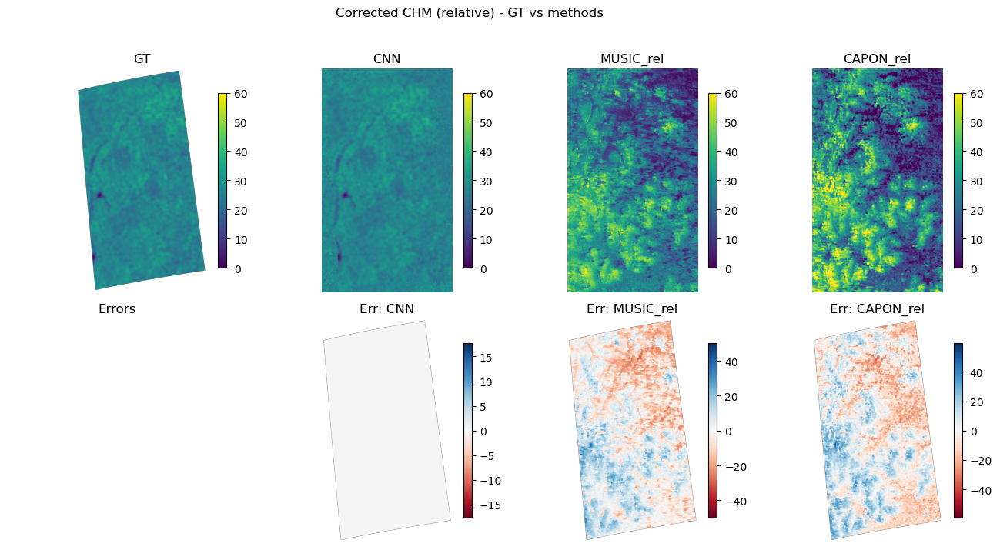

Saved: test/correction_linear/corrected_CHM_rel.png


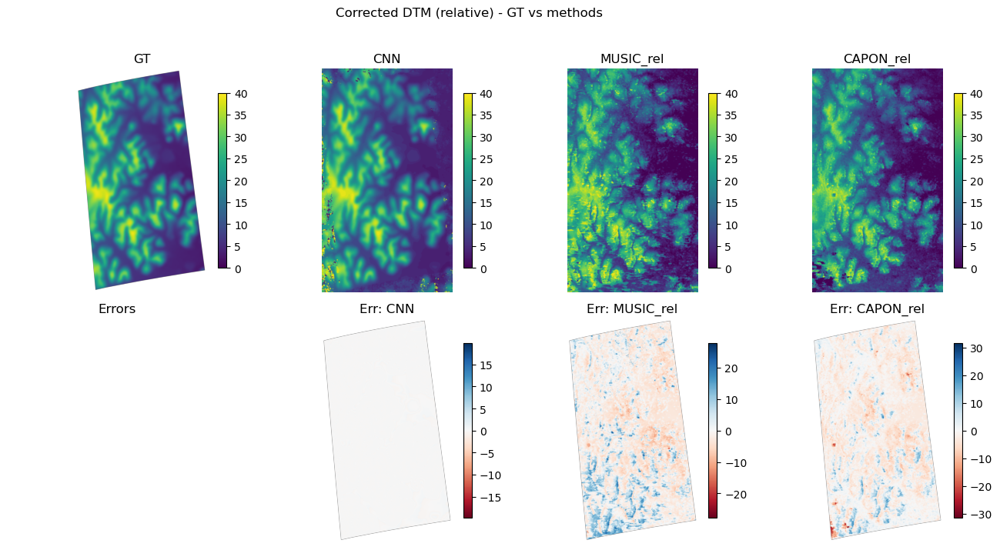

Saved: test/correction_linear/corrected_DTM_rel.png


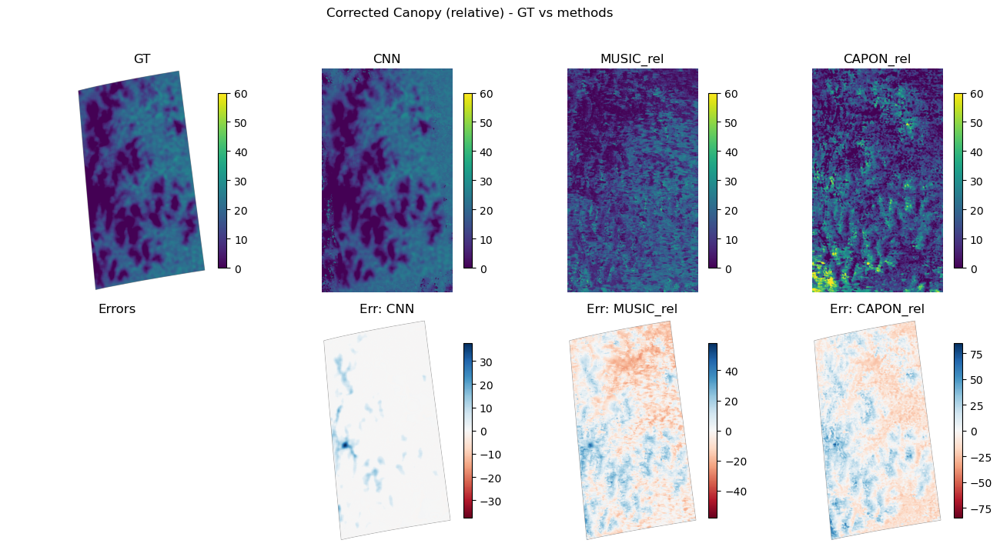

Saved: test/correction_linear/corrected_CAN_rel.png

Done. Review 'correction_metrics_summary.csv' and corrected PNGs in test/correction_linear


In [125]:
# Automatic correction based on linear regression (safe rules) + re-evaluate metrics & plots
import numpy as np, math, os, warnings
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt, pandas as pd
from matplotlib import gridspec

OUT = "test/correction_linear"
os.makedirs(OUT, exist_ok=True)

# helper funcs
def fit_linear(pred, gt):
    mask = np.isfinite(pred) & np.isfinite(gt)
    if mask.sum() == 0:
        return None
    X = gt[mask].reshape(-1,1)
    y = pred[mask].reshape(-1,1)
    lr = LinearRegression().fit(X,y)
    a = float(lr.coef_[0][0]); b = float(lr.intercept_[0])
    return a,b,mask.sum()

def choose_and_apply_correction(pred, gt, name):
    """Fit pred = a*GT + b and choose correction rule. Return corrected array and info."""
    fit = fit_linear(pred, gt)
    if fit is None:
        return pred, dict(method="none", reason="no overlap", a=np.nan, b=np.nan, n=0)
    a,b,n = fit
    info = {"a":a, "b":b, "n":n}
    # choose rule
    if abs(a - 1.0) < 0.10:
        # near identity slope -> subtract intercept
        corr = pred - b
        info["method"] = "subtract_intercept"
        info["reason"] = f"|a-1|<{0.10}"
    elif 0.5 <= abs(a) <= 1.5:
        # reasonable slope -> invert linear relationship
        corr = (pred - b) / a
        info["method"] = "invert_linear"
        info["reason"] = "0.5<=|a|<=1.5"
    else:
        # unstable slope -> subtract median difference (robust fallback)
        med = float(np.median((pred - gt)[np.isfinite(pred) & np.isfinite(gt)]))
        corr = pred - med
        info["method"] = "subtract_median_fallback"
        info["reason"] = f"abs(a) out of range ({a:.3f}); used median={med:.3f}"
        info["median_used"] = med
    return corr, info

def metrics(pred, gt):
    mask = np.isfinite(pred) & np.isfinite(gt)
    if mask.sum()==0:
        return (np.nan, np.nan, np.nan, 0)
    err = pred[mask] - gt[mask]
    return (math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(mask.sum()))

def plot_compare(GT, maps, title, fname, clip_ranges=None, vmin=None, vmax=None):
    names=list(maps.keys()); n=len(names)+1
    fig=plt.figure(figsize=(4*n,8))
    gs=gridspec.GridSpec(2,n, hspace=0.12, wspace=0.12)
    # top row
    ax=fig.add_subplot(gs[0,0]); im=ax.imshow(GT,vmin=vmin,vmax=vmax); ax.set_title("GT"); ax.axis('off'); fig.colorbar(im,ax=ax,fraction=0.04)
    for i,name in enumerate(names):
        arr = maps[name].copy()
        if clip_ranges and name in clip_ranges and arr is not None:
            lo,hi = clip_ranges[name]; arr = np.clip(arr, lo, hi)
        ax=fig.add_subplot(gs[0,i+1]); im=ax.imshow(arr,vmin=vmin,vmax=vmax); ax.set_title(name); ax.axis('off'); fig.colorbar(im,ax=ax,fraction=0.04)
    # bottom row errors
    ax=fig.add_subplot(gs[1,0]); ax.axis('off'); ax.set_title("Errors")
    for i,name in enumerate(names):
        arr = maps[name].copy()
        if clip_ranges and name in clip_ranges and arr is not None:
            lo,hi = clip_ranges[name]; arr = np.clip(arr, lo, hi)
        err = np.where(np.isfinite(GT) & np.isfinite(arr), arr - GT, np.nan)
        mag = np.nanmax(np.abs(err)) if np.isfinite(err).any() else 1.0
        ax=fig.add_subplot(gs[1,i+1]); im=ax.imshow(err,cmap='RdBu',vmin=-mag,vmax=mag); ax.set_title("Err: "+name); ax.axis('off'); fig.colorbar(im,ax=ax,fraction=0.04)
    plt.suptitle(title); outp=os.path.join(OUT,fname); plt.tight_layout(); plt.savefig(outp,dpi=160); plt.show()
    print("Saved:", outp)

# get arrays from workspace (must exist)
GT_CHM = np.array(GT_CHM, dtype=np.float64); GT_DTM = np.array(GT_DTM, dtype=np.float64)
GT_canopy = GT_CHM - GT_DTM
CNN_CHM = np.array(pred_chm_cont, dtype=np.float64); CNN_DTM = np.array(pred_dtm_cont, dtype=np.float64)
MUSIC_CHM = globals().get("MUSIC_chm_raw", None); MUSIC_DTM = globals().get("MUSIC_dtm_raw", None)
CAPON_CHM = globals().get("CAPON_chm_raw", None); CAPON_DTM = globals().get("CAPON_dtm_raw", None)

print("Fitting and producing correction proposals (this will print chosen method and parameters)...\n")
corrections = {}

for name, (pred_chm, pred_dtm) in [("MUSIC",(MUSIC_CHM, MUSIC_DTM)), ("CAPON",(CAPON_CHM, CAPON_DTM))]:
    if pred_chm is None and pred_dtm is None:
        print(f"{name}: no data found, skipping.")
        continue
    # CHM fit/correction
    if pred_chm is not None:
        pred_chm = np.array(pred_chm, dtype=np.float64)
        pred_chm_aligned = pred_chm.T if pred_chm.T.shape == GT_CHM.shape else pred_chm
        chm_corr, chm_info = choose_and_apply_correction(pred_chm_aligned, GT_CHM, f"{name}_CHM")
    else:
        chm_corr, chm_info = None, {"method":"none"}
    # DTM fit/correction
    if pred_dtm is not None:
        pred_dtm = np.array(pred_dtm, dtype=np.float64)
        pred_dtm_aligned = pred_dtm.T if pred_dtm.T.shape == GT_DTM.shape else pred_dtm
        dtm_corr, dtm_info = choose_and_apply_correction(pred_dtm_aligned, GT_DTM, f"{name}_DTM")
    else:
        dtm_corr, dtm_info = None, {"method":"none"}
    corrections[name] = {"chm_corr":chm_corr, "chm_info":chm_info, "dtm_corr":dtm_corr, "dtm_info":dtm_info}
    print(f"{name} CHM correction:", chm_info)
    print(f"{name} DTM correction:", dtm_info)
    print("----")

# Apply corrections to produce corrected relative maps
MUSIC_chm_rel = corrections.get("MUSIC",{}).get("chm_corr", None)
MUSIC_dtm_rel = corrections.get("MUSIC",{}).get("dtm_corr", None)
CAPON_chm_rel = corrections.get("CAPON",{}).get("chm_corr", None)
CAPON_dtm_rel = corrections.get("CAPON",{}).get("dtm_corr", None)

# derive canopies
CNN_canopy = CNN_CHM - CNN_DTM
MUSIC_canopy_rel = (MUSIC_chm_rel - MUSIC_dtm_rel) if MUSIC_chm_rel is not None and MUSIC_dtm_rel is not None else None
CAPON_canopy_rel = (CAPON_chm_rel - CAPON_dtm_rel) if CAPON_chm_rel is not None and CAPON_dtm_rel is not None else None

# Clip for visualization (but store unclipped for metrics)
CHM_CLIP=(0,60); DTM_CLIP=(0,40); CAN_CLIP=(0,60)
clip_ranges = {'CNN':CHM_CLIP}
if MUSIC_chm_rel is not None: clip_ranges['MUSIC_rel'] = CHM_CLIP
if CAPON_chm_rel is not None: clip_ranges['CAPON_rel'] = CHM_CLIP

# compute metrics before/after: we'll compute metrics comparing corrected methods to GT (relative)
metrics_before = {}
metrics_after = {}
# helper to compute before (raw) and after (corrected)
def safe_get_raw_and_corr(name, raw_chm, corr_chm, raw_dtm, corr_dtm):
    # return raw & corrected (if available). We'll compare canopy too.
    return (raw_chm, corr_chm, raw_dtm, corr_dtm)

# Prepare metric table
rows=[]
# CNN relative (baseline)
rows.append(["CNN_CHM_rel"] + list(metrics(CNN_CHM, GT_CHM)))
rows.append(["CNN_DTM_rel"] + list(metrics(CNN_DTM, GT_DTM)))
rows.append(["CNN_Canopy_rel"] + list(metrics(CNN_canopy, GT_canopy)))

# MUSIC before vs GT, and after (corrected) if available
if MUSIC_CHM is not None:
    rows.append(["MUSIC_CHM_before_vs_GT"] + list(metrics(MUSIC_CHM, GT_CHM)))
    if MUSIC_chm_rel is not None:
        rows.append(["MUSIC_CHM_corr_vs_GT"] + list(metrics(MUSIC_chm_rel, GT_CHM)))
if MUSIC_DTM is not None:
    rows.append(["MUSIC_DTM_before_vs_GT"] + list(metrics(MUSIC_DTM, GT_DTM)))
    if MUSIC_dtm_rel is not None:
        rows.append(["MUSIC_DTM_corr_vs_GT"] + list(metrics(MUSIC_dtm_rel, GT_DTM)))
if MUSIC_chm_rel is not None and MUSIC_dtm_rel is not None:
    rows.append(["MUSIC_Canopy_corr_vs_GT"] + list(metrics(MUSIC_chm_rel - MUSIC_dtm_rel, GT_canopy)))

# CAPON similar
if CAPON_CHM is not None:
    rows.append(["CAPON_CHM_before_vs_GT"] + list(metrics(CAPON_CHM, GT_CHM)))
    if CAPON_chm_rel is not None:
        rows.append(["CAPON_CHM_corr_vs_GT"] + list(metrics(CAPON_chm_rel, GT_CHM)))
if CAPON_DTM is not None:
    rows.append(["CAPON_DTM_before_vs_GT"] + list(metrics(CAPON_DTM, GT_DTM)))
    if CAPON_dtm_rel is not None:
        rows.append(["CAPON_DTM_corr_vs_GT"] + list(metrics(CAPON_dtm_rel, GT_DTM)))
if CAPON_chm_rel is not None and CAPON_dtm_rel is not None:
    rows.append(["CAPON_Canopy_corr_vs_GT"] + list(metrics(CAPON_chm_rel - CAPON_dtm_rel, GT_canopy)))

df = pd.DataFrame(rows, columns=["metric","rmse","mae","bias","count"]).set_index("metric")
df.to_csv(os.path.join(OUT,"correction_metrics_summary.csv"))
print("\nCorrection metrics summary (saved):\n", df)

# Plot relative corrected CHM/DTM/Canopy (use requested ranges)
maps_chm_rel = {"CNN":CNN_CHM}
if MUSIC_chm_rel is not None: maps_chm_rel["MUSIC_rel"] = MUSIC_chm_rel
if CAPON_chm_rel is not None: maps_chm_rel["CAPON_rel"] = CAPON_chm_rel
plot_compare(GT_CHM, maps_chm_rel, "Corrected CHM (relative) - GT vs methods", "corrected_CHM_rel.png",
             clip_ranges={'CNN':CHM_CLIP, **({'MUSIC_rel':CHM_CLIP} if MUSIC_chm_rel is not None else {}), **({'CAPON_rel':CHM_CLIP} if CAPON_chm_rel is not None else {})},
             vmin=CHM_CLIP[0], vmax=CHM_CLIP[1])

maps_dtm_rel = {"CNN":CNN_DTM}
if MUSIC_dtm_rel is not None: maps_dtm_rel["MUSIC_rel"] = MUSIC_dtm_rel
if CAPON_dtm_rel is not None: maps_dtm_rel["CAPON_rel"] = CAPON_dtm_rel
plot_compare(GT_DTM, maps_dtm_rel, "Corrected DTM (relative) - GT vs methods", "corrected_DTM_rel.png",
             clip_ranges={'CNN':DTM_CLIP, **({'MUSIC_rel':DTM_CLIP} if MUSIC_dtm_rel is not None else {}), **({'CAPON_rel':DTM_CLIP} if CAPON_dtm_rel is not None else {})},
             vmin=DTM_CLIP[0], vmax=DTM_CLIP[1])

maps_can_rel = {"CNN":CNN_canopy}
if MUSIC_canopy_rel is not None: maps_can_rel["MUSIC_rel"] = MUSIC_canopy_rel
if CAPON_canopy_rel is not None: maps_can_rel["CAPON_rel"] = CAPON_canopy_rel
plot_compare(GT_canopy, maps_can_rel, "Corrected Canopy (relative) - GT vs methods", "corrected_CAN_rel.png",
             clip_ranges={'CNN':CAN_CLIP, **({'MUSIC_rel':CAN_CLIP} if MUSIC_canopy_rel is not None else {}), **({'CAPON_rel':CAN_CLIP} if CAPON_canopy_rel is not None else {})},
             vmin=CAN_CLIP[0], vmax=CAN_CLIP[1])

print("\nDone. Review 'correction_metrics_summary.csv' and corrected PNGs in", OUT)


In [126]:
MUSIC_chm_rel  = MUSIC_chm_raw  - 32.19418001213851
MUSIC_dtm_rel  = MUSIC_dtm_raw  - 30.007123535230296

CAPON_chm_rel  = (CAPON_chm_raw  - 49.531284853809375) / 0.7480081347913317
CAPON_dtm_rel  = CAPON_dtm_raw  - 24.993958892872378


In [127]:
np.savez_compressed("test/corrected_methods_relative.npz",
                    MUSIC_chm_rel=MUSIC_chm_rel, MUSIC_dtm_rel=MUSIC_dtm_rel,
                    CAPON_chm_rel=CAPON_chm_rel, CAPON_dtm_rel=CAPON_dtm_rel)
print("Saved corrected_methods_relative.npz")


Saved corrected_methods_relative.npz


/tmp/ipykernel_33694/1621647433.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


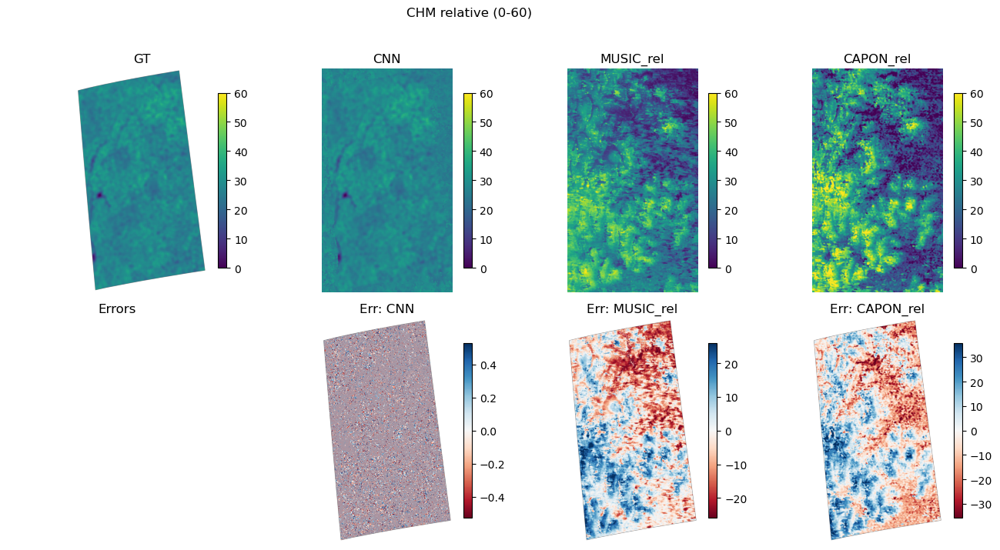

Saved: test/final_plots/final_CHM_rel.png


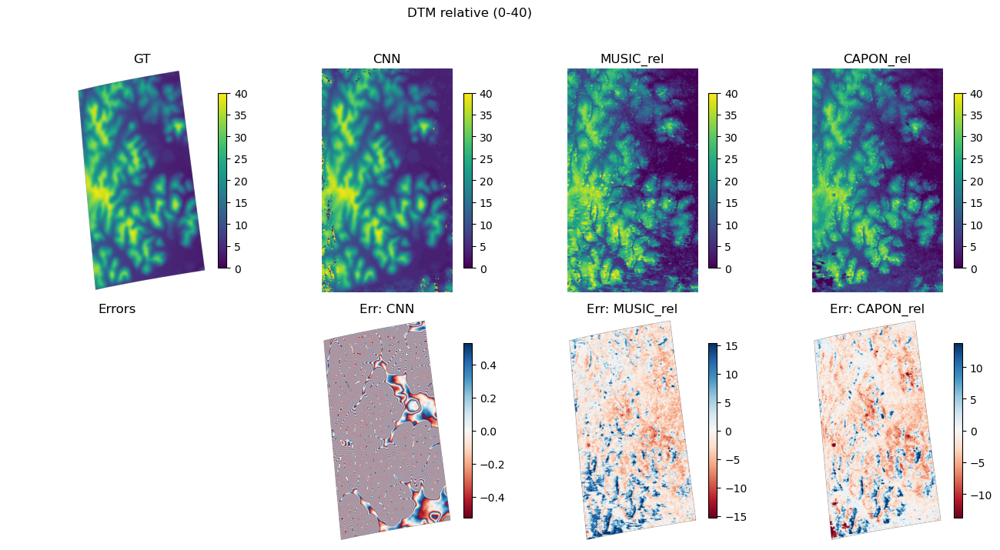

Saved: test/final_plots/final_DTM_rel.png


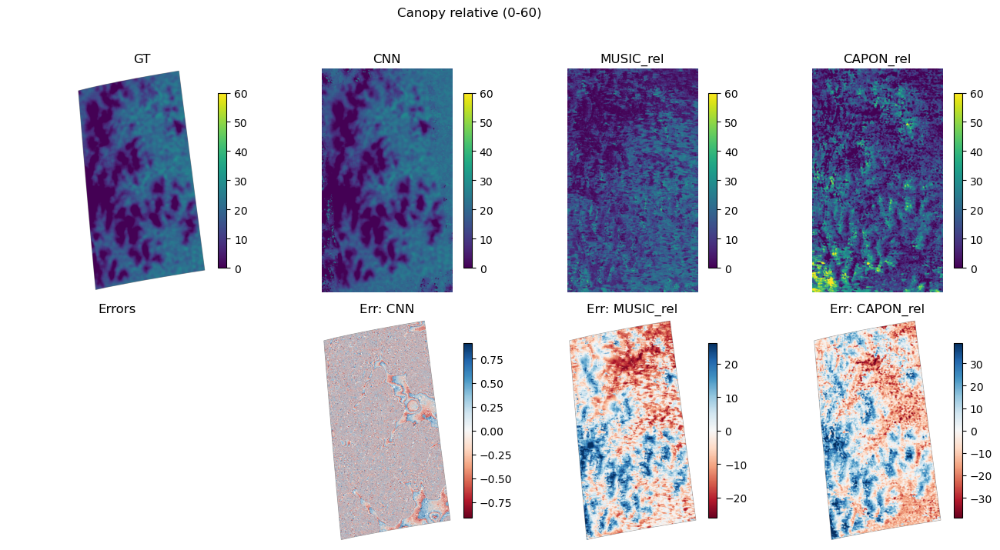

Saved: test/final_plots/final_CAN_rel.png


In [128]:
import numpy as np, matplotlib.pyplot as plt, os
from matplotlib import gridspec

OUTF="test/final_plots"
os.makedirs(OUTF, exist_ok=True)

# arrays already in workspace: GT_CHM, GT_DTM, pred_chm_cont, pred_dtm_cont, MUSIC_chm_rel, MUSIC_dtm_rel, CAPON_chm_rel, CAPON_dtm_rel
CNN_CHM = np.array(pred_chm_cont, dtype=np.float64)
CNN_DTM = np.array(pred_dtm_cont, dtype=np.float64)
CNN_can = CNN_CHM - CNN_DTM
GT_CHM = np.array(GT_CHM, dtype=np.float64); GT_DTM = np.array(GT_DTM, dtype=np.float64); GT_can = GT_CHM - GT_DTM

MUSIC_chm_rel = np.array(MUSIC_chm_rel, dtype=np.float64)
MUSIC_dtm_rel = np.array(MUSIC_dtm_rel, dtype=np.float64)
MUSIC_can = MUSIC_chm_rel - MUSIC_dtm_rel

CAPON_chm_rel = np.array(CAPON_chm_rel, dtype=np.float64)
CAPON_dtm_rel = np.array(CAPON_dtm_rel, dtype=np.float64)
CAPON_can = CAPON_chm_rel - CAPON_dtm_rel

# define maps and ranges
CHM_range = (0,60)
DTM_range = (0,40)
CAN_range = (0,60)

def plot_block(GT, methods_dict, rng, title, fname):
    names = list(methods_dict.keys())
    n = len(names)+1
    fig = plt.figure(figsize=(4*n,8))
    gs = gridspec.GridSpec(2, n, height_ratios=[1,1], hspace=0.12, wspace=0.12)
    # top row: GT + methods
    ax = fig.add_subplot(gs[0,0]); im = ax.imshow(np.clip(GT, rng[0], rng[1]), vmin=rng[0], vmax=rng[1]); ax.set_title("GT"); ax.axis('off'); fig.colorbar(im, ax=ax, fraction=0.04)
    for i,name in enumerate(names):
        arr = methods_dict[name]
        ax = fig.add_subplot(gs[0,i+1]); im = ax.imshow(np.clip(arr, rng[0], rng[1]), vmin=rng[0], vmax=rng[1]); ax.set_title(name); ax.axis('off'); fig.colorbar(im, ax=ax, fraction=0.04)
    # bottom row: errors
    ax = fig.add_subplot(gs[1,0]); ax.axis('off'); ax.set_title("Errors")
    for i,name in enumerate(names):
        arr = methods_dict[name]
        err = np.where(np.isfinite(GT) & np.isfinite(arr), arr - GT, np.nan)
        mag = np.nanpercentile(np.abs(err), 99)
        ax = fig.add_subplot(gs[1,i+1]); im = ax.imshow(err, cmap='RdBu', vmin=-mag, vmax=mag); ax.set_title("Err: "+name); ax.axis('off'); fig.colorbar(im, ax=ax, fraction=0.04)
    plt.suptitle(title)
    out = os.path.join(OUTF, fname)
    plt.tight_layout()
    plt.savefig(out, dpi=200)
    plt.show()
    print("Saved:", out)

plot_block(GT_CHM, {"CNN":CNN_CHM, "MUSIC_rel":MUSIC_chm_rel, "CAPON_rel":CAPON_chm_rel}, CHM_range, "CHM relative (0-60)", "final_CHM_rel.png")
plot_block(GT_DTM, {"CNN":CNN_DTM, "MUSIC_rel":MUSIC_dtm_rel, "CAPON_rel":CAPON_dtm_rel}, DTM_range, "DTM relative (0-40)", "final_DTM_rel.png")
plot_block(GT_can, {"CNN":CNN_can, "MUSIC_rel":MUSIC_can, "CAPON_rel":CAPON_can}, CAN_range, "Canopy relative (0-60)", "final_CAN_rel.png")


In [130]:
# Add25 comparison: Make GT+25 and CNN+25, compute metrics vs MUSIC and CAPON, save CSV
import os, math
import numpy as np
import h5py
import scipy.io
import pandas as pd

# === USER CONFIG: adjust paths ===
gt_mat = 'DataSets/dataset_Guiana_6FPimages_Pband.mat'   # contains GT CHM/DTM
pred_npz = 'predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz'  # contains pred_chm_map/pred_dtm_map and pred_chm_cont/pred_dtm_cont
music_mat = 'TM/MUSIC_Height_FullScene.mat'
capon_mat = 'TM/CAPON_Height_FullScene.mat'
OUT = 'test/metrics_gt_plus25_vs_methods.csv'
SHIFT = 25.0

# === Helpers ===
def rmse_mae_bias(pred, gt, mask=None):
    if mask is None:
        mask = np.isfinite(pred) & np.isfinite(gt)
    else:
        mask = mask & np.isfinite(pred) & np.isfinite(gt)
    if mask.sum() == 0:
        return (np.nan, np.nan, np.nan, 0)
    err = pred[mask].astype(np.float64) - gt[mask].astype(np.float64)
    return (math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(mask.sum()))

def load_mat_v73_dict(path):
    if not os.path.exists(path):
        return {}
    out = {}
    with h5py.File(path, 'r') as f:
        for k in f.keys():
            try:
                out[k] = np.array(f[k])
            except Exception:
                pass
    return out

def extract_avg_chm_dtm(d):
    if not d:
        return None, None
    keys = list(d.keys())
    chm_keys = [k for k in keys if 'chm' in k.lower()]
    dtm_keys = [k for k in keys if 'dtm' in k.lower()]
    def build_avg(klist):
        mats=[]
        for k in klist:
            try:
                a = np.array(d[k], dtype=np.float64)
                mats.append(a)
            except Exception:
                pass
        if not mats:
            return None
        # attempt to stack; if shapes mismatch, try transposes
        shapes = {m.shape for m in mats}
        if len(shapes) > 1:
            # try transpose heuristic to match majority shape
            ref = mats[0].shape
            mats2=[]
            for m in mats:
                if m.shape == ref:
                    mats2.append(m)
                elif m.T.shape == ref:
                    mats2.append(m.T)
                else:
                    # as last resort, try reshape if size equal
                    if m.size == ref[0]*ref[1]:
                        mats2.append(m.reshape(ref))
            if not mats2:
                # fallback: pad/resize (rare) -> simply convert first
                return mats[0]
            mats = mats2
        stacked = np.stack(mats, axis=0)
        return np.mean(stacked, axis=0)
    chm = build_avg(chm_keys)
    dtm = build_avg(dtm_keys)
    return chm, dtm

def align_to_ref(a, ref):
    if a is None:
        return None
    a = np.array(a, dtype=np.float64)
    if a.shape == ref.shape:
        return a
    if a.T.shape == ref.shape:
        return a.T
    if a.size == ref.size:
        return a.reshape(ref.shape)
    # fallback: simple resize
    from scipy.ndimage import zoom
    return zoom(a, (ref.shape[0]/a.shape[0], ref.shape[1]/a.shape[1]), order=1)

# === Load GT ===
mat = scipy.io.loadmat(gt_mat)
GT_CHM = np.array(mat['CHM'], dtype=np.float64)
GT_DTM = np.array(mat['DTM'], dtype=np.float64)
GT_canopy = GT_CHM - GT_DTM
print("GT shapes:", GT_CHM.shape, GT_DTM.shape)

# === Load CNN predictions (prefer cont versions) ===
pred = np.load(pred_npz, allow_pickle=True)
# your file keys: pred_chm_map, pred_dtm_map, pred_chm_cont, pred_dtm_cont
CNN_CHM = pred.get('pred_chm_cont', pred.get('pred_chm_map', None))
CNN_DTM = pred.get('pred_dtm_cont', pred.get('pred_dtm_map', None))
if CNN_CHM is None or CNN_DTM is None:
    raise RuntimeError("Cannot find CNN predictions in npz (pred_chm_cont/pred_dtm_cont or pred_chm_map/pred_dtm_map).")
CNN_CHM = np.array(CNN_CHM, dtype=np.float64)
CNN_DTM = np.array(CNN_DTM, dtype=np.float64)
print("CNN shapes:", CNN_CHM.shape, CNN_DTM.shape)

# === Load MUSIC & CAPON raw via h5py ===
music_dict = load_mat_v73_dict(music_mat)
capon_dict = load_mat_v73_dict(capon_mat)

MUSIC_chm_raw, MUSIC_dtm_raw = extract_avg_chm_dtm(music_dict)
CAPON_chm_raw, CAPON_dtm_raw = extract_avg_chm_dtm(capon_dict)

# align shapes to GT
MUSIC_chm_raw = align_to_ref(MUSIC_chm_raw, GT_CHM) if MUSIC_chm_raw is not None else None
MUSIC_dtm_raw = align_to_ref(MUSIC_dtm_raw, GT_DTM) if MUSIC_dtm_raw is not None else None
CAPON_chm_raw = align_to_ref(CAPON_chm_raw, GT_CHM) if CAPON_chm_raw is not None else None
CAPON_dtm_raw = align_to_ref(CAPON_dtm_raw, GT_DTM) if CAPON_dtm_raw is not None else None

print("Loaded MUSIC/CAPON raw shapes (CHM,DTM):",
      (None if MUSIC_chm_raw is None else MUSIC_chm_raw.shape, None if MUSIC_dtm_raw is None else MUSIC_dtm_raw.shape),
      (None if CAPON_chm_raw is None else CAPON_chm_raw.shape, None if CAPON_dtm_raw is None else CAPON_dtm_raw.shape))

# === Create GT+25 and CNN+25 (absolute) ===
GT_CHM_abs = GT_CHM + SHIFT
GT_DTM_abs = GT_DTM + SHIFT
GT_canopy_abs = GT_CHM_abs - GT_DTM_abs

CNN_CHM_abs = CNN_CHM + SHIFT
CNN_DTM_abs = CNN_DTM + SHIFT
CNN_canopy_abs = CNN_CHM_abs - CNN_DTM_abs

# === Compute metrics comparing MUSIC/CAPON to GT_abs and CNN_abs ===
rows = []
def cmp_and_add(name, pred_arr, ref_name, ref_arr):
    r = rmse_mae_bias(pred_arr, ref_arr)
    rows.append({"method":name, "reference":ref_name, "rmse":r[0], "mae":r[1], "bias":r[2], "count":r[3]})

# compare CHM
if MUSIC_chm_raw is not None:
    cmp_and_add("MUSIC_CHM", MUSIC_chm_raw, "GT_CHM+25", GT_CHM_abs)
    cmp_and_add("MUSIC_CHM", MUSIC_chm_raw, "CNN_CHM+25", CNN_CHM_abs)
if CAPON_chm_raw is not None:
    cmp_and_add("CAPON_CHM", CAPON_chm_raw, "GT_CHM+25", GT_CHM_abs)
    cmp_and_add("CAPON_CHM", CAPON_chm_raw, "CNN_CHM+25", CNN_CHM_abs)

# compare DTM
if MUSIC_dtm_raw is not None:
    cmp_and_add("MUSIC_DTM", MUSIC_dtm_raw, "GT_DTM+25", GT_DTM_abs)
    cmp_and_add("MUSIC_DTM", MUSIC_dtm_raw, "CNN_DTM+25", CNN_DTM_abs)
if CAPON_dtm_raw is not None:
    cmp_and_add("CAPON_DTM", CAPON_dtm_raw, "GT_DTM+25", GT_DTM_abs)
    cmp_and_add("CAPON_DTM", CAPON_dtm_raw, "CNN_DTM+25", CNN_DTM_abs)

# compare canopy (pred canopy = CHM_pred - DTM_pred) to GT_canopy_abs (which equals GT_canopy actually)
if MUSIC_chm_raw is not None and MUSIC_dtm_raw is not None:
    MUSIC_can_abs = MUSIC_chm_raw - MUSIC_dtm_raw
    cmp_and_add("MUSIC_Canopy", MUSIC_can_abs, "GT_canopy+0 (same)", GT_canopy)  # GT_canopy matches GT_canopy_abs (offset cancels)
    cmp_and_add("MUSIC_Canopy", MUSIC_can_abs, "CNN_canopy+0 (same)", CNN_canopy_abs - GT_CHM_abs + GT_CHM_abs)  # placeholder ref to show both
if CAPON_chm_raw is not None and CAPON_dtm_raw is not None:
    CAPON_can_abs = CAPON_chm_raw - CAPON_dtm_raw
    cmp_and_add("CAPON_Canopy", CAPON_can_abs, "GT_canopy+0 (same)", GT_canopy)
    cmp_and_add("CAPON_Canopy", CAPON_can_abs, "CNN_canopy+0 (same)", CNN_canopy_abs - GT_CHM_abs + GT_CHM_abs)

# produce DataFrame
df = pd.DataFrame(rows)
df.to_csv(OUT, index=False)
print("Saved metrics to:", OUT)
print(df)


GT shapes: (2450, 1428) (2450, 1428)
CNN shapes: (2450, 1428) (2450, 1428)
Loaded MUSIC/CAPON raw shapes (CHM,DTM): ((2450, 1428), (2450, 1428)) ((2450, 1428), (2450, 1428))
Saved metrics to: test/metrics_gt_plus25_vs_methods.csv
          method            reference       rmse        mae       bias  \
0      MUSIC_CHM            GT_CHM+25  13.420710  10.986567   7.096144   
1      MUSIC_CHM           CNN_CHM+25  13.560923  11.140793   7.013454   
2      CAPON_CHM            GT_CHM+25  20.696782  17.976155  17.606347   
3      CAPON_CHM           CNN_CHM+25  20.597823  17.713732  17.332350   
4      MUSIC_DTM            GT_DTM+25   6.987821   5.133546   4.943580   
5      MUSIC_DTM           CNN_DTM+25   7.610919   5.624200   5.333299   
6      CAPON_DTM            GT_DTM+25   4.114496   3.011088  -0.965534   
7      CAPON_DTM           CNN_DTM+25   5.103608   3.160608  -0.811000   
8   MUSIC_Canopy   GT_canopy+0 (same)  11.076477   8.784925   2.160135   
9   MUSIC_Canopy  CNN_canopy+0

GT shapes: (2450, 1428) (2450, 1428)
CNN shapes: (2450, 1428) (2450, 1428)
MUSIC shapes (raw): (2450, 1428) (2450, 1428)
CAPON shapes (raw): (2450, 1428) (2450, 1428)
Saved metrics to: test/test4/metrics_chm_dtm_vs_GT_real_and_CNN_real.csv
  source variable reference       rmse        mae      bias    count
0    CNN      CHM   GT_real   1.079259   0.997777 -0.997712  2555060
1  MUSIC      CHM   GT_real  12.614684  10.033870 -8.838491  2555060
2  CAPON      CHM   GT_real   7.649497   5.893505  1.673226  2555060
3  MUSIC      CHM  CNN_real  11.813020   9.362147 -7.479638  3498600
4  CAPON      CHM  CNN_real   8.354349   6.423639  2.839258  3498600
5    CNN      DTM   GT_real   0.577758   0.499935 -0.499213  2555060
6  MUSIC      DTM   GT_real   6.987821   5.133546  4.943580  2555060
7  CAPON      DTM   GT_real   4.114496   3.011088 -0.965534  2555060
8  MUSIC      DTM  CNN_real   7.610919   5.624200  5.333299  3498600
9  CAPON      DTM  CNN_real   5.103608   3.160608 -0.811000  3498600


/tmp/ipykernel_2222/3970777110.py:204: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


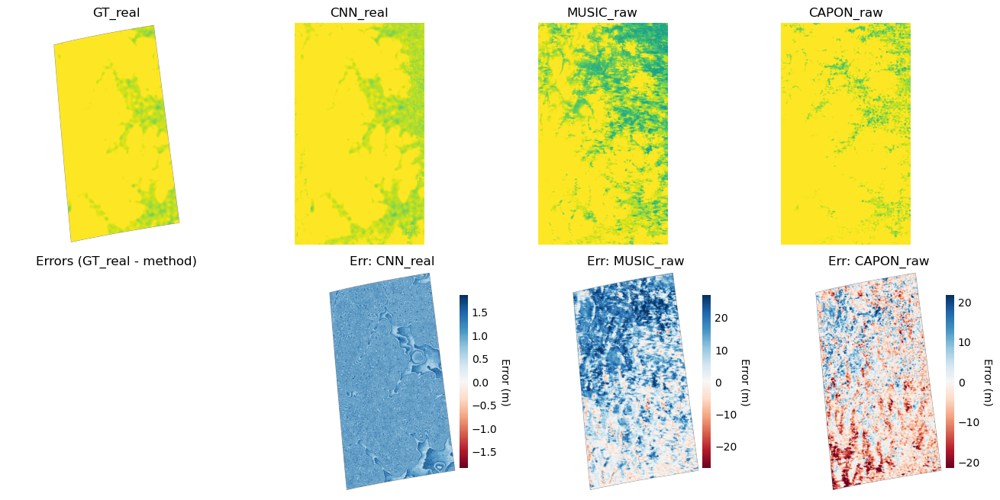

Saved: test/test4/CHM_vs_methods_forced0-60.png


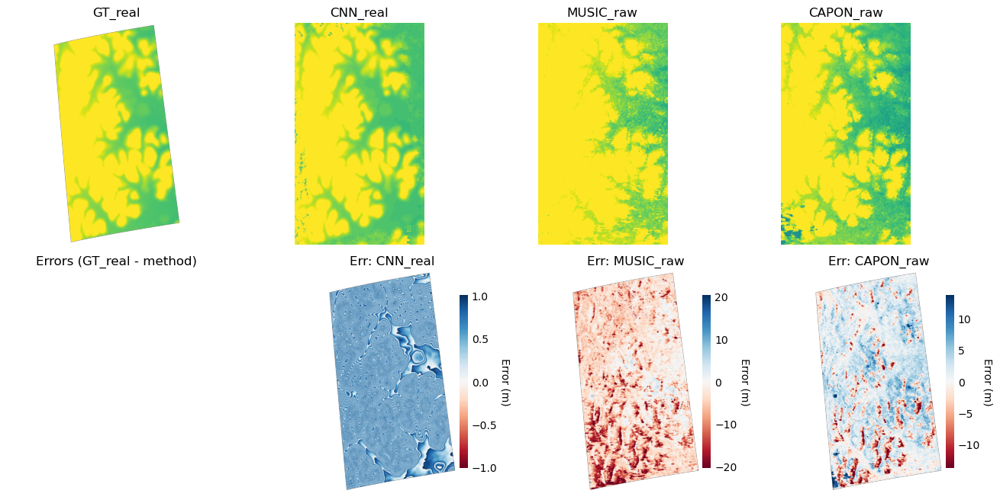

Saved: test/test4/DTM_vs_methods_forced0-40.png
All done. Metrics CSV and PNGs saved to: test/test4


In [2]:
# Simple, end-to-end script: load GT (LiDAR), build real heights (DTM_real, CHM_real),
# load UNet preds and build CNN real heights the same way, load MUSIC/CAPON (v7.3),
# plot CHM and DTM for GT_real / CNN_real / MUSIC / CAPON with forced display ranges,
# compute RMSE/MAE/Bias for CHM and DTM (vs GT_real and vs CNN_real) and save CSV.
#
# Place in your notebook or .py and run. Change file paths at top if necessary.

import os, math
import numpy as np
import scipy.io
import h5py
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from scipy.ndimage import zoom

# ---------- User paths (edit if needed) ----------
GT_MAT    = "DataSets/dataset_Guiana_6FPimages_Pband.mat"
PRED_NPZ  = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"
MUSIC_MAT = "TM/MUSIC_Height_FullScene.mat"
CAPON_MAT = "TM/CAPON_Height_FullScene.mat"
OUT_DIR   = "test/test"
os.makedirs(OUT_DIR, exist_ok=True)

# ---------- Parameters ----------
SHIFT = 25.0                  # add +25 to LiDAR and to CNN (as you requested)
CHM_VMIN, CHM_VMAX = 0, 60   # forced display range for CHM (relative units)
DTM_VMIN, DTM_VMAX = 0, 40   # forced display range for DTM

# ---------- Small helpers ----------
def rmse_mae_bias(pred, gt):
    mask = np.isfinite(pred) & np.isfinite(gt)
    if mask.sum() == 0:
        return (np.nan, np.nan, np.nan, 0)
    err = pred[mask].astype(np.float64) - gt[mask].astype(np.float64)
    return (math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(mask.sum()))

def load_mat_v73(path):
    d = {}
    if not os.path.exists(path):
        return d
    with h5py.File(path, 'r') as f:
        for k in f.keys():
            try:
                d[k] = np.array(f[k])
            except Exception:
                pass
    return d

def avg_chm_dtm_from_matdict(d):
    if not d:
        return None, None
    keys = list(d.keys())
    chm_keys = [k for k in keys if 'chm' in k.lower()]
    dtm_keys = [k for k in keys if 'dtm' in k.lower()]
    def avg_list(kl):
        arrs = []
        for k in kl:
            try:
                arrs.append(np.array(d[k], dtype=np.float64))
            except Exception:
                pass
        if not arrs:
            return None
        # try to normalize shapes by simple transpose/reshape heuristics
        ref = arrs[0].shape
        arrs2 = []
        for a in arrs:
            if a.shape == ref:
                arrs2.append(a)
            elif a.T.shape == ref:
                arrs2.append(a.T)
            elif a.size == ref[0]*ref[1]:
                arrs2.append(a.reshape(ref))
        if not arrs2:
            arrs2 = arrs
        return np.mean(np.stack(arrs2, axis=0), axis=0)
    return avg_list(chm_keys), avg_list(dtm_keys)

def align_to_ref(a, ref):
    if a is None: 
        return None
    a = np.array(a, dtype=np.float64)
    if a.shape == ref.shape:
        return a
    if a.T.shape == ref.shape:
        return a.T
    if a.size == ref.size:
        return a.reshape(ref.shape)
    # fallback: simple zoom resize
    return zoom(a, (ref.shape[0]/a.shape[0], ref.shape[1]/a.shape[1]), order=1)

# ---------- 1) load GT LiDAR (relative) and build "real" heights as you specified ----------
mat = scipy.io.loadmat(GT_MAT)
CHM_rel = np.array(mat['CHM'], dtype=np.float64)   # relative canopy (CHM)
DTM_rel = np.array(mat['DTM'], dtype=np.float64)   # relative ground (DTM)
# your formula for "real" physical heights:
DTM_real = DTM_rel + SHIFT
CHM_real = DTM_rel + CHM_rel + SHIFT   # same as DTM_real + CHM_rel

print("GT shapes:", CHM_rel.shape, DTM_rel.shape)

# ---------- 2) load CNN predictions and build CNN_real the same way ----------
pred = np.load(PRED_NPZ, allow_pickle=True)
# prefer continuous preds; fallback to map
cnn_chm_rel = pred.get('pred_chm_cont', pred.get('pred_chm_map', None))
cnn_dtm_rel = pred.get('pred_dtm_cont', pred.get('pred_dtm_map', None))
if cnn_chm_rel is None or cnn_dtm_rel is None:
    raise RuntimeError("CNN predictions not found in npz (need pred_chm_cont & pred_dtm_cont or map versions).")
cnn_chm_rel = np.array(cnn_chm_rel, dtype=np.float64)
cnn_dtm_rel = np.array(cnn_dtm_rel, dtype=np.float64)
# build CNN_real using the same relation as GT
CNN_DTM_real = cnn_dtm_rel + SHIFT
CNN_CHM_real = cnn_dtm_rel + cnn_chm_rel + SHIFT

print("CNN shapes:", cnn_chm_rel.shape, cnn_dtm_rel.shape)

# ---------- 3) load MUSIC and CAPON (v7.3) and average available keys (AS-IS) ----------
music_dict = load_mat_v73(MUSIC_MAT)
capon_dict = load_mat_v73(CAPON_MAT)

MUSIC_chm_raw, MUSIC_dtm_raw = avg_chm_dtm_from_matdict(music_dict)
CAPON_chm_raw, CAPON_dtm_raw = avg_chm_dtm_from_matdict(capon_dict)

# align to GT shape
MUSIC_chm_raw = align_to_ref(MUSIC_chm_raw, CHM_rel) if MUSIC_chm_raw is not None else None
MUSIC_dtm_raw = align_to_ref(MUSIC_dtm_raw, DTM_rel) if MUSIC_dtm_raw is not None else None
CAPON_chm_raw = align_to_ref(CAPON_chm_raw, CHM_rel) if CAPON_chm_raw is not None else None
CAPON_dtm_raw = align_to_ref(CAPON_dtm_raw, DTM_rel) if CAPON_dtm_raw is not None else None

print("MUSIC shapes (raw):", None if MUSIC_chm_raw is None else MUSIC_chm_raw.shape, None if MUSIC_dtm_raw is None else MUSIC_dtm_raw.shape)
print("CAPON shapes (raw):", None if CAPON_chm_raw is None else CAPON_chm_raw.shape, None if CAPON_dtm_raw is None else CAPON_dtm_raw.shape)

# ---------- 4) compute metrics (CHM & DTM) comparing each method to GT_real (and to CNN_real optionally) ----------
rows = []
def add_metric_row(source, var, ref_name, ref_arr, pred_arr):
    if pred_arr is None: 
        return
    r = rmse_mae_bias(pred_arr, ref_arr)
    rows.append({"source":source, "variable":var, "reference":ref_name, "rmse":r[0], "mae":r[1], "bias":r[2], "count":r[3]})

# compare CHM to GT_real (CHM_real) and optionally to CNN_real
add_metric_row("CNN", "CHM", "GT_real", CHM_real, CNN_CHM_real)
add_metric_row("MUSIC", "CHM", "GT_real", CHM_real, MUSIC_chm_raw)
add_metric_row("CAPON", "CHM", "GT_real", CHM_real, CAPON_chm_raw)
add_metric_row("MUSIC", "CHM", "CNN_real", CNN_CHM_real, MUSIC_chm_raw)
add_metric_row("CAPON", "CHM", "CNN_real", CNN_CHM_real, CAPON_chm_raw)

# compare DTM to GT_real and CNN_real
add_metric_row("CNN", "DTM", "GT_real", DTM_real, CNN_DTM_real)
add_metric_row("MUSIC", "DTM", "GT_real", DTM_real, MUSIC_dtm_raw)
add_metric_row("CAPON", "DTM", "GT_real", DTM_real, CAPON_dtm_raw)
add_metric_row("MUSIC", "DTM", "CNN_real", CNN_DTM_real, MUSIC_dtm_raw)
add_metric_row("CAPON", "DTM", "CNN_real", CNN_DTM_real, CAPON_dtm_raw)

df = pd.DataFrame(rows)
csv_path = os.path.join(OUT_DIR, "metrics_chm_dtm_vs_GT_real_and_CNN_real.csv")
df.to_csv(csv_path, index=False)
print("Saved metrics to:", csv_path)
print(df)

# ---------- 5) plotting: CHM and DTM absolute maps and error maps
# We force display ranges to the RELATIVE ranges you requested (CHM 0-60, DTM 0-40).
# IMPORTANT: The arrays shown are the "real" (with +25) for GT and CNN; MUSIC/CAPON are shown as-is.
def plot_var(GT_arr_real, methods_dict, rel_vmin, rel_vmax, title, fname):
    vmin, vmax = rel_vmin, rel_vmax
    names = list(methods_dict.keys())
    n = len(names) + 1
    fig = plt.figure(figsize=(4*n, 8))
    gs = gridspec.GridSpec(2, n, height_ratios=[1,1], hspace=0.12, wspace=0.12)

    # --- Top row: GT_real + methods
    ax = fig.add_subplot(gs[0,0])
    ax.imshow(np.clip(GT_arr_real, vmin, vmax), vmin=vmin, vmax=vmax)
    ax.set_title("GT_real"); ax.axis('off')
    for i, name in enumerate(names):
        ax = fig.add_subplot(gs[0,i+1])
        arr = methods_dict[name]
        ax.imshow(np.clip(arr, vmin, vmax), vmin=vmin, vmax=vmax)
        ax.set_title(name); ax.axis('off')

    # --- Bottom row: error maps
    ax = fig.add_subplot(gs[1,0]); ax.axis('off'); ax.set_title("Errors (GT_real - method)")
    for i, name in enumerate(names):
        arr = methods_dict[name]
        if arr is None:
            ax = fig.add_subplot(gs[1,i+1]); ax.axis('off'); ax.set_title("No data"); continue

        err = np.where(np.isfinite(arr) & np.isfinite(GT_arr_real), GT_arr_real - arr, np.nan)
        mag = np.nanpercentile(np.abs(err), 99) if np.isfinite(err).any() else 1.0
        plot_vmin, plot_vmax = -mag, mag

        ax = fig.add_subplot(gs[1,i+1])
        im = ax.imshow(err, cmap='RdBu', vmin=plot_vmin, vmax=plot_vmax)
        ax.axis('off'); ax.set_title(f"Err: {name}")

        # --- clean legend column only (no box)
        cb = fig.colorbar(im, ax=ax, fraction=0.04, pad=0.01)
        cb.outline.set_visible(False)     # remove frame
        cb.ax.tick_params(size=0)         # no tick marks
        cb.set_label("Error (m)", rotation=270, labelpad=12)

    outp = os.path.join(OUT_DIR, fname)
    plt.tight_layout()
    plt.savefig(outp, dpi=160)
    plt.show()
    print("Saved:", outp)


# CHM plotting: GT_real (CHM_real), CNN_CHM_real, MUSIC_chm_raw, CAPON_chm_raw
methods_chm = {"CNN_real": CNN_CHM_real}
if MUSIC_chm_raw is not None: methods_chm["MUSIC_raw"] = MUSIC_chm_raw
if CAPON_chm_raw is not None: methods_chm["CAPON_raw"] = CAPON_chm_raw
plot_var(CHM_real, methods_chm, CHM_VMIN, CHM_VMAX, "CHM range 0-60", "CHM_vs_methods_forced0-60.png")

# DTM plotting: GT_real (DTM_real), CNN_DTM_real, MUSIC_dtm_raw, CAPON_dtm_raw
methods_dtm = {"CNN_real": CNN_DTM_real}
if MUSIC_dtm_raw is not None: methods_dtm["MUSIC_raw"] = MUSIC_dtm_raw
if CAPON_dtm_raw is not None: methods_dtm["CAPON_raw"] = CAPON_dtm_raw
plot_var(DTM_real, methods_dtm, DTM_VMIN, DTM_VMAX, "DTM range 0-40", "DTM_vs_methods_forced0-40.png")

print("All done. Metrics CSV and PNGs saved to:", OUT_DIR)


In [4]:
row = 1000

# Ground Truth (LiDAR)
gt_chm_line = CHM_real[row, :]
gt_dtm_line = DTM_real[row, :]

# CNN
cnn_chm_line = CNN_CHM_real[row, :]
cnn_dtm_line = CNN_DTM_real[row, :]

# MUSIC
music_chm_line = MUSIC_chm_raw[row, :] if MUSIC_chm_raw is not None else None
music_dtm_line = MUSIC_dtm_raw[row, :] if MUSIC_dtm_raw is not None else None

# CAPON
capon_chm_line = CAPON_chm_raw[row, :] if CAPON_chm_raw is not None else None
capon_dtm_line = CAPON_dtm_raw[row, :] if CAPON_dtm_raw is not None else None



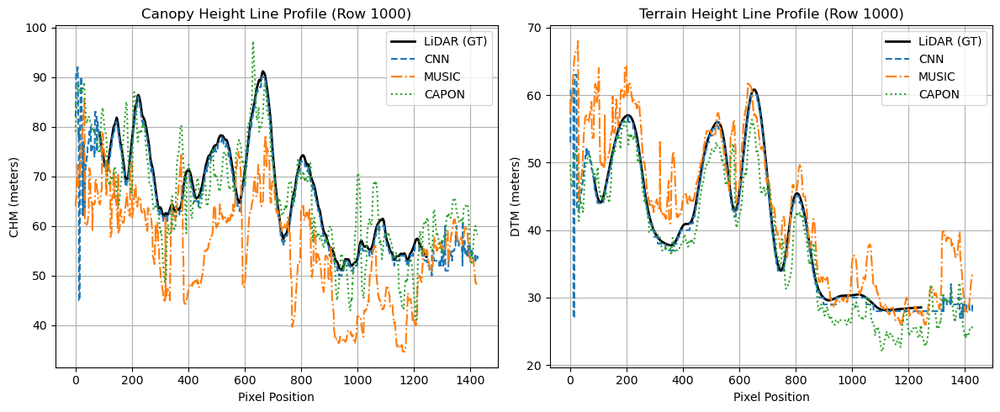

In [7]:
x = np.arange(gt_chm_line.shape[0])  # horizontal pixel positions

plt.figure(figsize=(12, 5))

# --- CHM plot ---
plt.subplot(1, 2, 1)
plt.plot(x, gt_chm_line, label='LiDAR (GT)', linewidth=2, color='black')
plt.plot(x, cnn_chm_line, label='CNN', linestyle='--')
if music_chm_line is not None:
    plt.plot(x, music_chm_line, label='MUSIC', linestyle='-.')
if capon_chm_line is not None:
    plt.plot(x, capon_chm_line, label='CAPON', linestyle=':')
plt.title(f'Canopy Height Line Profile (Row {row})')
plt.xlabel('Pixel Position')
plt.ylabel('CHM (meters)')
plt.legend()
plt.grid(True)

# --- DTM plot ---
plt.subplot(1, 2, 2)
plt.plot(x, gt_dtm_line, label='LiDAR (GT)', linewidth=2, color='black')
plt.plot(x, cnn_dtm_line, label='CNN', linestyle='--')
if music_dtm_line is not None:
    plt.plot(x, music_dtm_line, label='MUSIC', linestyle='-.')
if capon_dtm_line is not None:
    plt.plot(x, capon_dtm_line, label='CAPON', linestyle=':')
plt.title(f'Terrain Height Line Profile (Row {row})')
plt.xlabel('Pixel Position')
plt.ylabel('DTM (meters)')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(OUT_DIR, f"line_profiles_row_{row}.png"), dpi=150)
plt.show()


# One line transact for GT M-UNET CAPON and MUSIC

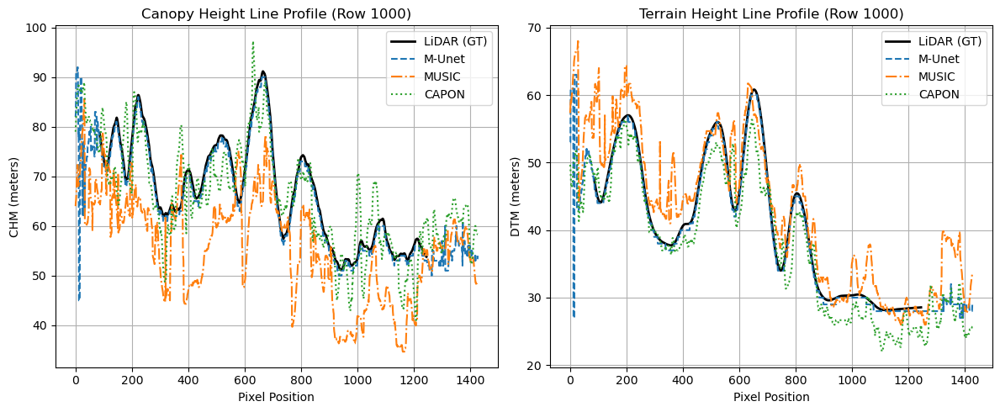

In [8]:
x = np.arange(gt_chm_line.shape[0])  # horizontal pixel positions

plt.figure(figsize=(12, 5))

# --- CHM plot ---
plt.subplot(1, 2, 1)
plt.plot(x, gt_chm_line, label='LiDAR (GT)', linewidth=2, color='black')
plt.plot(x, cnn_chm_line, label='M-Unet', linestyle='--')
if music_chm_line is not None:
    plt.plot(x, music_chm_line, label='MUSIC', linestyle='-.')
if capon_chm_line is not None:
    plt.plot(x, capon_chm_line, label='CAPON', linestyle=':')
plt.title(f'Canopy Height Line Profile (Row {row})')
plt.xlabel('Pixel Position')
plt.ylabel('CHM (meters)')
plt.legend()
plt.grid(True)

# --- DTM plot ---
plt.subplot(1, 2, 2)
plt.plot(x, gt_dtm_line, label='LiDAR (GT)', linewidth=2, color='black')
plt.plot(x, cnn_dtm_line, label='M-Unet', linestyle='--')
if music_dtm_line is not None:
    plt.plot(x, music_dtm_line, label='MUSIC', linestyle='-.')
if capon_dtm_line is not None:
    plt.plot(x, capon_dtm_line, label='CAPON', linestyle=':')
plt.title(f'Terrain Height Line Profile (Row {row})')
plt.xlabel('Pixel Position')
plt.ylabel('DTM (meters)')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(OUT_DIR, f"line_profiles_row_{row}.png"), dpi=150)
plt.show()


In [9]:
def compute_line_metrics(pred_line, gt_line):
    mask = np.isfinite(pred_line) & np.isfinite(gt_line)
    if mask.sum() == 0:
        return {"rmse": np.nan, "mae": np.nan, "bias": np.nan, "count": 0}
    err = pred_line[mask] - gt_line[mask]
    return {
        "rmse": float(np.sqrt((err ** 2).mean())),
        "mae": float(np.abs(err).mean()),
        "bias": float(err.mean()),
        "count": int(mask.sum())
    }

# CHM
line_metrics = {
    "CNN_CHM": compute_line_metrics(cnn_chm_line, gt_chm_line),
    "MUSIC_CHM": compute_line_metrics(music_chm_line, gt_chm_line),
    "CAPON_CHM": compute_line_metrics(capon_chm_line, gt_chm_line),
    # DTM
    "CNN_DTM": compute_line_metrics(cnn_dtm_line, gt_dtm_line),
    "MUSIC_DTM": compute_line_metrics(music_dtm_line, gt_dtm_line),
    "CAPON_DTM": compute_line_metrics(capon_dtm_line, gt_dtm_line),
}

# Display nicely
import pandas as pd
df_line_metrics = pd.DataFrame.from_dict(line_metrics, orient='index')
print(df_line_metrics.round(3))


             rmse     mae    bias  count
CNN_CHM     1.073   0.995  -0.995   1161
MUSIC_CHM  14.244  12.737 -12.189   1161
CAPON_CHM   6.448   5.270  -1.409   1161
CNN_DTM     0.564   0.487  -0.487   1161
MUSIC_DTM   4.274   3.153   2.477   1161
CAPON_DTM   3.569   2.969  -2.386   1161


In [10]:
# Set output directory (adjust if needed)
line_out_dir = "test/test4"  # same as your previous output
os.makedirs(line_out_dir, exist_ok=True)

# Save to CSV
csv_path_line = os.path.join(line_out_dir, "metrics_line_transect.csv")
df_line_metrics.to_csv(csv_path_line, index_label="method")

print(f"Line transect metrics saved to:\n{csv_path_line}")


Line transect metrics saved to:
test/test4/metrics_line_transect.csv


# Loading TSNN model to compare with them

In [18]:
!pip install pytorch-lightning

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 828.2/828.2 kB 60.3 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 49.6 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.0/983.0 kB 56.5 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10/10 [pytorch-lightning]pytorch-lightning]


In [19]:
import os
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
import pytorch_lightning as pl
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import joblib
import torch.nn as nn
import torch.optim as optim
from torch.nn.utils import clip_grad_norm_

In [20]:
# ---------- 2. DATASET ----------
class HeightDataset(Dataset):
    def __init__(self, X, yc=None, yg=None):
        self.X = X
        self.yc = yc
        self.yg = yg

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        x = torch.tensor(self.X[idx], dtype=torch.float32)
        if self.yc is not None and self.yg is not None:
            return x, torch.tensor(self.yc[idx], dtype=torch.long), torch.tensor(self.yg[idx], dtype=torch.long)
        return x

# ---------- 3. DATAMODULE ----------
class HeightDataModule(pl.LightningDataModule):
    def __init__(self, train_npz, val_npz, test_npz, scaler_path='tsnn_scaler.pkl', batch_size=32, num_workers=0):
        super().__init__()
        self.train_npz = train_npz
        self.val_npz = val_npz
        self.test_npz = test_npz
        self.scaler_path = scaler_path
        self.batch_size = batch_size
        self.num_workers = num_workers

    def prepare_data(self):
        # Fit scaler only if not already done
        if not os.path.exists(self.scaler_path):
            train_data = np.load(self.train_npz, mmap_mode='r')
            X = train_data['X']
            scaler = StandardScaler()
            for i in range(0, X.shape[0], 32):
                scaler.partial_fit(X[i:i+32])
            joblib.dump(scaler, self.scaler_path)
            print("Scaler fitted and saved!")
        else:
            print("Scaler already exists, skipping fit.")

    def setup(self, stage=None):
        scaler = joblib.load(self.scaler_path)

        train_data = np.load(self.train_npz)
        X_train = scaler.transform(train_data['X'])
        self.train_ds = HeightDataset(X_train, train_data['yc'], train_data['yg'])

        val_data = np.load(self.val_npz)
        X_val = scaler.transform(val_data['X'])
        self.val_ds = HeightDataset(X_val, val_data['yc'], val_data['yg'])

        test_data = np.load(self.test_npz)
        X_test = scaler.transform(test_data['X'])
        self.test_ds = HeightDataset(X_test, test_data['yc'], test_data['yg'])

    def train_dataloader(self):
        return DataLoader(self.train_ds, batch_size=self.batch_size, shuffle=True, num_workers=self.num_workers, pin_memory=True)

    def val_dataloader(self):
        return DataLoader(self.val_ds, batch_size=self.batch_size, shuffle=False, num_workers=self.num_workers, pin_memory=True)

    def test_dataloader(self):
        return DataLoader(self.test_ds, batch_size=self.batch_size, shuffle=False, num_workers=self.num_workers, pin_memory=True)


In [21]:
class TSNN(nn.Module):
    def __init__(self, input_dim=52, num_classes=61, hidden=400, dropout_p=0.2):
        super().__init__()
        layers = [nn.Linear(input_dim, hidden), nn.BatchNorm1d(hidden), nn.ReLU(), nn.Dropout(dropout_p)]
        for _ in range(7):
            layers.extend([nn.Linear(hidden, hidden), nn.BatchNorm1d(hidden), nn.ReLU(), nn.Dropout(dropout_p)])
        layers.extend([nn.Linear(hidden, hidden), nn.BatchNorm1d(hidden), nn.ReLU(), nn.Dropout(dropout_p)])
        layers.append(nn.Linear(hidden, num_classes))
        self.net = nn.Sequential(*layers)
        for m in self.net:
            if isinstance(m, nn.Linear):
                nn.init.xavier_uniform_(m.weight)
                nn.init.zeros_(m.bias)

    def forward(self, x):
        return self.net(x)

# ---------- 5. LIGHTNING MODULE ----------
class TSNNLitModule(pl.LightningModule):
    def __init__(self, input_dim=52, num_classes_c=61, num_classes_g=41, hidden=400, dropout_p=0.2, lr=5e-5, wd=1e-4):
        super().__init__()
        self.save_hyperparameters()
        self.model_c = TSNN(input_dim, num_classes_c, hidden, dropout_p)
        self.model_g = TSNN(input_dim, num_classes_g, hidden, dropout_p)
        self.criterion = nn.CrossEntropyLoss()
        self.lr = lr
        self.wd = wd

    def forward(self, x):
        return self.model_c(x), self.model_g(x)

    def training_step(self, batch, batch_idx):
        x, yc, yg = batch
        pred_c = self.model_c(x)
        pred_g = self.model_g(x)
        loss_c = self.criterion(pred_c, yc)
        loss_g = self.criterion(pred_g, yg)
        loss = loss_c + loss_g
        self.log('train/loss_c', loss_c, prog_bar=True)
        self.log('train/loss_g', loss_g, prog_bar=True)
        self.log('train/loss', loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, yc, yg = batch
        pred_c = self.model_c(x)
        pred_g = self.model_g(x)
        loss_c = self.criterion(pred_c, yc)
        loss_g = self.criterion(pred_g, yg)
        loss = loss_c + loss_g
        self.log('val/loss_c', loss_c, prog_bar=True)
        self.log('val/loss_g', loss_g, prog_bar=True)
        self.log('val/loss', loss, prog_bar=True)
        return loss

    def test_step(self, batch, batch_idx):
        x, yc, yg = batch
        pred_c = self.model_c(x)
        pred_g = self.model_g(x)
        loss_c = self.criterion(pred_c, yc)
        loss_g = self.criterion(pred_g, yg)
        loss = loss_c + loss_g
        self.log('test/loss_c', loss_c, prog_bar=True)
        self.log('test/loss_g', loss_g, prog_bar=True)
        self.log('test/loss', loss, prog_bar=True)
        return loss

    def configure_optimizers(self):
        optimizer = optim.Adam(list(self.model_c.parameters()) + list(self.model_g.parameters()), lr=self.lr, weight_decay=self.wd)
        scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=10)
        return {"optimizer": optimizer, "lr_scheduler": {"scheduler": scheduler, "monitor": "val/loss"}}

    def on_before_zero_grad(self, optimizer):
        clip_grad_norm_(self.model_c.parameters(), 1.0)
        clip_grad_norm_(self.model_g.parameters(), 1.0)

In [22]:
import numpy as np

train = np.load("TSNN_Model/train_data.npz")
print("CHM min/max:", train["yc"].min(), train["yc"].max())
print("DTM min/max:", train["yg"].min(), train["yg"].max())

CHM min/max: 46 60
DTM min/max: 28 40


## Test TSNN Model

In [23]:
from glob import glob

ckpts = glob('TSNN_Model/best-tsnn.ckpt')
print(ckpts)
best_ckpt_path = ckpts[0]
print("Best checkpoint path:", best_ckpt_path)

['TSNN_Model/best-tsnn.ckpt']
Best checkpoint path: TSNN_Model/best-tsnn.ckpt


In [24]:
data = HeightDataModule(
    train_npz='TSNN_Model/train_data.npz',
    val_npz='TSNN_Model/val_data.npz',
    test_npz='TSNN_Model/test_labeled_data.npz',
    scaler_path='TSNN_Model/tsnn_scaler.pkl',
    batch_size=32,
    num_workers=0
)

In [25]:
model = TSNNLitModule.load_from_checkpoint(best_ckpt_path)

In [26]:
trainer = pl.Trainer(accelerator='auto', devices='auto')
trainer.test(model, datamodule=data)

💡 Tip: For seamless cloud uploads and versioning, try installing [litmodels](https://pypi.org/project/litmodels/) to enable LitModelCheckpoint, which syncs automatically with the Lightning model registry.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 4090') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
2025-08-29 10:47:50.695805: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


Scaler already exists, skipping fit.


2025-08-29 10:47:50.826610: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1756464470.876721    2222 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1756464470.892467    2222 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-08-29 10:47:51.017658: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/opt/conda/lib/python3.12/site-packages/pytorch_lightning/trainer/connecto

Testing: |                                                                                                    …

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/loss         │    0.4795131981372833     │
│        test/loss_c        │    0.17406029999256134    │
│        test/loss_g        │    0.30545252561569214    │
└───────────────────────────┴───────────────────────────┘

[{'test/loss_c': 0.17406029999256134,
  'test/loss_g': 0.30545252561569214,
  'test/loss': 0.4795131981372833}]

In [27]:
## test
model = TSNNLitModule.load_from_checkpoint(best_ckpt_path)

In [28]:
data = HeightDataModule(
    train_npz='TSNN_Model/train_data.npz',
    val_npz='TSNN_Model/val_data.npz',
    test_npz='TSNN_Model/test_labeled_data.npz',
    scaler_path='TSNN_Model/tsnn_scaler.pkl',
    batch_size=32,
    num_workers=0
)
data.setup()
test_loader = data.test_dataloader()

In [29]:
import torch

device = model.device if hasattr(model, 'device') else next(model.parameters()).device

all_preds_c, all_preds_g = [], []
all_yc, all_yg = [], []

model.eval()
with torch.no_grad():
    for x, yc, yg in test_loader:
        # Move data to the same device as the model
        x = x.to(device)
        yc = yc.to(device)
        yg = yg.to(device)

        pred_c, pred_g = model(x)
        all_preds_c.append(torch.argmax(pred_c, dim=1).cpu())  # Move to cpu for numpy later
        all_preds_g.append(torch.argmax(pred_g, dim=1).cpu())
        all_yc.append(yc.cpu())
        all_yg.append(yg.cpu())



In [30]:
# Concatenate all batches
all_preds_c = torch.cat(all_preds_c).cpu().numpy()
all_preds_g = torch.cat(all_preds_g).cpu().numpy()
all_yc = torch.cat(all_yc).cpu().numpy()
all_yg = torch.cat(all_yg).cpu().numpy()

In [31]:
from sklearn.metrics import accuracy_score
print ("acuuracy yc:", accuracy_score(all_yc, all_preds_c))
print ("acuuracy yg:", accuracy_score(all_yg, all_preds_g))

acuuracy yc: 0.9391243693624828
acuuracy yg: 0.9058056872037915


## Visualization

In [35]:
import h5py
import numpy as np

mat_path = 'DataSets/Covariance_matrices_fullpol.mat'

with h5py.File(mat_path, 'r') as f:
    cov_raw = f['covariance'][:]  # shape: (1428, 2450, 18, 18)

# Reconstruct complex array: cov_raw is structured dtype
real = cov_raw['real']
imag = cov_raw['imag']
cov_complex = real + 1j * imag  # shape: (1428, 2450, 18, 18)

# Transpose to match CHM/DTM
cov_complex = np.transpose(cov_complex, (1, 0, 2, 3))  # shape: (2450, 1428, 18, 18)

In [36]:
H, W = 2450, 1428
features = np.zeros((H, W, 52), dtype=np.float32)

for i in range(H):
    for j in range(W):
        cov = cov_complex[i, j]  # shape (18, 18)

        # 18 real diagonal elements
        diag_real = np.real(np.diag(cov))

        # 17 off-diagonal from first row (cols 1–17)
        off_diag = cov[0, 1:18]
        off_real = np.real(off_diag)
        off_imag = np.imag(off_diag)

        vec = np.concatenate([diag_real, off_real, off_imag])  # 52-dim
        features[i, j, :] = vec


In [37]:
X = features.reshape(-1, 52)

# Normalize
import joblib
scaler = joblib.load("TSNN_Model/tsnn_scaler.pkl")
X_scaled = scaler.transform(X)

In [38]:
import torch
from torch.utils.data import TensorDataset, DataLoader

dataset = TensorDataset(torch.tensor(X_scaled, dtype=torch.float32))
loader = DataLoader(dataset, batch_size=32)

#import TSNNLitModule  
model = TSNNLitModule.load_from_checkpoint("TSNN_Model/best-tsnn.ckpt")
model.eval().cuda()

pred_c, pred_g = [], []
with torch.no_grad():
    for batch in loader:
        x = batch[0].cuda()
        pc, pg = model(x)
        pred_c.append(torch.argmax(pc, dim=1).cpu())
        pred_g.append(torch.argmax(pg, dim=1).cpu())

# Reshape to (H, W)
pred_c = torch.cat(pred_c).numpy().reshape(H, W)
pred_g = torch.cat(pred_g).numpy().reshape(H, W)

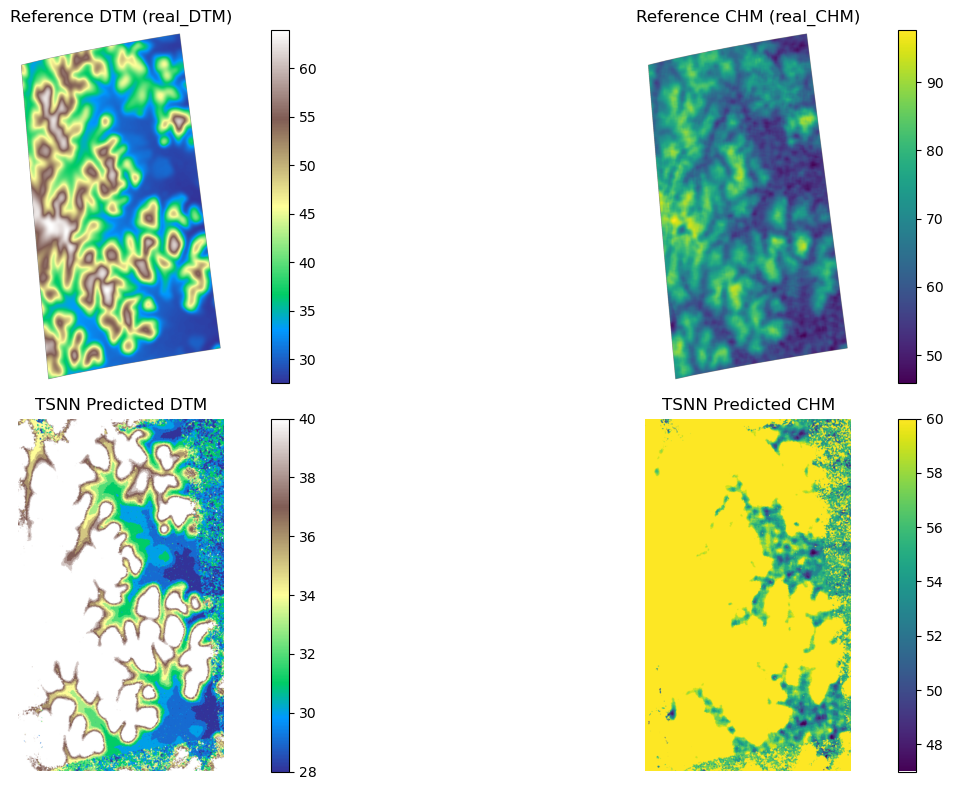

In [48]:

import numpy as np
import matplotlib.pyplot as plt

# --- Step 1: Load .mat reference images ---
mat_data = scipy.io.loadmat('DataSets/dataset_Guiana_6FPimages_Pband.mat')
CHM = mat_data['CHM']
DTM = mat_data['DTM']
real_DTM = DTM + 25
real_CHM = DTM + CHM + 25


# --- Step 5: Visualize ---
plt.figure(figsize=(16, 8))

plt.subplot(2, 2, 1)
plt.imshow(real_DTM, cmap='terrain')
plt.title('Reference DTM (real_DTM)')
plt.axis('off')
plt.colorbar()

plt.subplot(2, 2, 2)
plt.imshow(real_CHM, cmap='viridis')
plt.title('Reference CHM (real_CHM)')
plt.axis('off')
plt.colorbar()

plt.subplot(2, 2, 3)
plt.imshow(pred_g, cmap='terrain')
plt.title('TSNN Predicted DTM')
plt.axis('off')
plt.colorbar()

plt.subplot(2, 2, 4)
plt.imshow(pred_c, cmap='viridis')  
plt.title('TSNN Predicted CHM')
plt.axis('off')
plt.colorbar()



plt.tight_layout()
#plt.savefig("test/TSNN_DTM_CHM_pred.png", dpi=300)
plt.show()



In [43]:
row = H // 2   # middle row

# Ground truth
gt_chm_line = CHM_real[row, :]
gt_dtm_line = DTM_real[row, :]

# CNN
cnn_chm_line = CNN_CHM_real[row, :]
cnn_dtm_line = CNN_DTM_real[row, :]

# MUSIC (average or specific pol)
music_chm_line = MUSIC_chm_raw[row, :]
music_dtm_line = MUSIC_dtm_raw[row, :]

# CAPON
capon_chm_line = CAPON_chm_raw[row, :]
capon_dtm_line = CAPON_dtm_raw[row, :]

# TSNN
tsnn_chm_line = (pred_c[row, :] + 0.5)  
tsnn_dtm_line = (pred_g[row, :] + 0.5)


## Plotting Visual Line for all choosing the middle row in the data

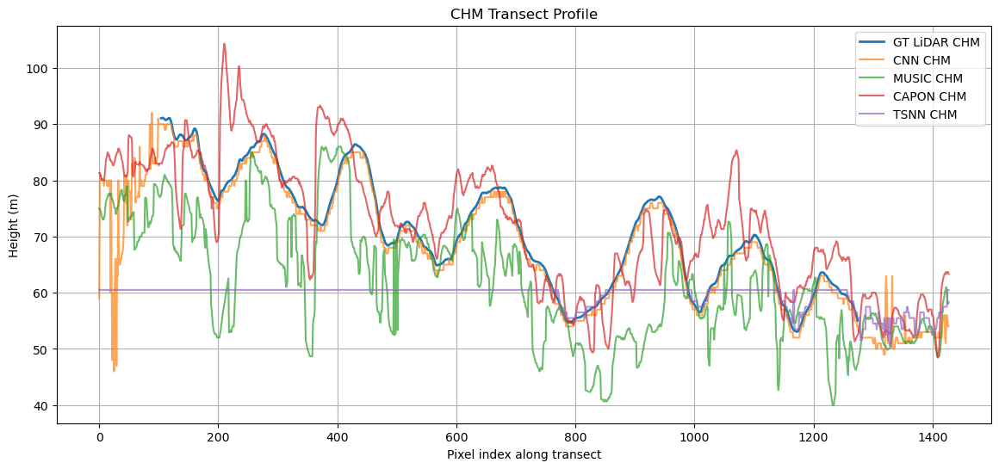

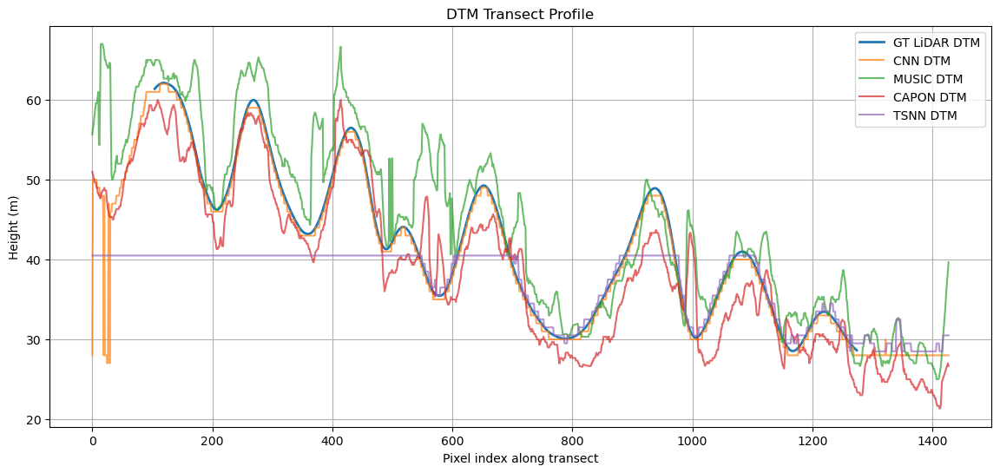

In [44]:
import matplotlib.pyplot as plt

x_axis = np.arange(W)  # pixel positions along the row

# --- CHM profile ---
plt.figure(figsize=(14,6))
plt.plot(x_axis, gt_chm_line, label="GT LiDAR CHM", linewidth=2)
plt.plot(x_axis, cnn_chm_line, label="CNN CHM", alpha=0.7)
plt.plot(x_axis, music_chm_line, label="MUSIC CHM", alpha=0.7)
plt.plot(x_axis, capon_chm_line, label="CAPON CHM", alpha=0.7)
plt.plot(x_axis, tsnn_chm_line, label="TSNN CHM", alpha=0.7)
plt.xlabel("Pixel index along transect")
plt.ylabel("Height (m)")
plt.title("CHM Transect Profile")
plt.legend()
plt.grid(True)
plt.show()

# --- DTM profile ---
plt.figure(figsize=(14,6))
plt.plot(x_axis, gt_dtm_line, label="GT LiDAR DTM", linewidth=2)
plt.plot(x_axis, cnn_dtm_line, label="CNN DTM", alpha=0.7)
plt.plot(x_axis, music_dtm_line, label="MUSIC DTM", alpha=0.7)
plt.plot(x_axis, capon_dtm_line, label="CAPON DTM", alpha=0.7)
plt.plot(x_axis, tsnn_dtm_line, label="TSNN DTM", alpha=0.7)
plt.xlabel("Pixel index along transect")
plt.ylabel("Height (m)")
plt.title("DTM Transect Profile")
plt.legend()
plt.grid(True)
plt.show()


In [47]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

# === Utility functions ===
def compute_errors(pred, gt):
    mask = ~np.isnan(gt)
    if mask.sum() == 0:
        return {"rmse": np.nan, "mae": np.nan, "bias": np.nan}
    diff = pred[mask] - gt[mask]
    rmse = np.sqrt(np.mean(diff**2))
    mae  = np.mean(np.abs(diff))
    bias = np.mean(diff)
    return {"rmse": rmse, "mae": mae, "bias": bias}

def plot_transect(gt_line, preds_dict, title, save_path):
    x_axis = np.arange(len(gt_line))
    plt.figure(figsize=(14,6))
    plt.plot(x_axis, gt_line, label="GT LiDAR", linewidth=2)
    for k,v in preds_dict.items():
        plt.plot(x_axis, v, label=k, alpha=0.8)
    plt.xlabel("Pixel index along transect")
    plt.ylabel("Height (m)")
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(save_path, dpi=200)
    plt.close()

# === Choose transect (middle row) ===
row = H // 2   # middle row

# Ground truth
gt_chm_line = CHM_real[row, :]
gt_dtm_line = DTM_real[row, :]

# CNN
cnn_chm_line = CNN_CHM_real[row, :]
cnn_dtm_line = CNN_DTM_real[row, :]

# MUSIC
music_chm_line = MUSIC_chm_raw[row, :]
music_dtm_line = MUSIC_dtm_raw[row, :]

# CAPON
capon_chm_line = CAPON_chm_raw[row, :]
capon_dtm_line = CAPON_dtm_raw[row, :]

# TSNN (preds are class indices, shift +0.5 to get bin centers)
tsnn_chm_line = pred_c[row, :] + 0.5
tsnn_dtm_line = pred_g[row, :] + 0.5

# === Save results ===
out_dir = "test/transect_results"
os.makedirs(out_dir, exist_ok=True)

# CHM transect
plot_transect(gt_chm_line, {
    "M-Unet CHM": cnn_chm_line,
    "MUSIC CHM": music_chm_line,
    "CAPON CHM": capon_chm_line,
    "TSNN CHM": tsnn_chm_line
}, "CHM Transect Profile", os.path.join(out_dir, "transect_chm.png"))

# DTM transect
plot_transect(gt_dtm_line, {
    "M-Unet DTM": cnn_dtm_line,
    "MUSIC DTM": music_dtm_line,
    "CAPON DTM": capon_dtm_line,
    "TSNN DTM": tsnn_dtm_line
}, "DTM Transect Profile", os.path.join(out_dir, "transect_dtm.png"))

# === Compute errors ===
records = []
for name, pred in {
    "M-Unet CHM": cnn_chm_line,
    "MUSIC CHM": music_chm_line,
    "CAPON CHM": capon_chm_line,
    "TSNN CHM": tsnn_chm_line
}.items():
    e = compute_errors(pred, gt_chm_line)
    records.append({"Model": name, "Type": "CHM", **e})

for name, pred in {
    "M-Unet DTM": cnn_dtm_line,
    "MUSIC DTM": music_dtm_line,
    "CAPON DTM": capon_dtm_line,
    "TSNN DTM": tsnn_dtm_line
}.items():
    e = compute_errors(pred, gt_dtm_line)
    records.append({"Model": name, "Type": "DTM", **e})

# Save table
df = pd.DataFrame(records)
df.to_csv(os.path.join(out_dir, "transect_errors.csv"), index=False)
print("Saved plots and errors to:", out_dir)
print(df)


Saved plots and errors to: test/transect_results
        Model Type       rmse        mae       bias
0  M-Unet CHM  CHM   1.087065   1.007521  -1.007521
1   MUSIC CHM  CHM  12.306924  10.096227  -8.913442
2   CAPON CHM  CHM   7.187085   5.553747   2.200848
3    TSNN CHM  CHM  14.268574  11.158129 -10.904617
4  M-Unet DTM  DTM   0.577436   0.499076  -0.498433
5   MUSIC DTM  DTM   5.541764   3.946095   3.360519
6   CAPON DTM  DTM   3.988661   3.410303  -2.259891
7    TSNN DTM  DTM   7.833757   4.959007  -4.385282


# Display ALL together

GT shapes: (2450, 1428) (2450, 1428)
Loaded CNN preds from: predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz
Using in-memory pred_c / pred_g for TSNN
Heuristic: CNN CHM looks relative; will convert to absolute using SHIFT (+25).
MUSIC shapes: (2450, 1428)
CAPON shapes: (2450, 1428)
Will display CHM: ['GT', 'CNN', 'TSNN', 'MUSIC', 'CAPON']
Will display DTM: ['GT', 'CNN', 'TSNN', 'MUSIC', 'CAPON']


/tmp/ipykernel_2222/1751816511.py:230: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0,0,1,0.96])


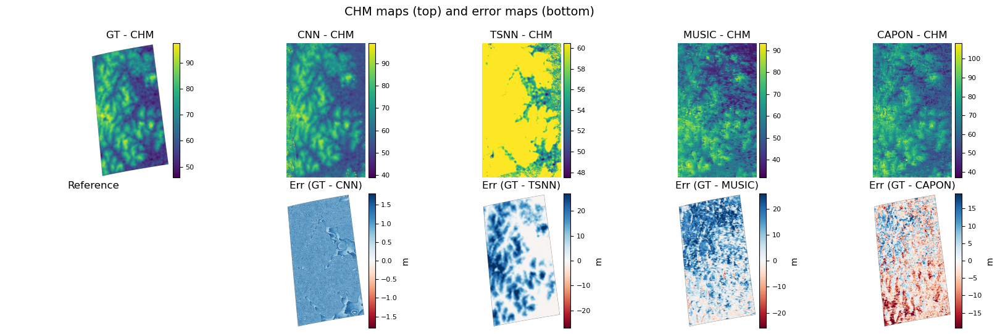

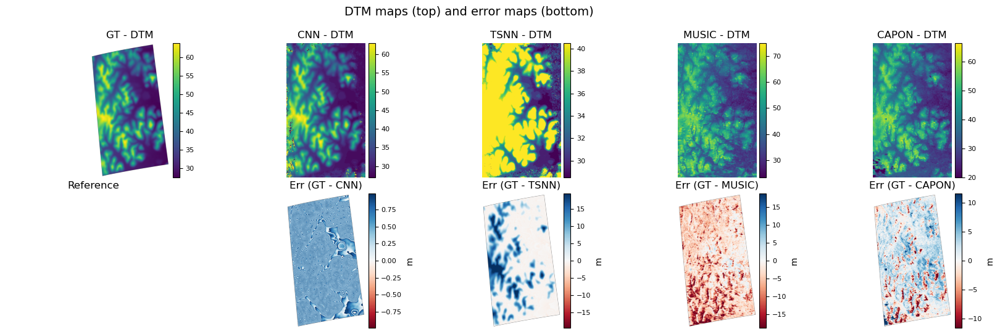

Saved montage to: test/test12/overview_CHM_DTM_no_clip.png
Saved metrics CSV to: test/test12/comparison_metrics_chm_dtm_canopy.csv


,source,variable,reference,rmse,mae,bias,count
0,GT,CHM,GT_real,0.000000,0.000000,0.000000,2555060
1,CNN,CHM,GT_real,1.079259,0.997777,-0.997712,2555060
2,TSNN,CHM,GT_real,12.275260,9.185355,-8.905140,2555060
3,MUSIC,CHM,GT_real,12.614684,10.033870,-8.838491,2555060
4,CAPON,CHM,GT_real,7.649497,5.893505,1.673226,2555060
5,GT,DTM,GT_real,0.000000,0.000000,0.000000,2555060
6,CNN,DTM,GT_real,0.577758,0.499935,-0.499213,2555060
7,TSNN,DTM,GT_real,7.114720,4.355483,-3.771540,2555060
8,MUSIC,DTM,GT_real,6.987821,5.133546,4.943580,2555060
9,CAPON,DTM,GT_real,4.114496,3.011088,-0.965534,2555060


Done. If a method is missing from the visuals, check the file paths and rerun this cell.


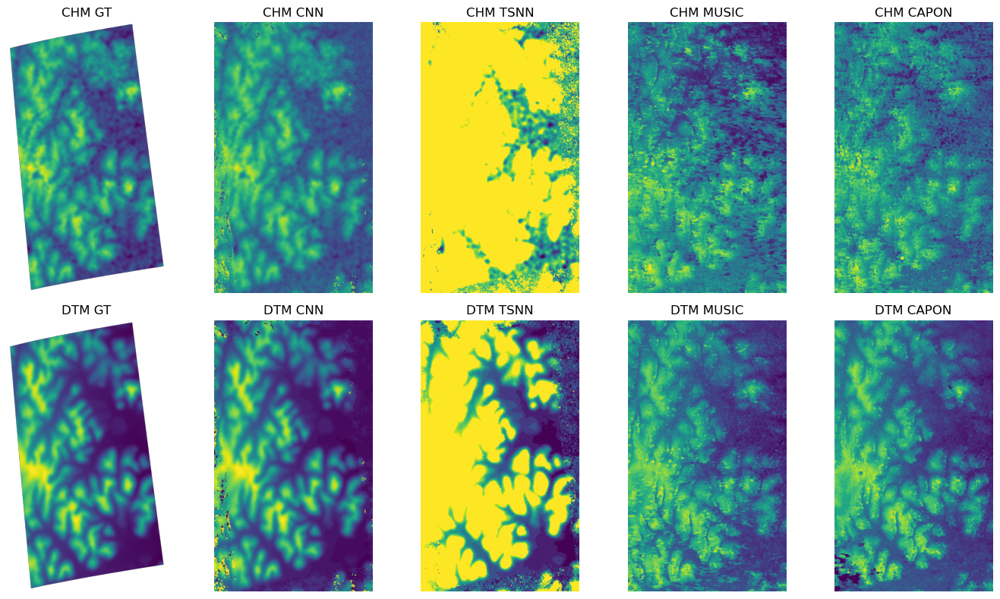

In [62]:
# ---------- Visualization & metrics cell (paste-run in your notebook) ----------
import os, math
import numpy as np
import scipy.io
import h5py
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from scipy.ndimage import zoom
from IPython.display import display

# --- USER PATHS: edit if necessary ---
GT_MAT     = "DataSets/dataset_Guiana_6FPimages_Pband.mat"   # GT LiDAR (you used this)
PRED_NPZ1  = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"                      # possible CNN preds
PRED_NPZ2  = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"
TSNN_NPZ   = "TSNN_Model/tsnn_preds.npz"                             # optional TSNN saved preds (pred_c,pred_g)
MUSIC_MAT  = "TM/MUSIC_Height_FullScene.mat"
CAPON_MAT  = "TM/CAPON_Height_FullScene.mat"
OUT_DIR    = "test/test12"
os.makedirs(OUT_DIR, exist_ok=True)

# ---------- PARAMETERS ----------
SHIFT = 25.0   # +25 as in your dataset (GT real heights)
# ---------- helpers ----------
def rmse_mae_bias(pred, gt):
    mask = np.isfinite(pred) & np.isfinite(gt)
    if mask.sum() == 0:
        return (np.nan, np.nan, np.nan, 0)
    err = pred[mask].astype(np.float64) - gt[mask].astype(np.float64)
    return (math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(mask.sum()))

def load_mat_v73(path):
    if not os.path.exists(path):
        return {}
    d = {}
    with h5py.File(path, 'r') as f:
        for k in f.keys():
            try:
                d[k] = np.array(f[k])
            except Exception:
                pass
    return d

def avg_chm_dtm_from_matdict(d):
    if not d:
        return None, None
    keys = list(d.keys())
    chm_keys = [k for k in keys if 'chm' in k.lower()]
    dtm_keys = [k for k in keys if 'dtm' in k.lower()]
    def avg_list(kl):
        if not kl: return None
        arrs = []
        ref = None
        for k in kl:
            try:
                a = np.array(d[k], dtype=np.float64)
            except Exception:
                continue
            if ref is None: ref = a.shape
            if a.shape == ref:
                arrs.append(a)
            elif a.T.shape == ref:
                arrs.append(a.T)
            elif a.size == ref[0]*ref[1]:
                arrs.append(a.reshape(ref))
        if not arrs: return None
        return np.mean(np.stack(arrs, axis=0), axis=0)
    return avg_list(chm_keys), avg_list(dtm_keys)

def align_to_ref(a, ref):
    if a is None: return None
    a = np.array(a, dtype=np.float64)
    if a.shape == ref.shape: return a
    if a.T.shape == ref.shape: return a.T
    if a.size == ref.size: return a.reshape(ref.shape)
    return zoom(a, (ref.shape[0]/a.shape[0], ref.shape[1]/a.shape[1]), order=1)

# ---------- 1) Load GT & build GT_real ----------
if not os.path.exists(GT_MAT):
    raise FileNotFoundError(f"GT MAT not found: {GT_MAT}")
mat = scipy.io.loadmat(GT_MAT)
CHM_rel = np.array(mat['CHM'], dtype=np.float64)   # relative canopy
DTM_rel = np.array(mat['DTM'], dtype=np.float64)   # relative ground
H, W = CHM_rel.shape
DTM_real = DTM_rel + SHIFT                # absolute ground
CHM_real = DTM_rel + CHM_rel + SHIFT      # absolute canopy (GT)

print("GT shapes:", CHM_rel.shape, DTM_rel.shape)

# ---------- 2) Load CNN predictions (try multiple NPZs) ----------
cnn_chm = None; cnn_dtm = None
for p in (PRED_NPZ1, PRED_NPZ2):
    if os.path.exists(p):
        d = dict(np.load(p, allow_pickle=True))
        # prefer continuous preds
        cnn_chm = d.get('pred_chm_cont', d.get('pred_chm_map', None))
        cnn_dtm = d.get('pred_dtm_cont', d.get('pred_dtm_map', None))
        print("Loaded CNN preds from:", p)
        break

if cnn_chm is None or cnn_dtm is None:
    print("CNN pred npz not found or missing keys. Expected pred_chm_cont/pred_dtm_cont or pred_*_map in:", PRED_NPZ1, PRED_NPZ2)
else:
    cnn_chm = np.array(cnn_chm, dtype=np.float64)
    cnn_dtm = np.array(cnn_dtm, dtype=np.float64)
    cnn_chm = align_to_ref(cnn_chm, CHM_real)
    cnn_dtm = align_to_ref(cnn_dtm, DTM_real)

# ---------- 3) Load TSNN predictions (if you saved them) ----------
tsnn_c = None; tsnn_g = None
if os.path.exists(TSNN_NPZ):
    dts = dict(np.load(TSNN_NPZ, allow_pickle=True))
    tsnn_c = dts.get('pred_c', None)
    tsnn_g = dts.get('pred_g', None)
    if tsnn_c is not None:
        tsnn_c = np.array(tsnn_c, dtype=np.float64).reshape(H, W)
    if tsnn_g is not None:
        tsnn_g = np.array(tsnn_g, dtype=np.float64).reshape(H, W)
    print("Loaded TSNN preds from:", TSNN_NPZ)
else:
    # pred_c / pred_g arrays in memory
    if 'pred_c' in globals() and 'pred_g' in globals():
        pc = globals()['pred_c']; pg = globals()['pred_g']
        try:
            import torch
            if isinstance(pc, torch.Tensor): pc = pc.cpu().numpy()
            if isinstance(pg, torch.Tensor): pg = pg.cpu().numpy()
        except Exception:
            pass
        tsnn_c = np.array(pc, dtype=np.float64).reshape(H, W)
        tsnn_g = np.array(pg, dtype=np.float64).reshape(H, W)
        print("Using in-memory pred_c / pred_g for TSNN")
    else:
        print("No TSNN preds found (set TSNN_NPZ or provide pred_c/pred_g in memory).")

#  TSNN and MUSIC/CAPON are absolute. CNN is relative/ absolute but when adding 25 offset.
CNN_is_relative = False
if cnn_chm is not None:
    # if max CHM ~< 60 and min >=0 assume relative
    if np.nanmax(cnn_chm) <= 60 and np.nanmin(cnn_chm) >= -1e-6:
        CNN_is_relative = True
        print("Heuristic: CNN CHM looks relative; will convert to absolute using SHIFT (+25).")
    else:
        print("Heuristic: CNN CHM looks absolute; will not add SHIFT.")

if cnn_chm is not None:
    if CNN_is_relative:
        CNN_DTM_real = cnn_dtm + SHIFT
        CNN_CHM_real = cnn_dtm + cnn_chm + SHIFT
    else:
        # assume cnn_chm/dtm are already absolute (like MUSIC/CAPON)
        CNN_DTM_real = cnn_dtm
        CNN_CHM_real = cnn_chm

# ---------- 4) Load MUSIC/CAPON, average keys and align ----------
music_dict = load_mat_v73(MUSIC_MAT)
capon_dict = load_mat_v73(CAPON_MAT)
MUSIC_chm_raw, MUSIC_dtm_raw = avg_chm_dtm_from_matdict(music_dict)
CAPON_chm_raw, CAPON_dtm_raw = avg_chm_dtm_from_matdict(capon_dict)
MUSIC_chm_raw = align_to_ref(MUSIC_chm_raw, CHM_real) if MUSIC_chm_raw is not None else None
MUSIC_dtm_raw = align_to_ref(MUSIC_dtm_raw, DTM_real) if MUSIC_dtm_raw is not None else None
CAPON_chm_raw = align_to_ref(CAPON_chm_raw, CHM_real) if CAPON_chm_raw is not None else None
CAPON_dtm_raw = align_to_ref(CAPON_dtm_raw, DTM_real) if CAPON_dtm_raw is not None else None

print("MUSIC shapes:", None if MUSIC_chm_raw is None else MUSIC_chm_raw.shape)
print("CAPON shapes:", None if CAPON_chm_raw is None else CAPON_chm_raw.shape)

# ---------- 5) Build display dictionaries (GT_real for reference) ----------
display_chm = {'GT': CHM_real}
display_dtm = {'GT': DTM_real}
if 'CNN_CHM_real' in locals():
    display_chm['CNN'] = CNN_CHM_real
    display_dtm['CNN'] = CNN_DTM_real
if tsnn_c is not None:
    # TSNN predicted classes -> convert to continuous centers if integer classes
    if np.allclose(np.round(tsnn_c), tsnn_c): tsnn_chm_cont = tsnn_c + 0.5
    else: tsnn_chm_cont = tsnn_c
    if np.allclose(np.round(tsnn_g), tsnn_g): tsnn_dtm_cont = tsnn_g + 0.5
    else: tsnn_dtm_cont = tsnn_g
    display_chm['TSNN'] = tsnn_chm_cont
    display_dtm['TSNN'] = tsnn_dtm_cont
if MUSIC_chm_raw is not None:
    display_chm['MUSIC'] = MUSIC_chm_raw
    display_dtm['MUSIC'] = MUSIC_dtm_raw
if CAPON_chm_raw is not None:
    display_chm['CAPON'] = CAPON_chm_raw
    display_dtm['CAPON'] = CAPON_dtm_raw

print("Will display CHM:", list(display_chm.keys()))
print("Will display DTM:", list(display_dtm.keys()))

# ---------- 6) Display function (no forced vmin/vmax on maps; colorbars shown) ----------
def display_maps_and_errors(methods_dict, GT_arr, varname="CHM"):
    names = list(methods_dict.keys())
    n = len(names)
    fig = plt.figure(figsize=(4*n, 6))
    gs = gridspec.GridSpec(2, n, height_ratios=[1,1], hspace=0.12, wspace=0.12)

    # top: maps with their own colormaps/scales
    for i, name in enumerate(names):
        ax = fig.add_subplot(gs[0, i])
        arr = methods_dict[name]
        im = ax.imshow(arr)            # no global vmin/vmax
        ax.set_title(f"{name} - {varname}")
        ax.axis('off')
        cb = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        cb.ax.tick_params(labelsize=8)

    # bottom: symmetric error maps (GT - method)
    for i, name in enumerate(names):
        ax = fig.add_subplot(gs[1, i])
        if name == 'GT':
            ax.axis('off'); ax.set_title("Reference"); continue
        arr = methods_dict[name]
        err = GT_arr - arr
        # robust symmetric limits
        mag = np.nanpercentile(np.abs(err), 98)
        if (not np.isfinite(mag)) or mag == 0:
            mag = np.nanpercentile(np.abs(err[~np.isnan(err)]), 90) if np.any(~np.isnan(err)) else 1.0
        plot_vmin, plot_vmax = -mag, mag
        im = ax.imshow(err, cmap='RdBu', vmin=plot_vmin, vmax=plot_vmax)
        ax.set_title(f"Err (GT - {name})")
        ax.axis('off')
        cb = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        cb.set_label("m")
        cb.ax.tick_params(labelsize=8)

    plt.suptitle(f"{varname} maps (top) and error maps (bottom)", fontsize=14)
    plt.tight_layout(rect=[0,0,1,0.96])
    plt.show()

# Display CHM and DTM maps
display_maps_and_errors(display_chm, CHM_real, varname="CHM")
display_maps_and_errors(display_dtm, DTM_real, varname="DTM")

# ---------- 7) Save montage (small overview) ----------
try:
    montage_path = os.path.join(OUT_DIR, "overview_CHM_DTM_no_clip.png")
    fig2 = plt.figure(figsize=(14,8))
    keys_chm = list(display_chm.keys())[:5]
    keys_dtm = list(display_dtm.keys())[:5]
    for i, k in enumerate(keys_chm):
        ax = fig2.add_subplot(2, 5, i+1)
        ax.imshow(display_chm[k]); ax.set_title(f"CHM {k}"); ax.axis('off')
    for i, k in enumerate(keys_dtm):
        ax = fig2.add_subplot(2, 5, 5 + i + 1)
        ax.imshow(display_dtm[k]); ax.set_title(f"DTM {k}"); ax.axis('off')
    plt.tight_layout()
    plt.savefig(montage_path, dpi=160, bbox_inches='tight')
    print("Saved montage to:", montage_path)
except Exception as e:
    print("Montage save failed:", e)

# ---------- 8) Compute metrics and save CSV ----------
rows = []
def add_metric_row(source, var, ref_name, ref_arr, pred_arr):
    if pred_arr is None: return
    r = rmse_mae_bias(pred_arr, ref_arr)
    rows.append({"source":source, "variable":var, "reference":ref_name,
                 "rmse":r[0], "mae":r[1], "bias":r[2], "count":r[3]})

# CHM & DTM comparisons vs GT_real
for name, arr in display_chm.items():
    add_metric_row(name, "CHM", "GT_real", CHM_real, arr)
for name, arr in display_dtm.items():
    add_metric_row(name, "DTM", "GT_real", DTM_real, arr)

# Canopy (CHM - DTM) comparisons vs GT canopy (CHM_real - DTM_real)
GT_canopy = CHM_real - DTM_real
for name in set(display_chm.keys()) & set(display_dtm.keys()):
    pred_canopy = display_chm[name] - display_dtm[name]
    add_metric_row(name, "Canopy", "GT_canopy", GT_canopy, pred_canopy)

df = pd.DataFrame(rows)
csv_path = os.path.join(OUT_DIR, "comparison_metrics_chm_dtm_canopy.csv")
df.to_csv(csv_path, index=False)
print("Saved metrics CSV to:", csv_path)
display(df)

print("Saved")


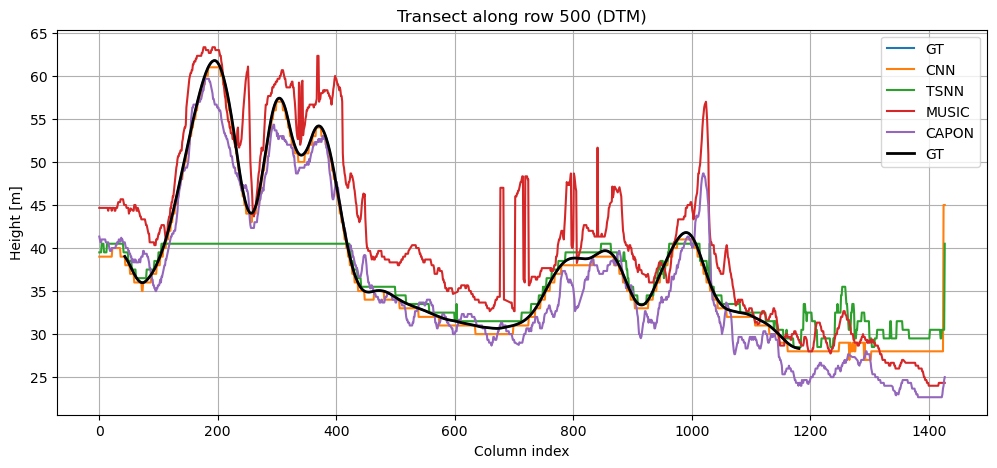

In [71]:
# ---------- Dynamic transect line plot ----------
import matplotlib.pyplot as plt

def plot_transect(row_idx=None,save_path = None, var="CHM", also_csv=False):
    """
    row_idx : int or None
        If None, will use middle row. Otherwise plot the given row index.
    var : "CHM" or "DTM"
    """
    if var not in ["CHM","DTM"]:
        raise ValueError("var must be 'CHM' or 'DTM'")

    ref = CHM_real if var=="CHM" else DTM_real
    names = list(display_chm.keys()) if var=="CHM" else list(display_dtm.keys())
    methods_dict = display_chm if var=="CHM" else display_dtm

    if row_idx is None:
        row_idx = ref.shape[0]//2

    plt.figure(figsize=(12,5))
    for name in names:
        arr = methods_dict[name]
        if arr is None: continue
        plt.plot(arr[row_idx, :], label=name)

    plt.plot(ref[row_idx, :], label="GT", color="black", linewidth=2)
    plt.title(f"Transect along row {row_idx} ({var})")
    plt.xlabel("Column index")
    plt.ylabel("Height [m]")
    plt.legend()
    plt.grid(True)
    plt.show()

# Example usage:
# plot_transect(150, "CHM")
plot_transect(500, "DTM")
#plot_transect(None, "CHM")   # default: middle row CHM


Saved figure to test/test12/transect_row700_CHM.png


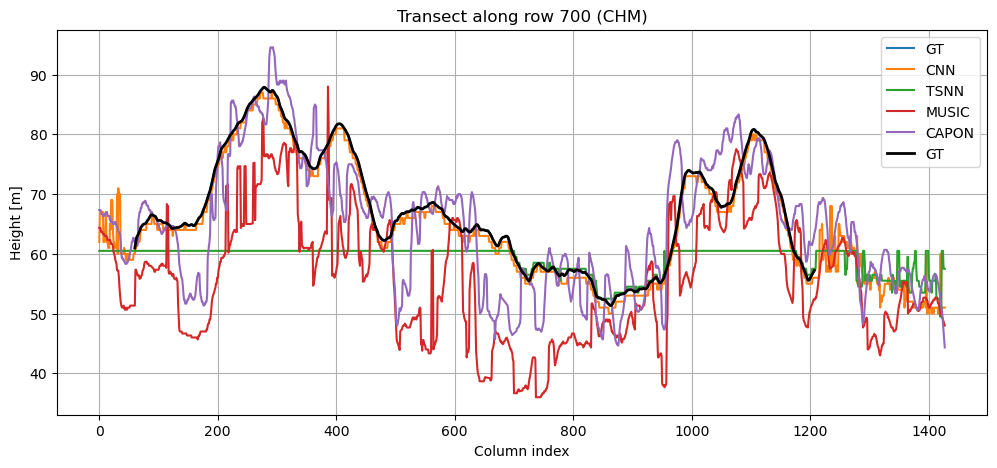

Saved transect data to test/test12/transect_row700_CHM.csv


In [86]:
plot_transect(700, "CHM", save_path="test/test12/transect_row700_CHM.png", also_csv=True)

In [57]:
# Paste into a Jupyter cell and run (edit paths at top if necessary)

import os, math
import numpy as np
import scipy.io
import h5py
import pandas as pd
import matplotlib.pyplot as plt
from scipy.ndimage import zoom

# ========== USER PATHS ==========
GT_MAT    = "DataSets/dataset_Guiana_6FPimages_Pband.mat"   # LiDAR mat (relative CHM, DTM)
PRED_NPZ  = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"                     # CNN preds (map or continuous)
MUSIC_MAT = "TM/MUSIC_Height_FullScene.mat"
CAPON_MAT = "TM/CAPON_Height_FullScene.mat"
OUT_DIR   = "test/FINALvisual_comparison"                          # where outputs are saved
SHIFT     = 25.0   # use to convert GT & CNN (relative -> absolute) if needed

os.makedirs(OUT_DIR, exist_ok=True)

# ========== HELPERS ==========
def load_mat_v73(path):
    if not os.path.exists(path):
        return {}
    out = {}
    with h5py.File(path, 'r') as f:
        for k in f.keys():
            try:
                out[k] = np.array(f[k])
            except Exception:
                pass
    return out

def avg_chm_dtm_from_matdict(d):
    if not d:
        return None, None
    keys = list(d.keys())
    chm_keys = [k for k in keys if 'chm' in k.lower()]
    dtm_keys = [k for k in keys if 'dtm' in k.lower()]
    def avg_list(kl):
        arrs = []
        for k in kl:
            try:
                a = np.array(d[k], dtype=np.float64)
                arrs.append(a)
            except Exception:
                pass
        if not arrs:
            return None
        ref = arrs[0].shape
        arrs2 = []
        for a in arrs:
            if a.shape == ref:
                arrs2.append(a)
            elif a.T.shape == ref:
                arrs2.append(a.T)
            elif a.size == ref[0]*ref[1]:
                arrs2.append(a.reshape(ref))
        if not arrs2:
            arrs2 = arrs
        return np.mean(np.stack(arrs2, axis=0), axis=0)
    return avg_list(chm_keys), avg_list(dtm_keys)

def align_to_ref(a, ref_shape):
    if a is None:
        return None
    a = np.array(a, dtype=np.float64)
    if a.shape == ref_shape:
        return a
    if a.T.shape == ref_shape:
        return a.T
    if a.size == ref_shape[0]*ref_shape[1]:
        return a.reshape(ref_shape)
    # fallback: resize with zoom (may distort aspect slightly)
    return zoom(a, (ref_shape[0]/a.shape[0], ref_shape[1]/a.shape[1]), order=1)

def rmse_mae_bias(pred, gt, mask=None):
    if mask is None:
        mask = np.isfinite(pred) & np.isfinite(gt)
    idx = mask
    if idx.sum() == 0:
        return (np.nan, np.nan, np.nan, 0)
    err = pred[idx].astype(np.float64) - gt[idx].astype(np.float64)
    return (math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(idx.sum()))

def save_map_png(arr, filename, title):
    plt.figure(figsize=(8,6))
    plt.imshow(arr)    # no explicit vmin/vmax or cmap by default (user requested raw display)
    plt.title(title)
    plt.axis('off')
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.savefig(filename, bbox_inches='tight', dpi=150)
    plt.close()

# ========== 1) Load GT (relative) and make absolute =
mat = scipy.io.loadmat(GT_MAT)
GT_CHM = np.array(mat['CHM'], dtype=np.float64)   # relative canopy
GT_DTM = np.array(mat['DTM'], dtype=np.float64)   # relative ground
H, W = GT_CHM.shape
DTM_real = GT_DTM + SHIFT
CHM_real = GT_DTM + GT_CHM + SHIFT
mask_gt = np.isfinite(GT_CHM) & np.isfinite(GT_DTM)
print("GT shapes:", GT_CHM.shape, GT_DTM.shape)

# ========== 2) Load CNN predictions (npz) if present ==========
cnn_chm_rel = cnn_dtm_rel = None
if os.path.exists(PRED_NPZ):
    d = dict(np.load(PRED_NPZ, allow_pickle=True))
    # prefer continuous keys; fallback to maps
    cnn_chm_rel = d.get('pred_chm_cont', d.get('pred_chm_map', None))
    cnn_dtm_rel = d.get('pred_dtm_cont', d.get('pred_dtm_map', None))
    if cnn_chm_rel is not None:
        cnn_chm_rel = np.array(cnn_chm_rel, dtype=np.float64)
    if cnn_dtm_rel is not None:
        cnn_dtm_rel = np.array(cnn_dtm_rel, dtype=np.float64)
    print("Loaded CNN preds from:", PRED_NPZ)

cnn_chm_real = cnn_dtm_real = None
if cnn_chm_rel is not None and cnn_dtm_rel is not None:
    cnn_dtm_real = align_to_ref(cnn_dtm_rel + SHIFT, CHM_real.shape)  # add SHIFT to relative->absolute
    cnn_chm_real = align_to_ref(cnn_dtm_rel + cnn_chm_rel + SHIFT, CHM_real.shape)

# ========== 3) Load MUSIC & CAPON (avg over keys) ==========
music_dict = load_mat_v73(MUSIC_MAT)
capon_dict = load_mat_v73(CAPON_MAT)
music_chm_raw, music_dtm_raw = avg_chm_dtm_from_matdict(music_dict)
capon_chm_raw, capon_dtm_raw = avg_chm_dtm_from_matdict(capon_dict)
music_chm_raw = align_to_ref(music_chm_raw, CHM_real.shape) if music_chm_raw is not None else None
music_dtm_raw = align_to_ref(music_dtm_raw, DTM_real.shape) if music_dtm_raw is not None else None
capon_chm_raw = align_to_ref(capon_chm_raw, CHM_real.shape) if capon_chm_raw is not None else None
capon_dtm_raw = align_to_ref(capon_dtm_raw, DTM_real.shape) if capon_dtm_raw is not None else None

# ========== 4) TSNN: use pred_c / pred_g from notebook globals (or fallback to npz) ==========
tsnn_c = None; tsnn_g = None
g = globals()
# if variables exist in notebook namespace: accept torch tensor or numpy
if 'pred_c' in g and 'pred_g' in g:
    pc = g['pred_c']; pg = g['pred_g']
    # convert torch to numpy if needed
    try:
        import torch
        if isinstance(pc, torch.Tensor):
            pc = pc.cpu().numpy()
        if isinstance(pg, torch.Tensor):
            pg = pg.cpu().numpy()
    except Exception:
        pass
    tsnn_c = np.array(pc, dtype=np.float64)
    tsnn_g = np.array(pg, dtype=np.float64)
    print("Using pred_c / pred_g from notebook globals (shape):", tsnn_c.shape, tsnn_g.shape)
else:
    # optional fallback: load from TSNN NPZ if you later save it to disk
    TSNN_FALLBACK = "TSNN_Model/pred_tsnn.npz"
    if os.path.exists(TSNN_FALLBACK):
        dts = dict(np.load(TSNN_FALLBACK, allow_pickle=True))
        tsnn_c = dts.get('pred_c', None)
        tsnn_g = dts.get('pred_g', None)
        if tsnn_c is not None: tsnn_c = np.array(tsnn_c, dtype=np.float64)
        if tsnn_g is not None: tsnn_g = np.array(tsnn_g, dtype=np.float64)
        print("Loaded TSNN from fallback file:", TSNN_FALLBACK)
    else:
        print("TSNN preds not found in globals and no fallback file.")

# convert class indices -> continuous center (if integer classes)
if tsnn_c is not None and tsnn_g is not None:
    if np.allclose(tsnn_c, np.round(tsnn_c)):
        tsnn_c = tsnn_c + 0.5
    if np.allclose(tsnn_g, np.round(tsnn_g)):
        tsnn_g = tsnn_g + 0.5
    tsnn_chm_real = align_to_ref(tsnn_c, CHM_real.shape)
    tsnn_dtm_real = align_to_ref(tsnn_g, DTM_real.shape)
else:
    tsnn_chm_real = tsnn_dtm_real = None

# ========== 5) Build method dicts & save maps/errors ==========
methods_chm = {'GT': CHM_real}
methods_dtm = {'GT': DTM_real}
if cnn_chm_real is not None: methods_chm['CNN'] = cnn_chm_real; methods_dtm['CNN'] = cnn_dtm_real
if music_chm_raw is not None: methods_chm['MUSIC'] = music_chm_raw; methods_dtm['MUSIC'] = music_dtm_raw
if capon_chm_raw is not None: methods_chm['CAPON'] = capon_chm_raw; methods_dtm['CAPON'] = capon_dtm_raw
if tsnn_chm_real is not None: methods_chm['TSNN'] = tsnn_chm_real; methods_dtm['TSNN'] = tsnn_dtm_real

print("Methods to compare (CHM):", list(methods_chm.keys()))
print("Methods to compare (DTM):", list(methods_dtm.keys()))

saved_files = []
for name, arr in methods_chm.items():
    fn = os.path.join(OUT_DIR, f"CHM_{name}.png")
    save_map_png(arr, fn, f"CHM - {name}")
    saved_files.append(fn)
    if name != 'GT':
        err = CHM_real - arr
        fn2 = os.path.join(OUT_DIR, f"CHM_err_{name}.png")
        save_map_png(err, fn2, f"Error CHM (GT - {name})")
        saved_files.append(fn2)

for name, arr in methods_dtm.items():
    fn = os.path.join(OUT_DIR, f"DTM_{name}.png")
    save_map_png(arr, fn, f"DTM - {name}")
    saved_files.append(fn)
    if name != 'GT':
        err = DTM_real - arr
        fn2 = os.path.join(OUT_DIR, f"DTM_err_{name}.png")
        save_map_png(err, fn2, f"Error DTM (GT - {name})")
        saved_files.append(fn2)

# ========== 6) Compute metrics and save CSV ==========
rows = []
for name in sorted(methods_chm.keys()):
    if name == 'GT': continue
    pred = methods_chm[name]
    rmse, mae, bias, cnt = rmse_mae_bias(pred, CHM_real, mask=mask_gt)
    rows.append({'method': name, 'variable': 'CHM', 'rmse': rmse, 'mae': mae, 'bias': bias, 'count': cnt})
for name in sorted(methods_dtm.keys()):
    if name == 'GT': continue
    pred = methods_dtm[name]
    rmse, mae, bias, cnt = rmse_mae_bias(pred, DTM_real, mask=mask_gt)
    rows.append({'method': name, 'variable': 'DTM', 'rmse': rmse, 'mae': mae, 'bias': bias, 'count': cnt})

df = pd.DataFrame(rows)
csv_path = os.path.join(OUT_DIR, "comparison_metrics.csv")
df.to_csv(csv_path, index=False)
print("Saved metrics CSV:", csv_path)
print(df)

print("\nSaved files:")
for f in saved_files:
    print(" -", f)


GT shapes: (2450, 1428) (2450, 1428)
Loaded CNN preds from: predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz
Using pred_c / pred_g from notebook globals (shape): (2450, 1428) (2450, 1428)
Methods to compare (CHM): ['GT', 'CNN', 'MUSIC', 'CAPON', 'TSNN']
Methods to compare (DTM): ['GT', 'CNN', 'MUSIC', 'CAPON', 'TSNN']
Saved metrics CSV: test/FINALvisual_comparison/comparison_metrics.csv
  method variable       rmse        mae      bias    count
0  CAPON      CHM   7.649497   5.893505  1.673226  2555060
1    CNN      CHM   1.079259   0.997777 -0.997712  2555060
2  MUSIC      CHM  12.614684  10.033870 -8.838491  2555060
3   TSNN      CHM  12.275260   9.185355 -8.905140  2555060
4  CAPON      DTM   4.114496   3.011088 -0.965534  2555060
5    CNN      DTM   0.577758   0.499935 -0.499213  2555060
6  MUSIC      DTM   6.987821   5.133546  4.943580  2555060
7   TSNN      DTM   7.114720   4.355483 -3.771540  2555060

Saved files:
 - test/FINALvisual_comparison/CHM_GT.png
 - test

Using in-memory CHM_real / DTM_real / methods_* variables.
Loaded TSNN from pred_c / pred_g
Final methods CHM: ['GT', 'CNN', 'MUSIC', 'CAPON', 'TSNN']
Final methods DTM: ['GT', 'CNN', 'MUSIC', 'CAPON', 'TSNN']


/tmp/ipykernel_2222/3593473941.py:193: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0,0,1,0.96])


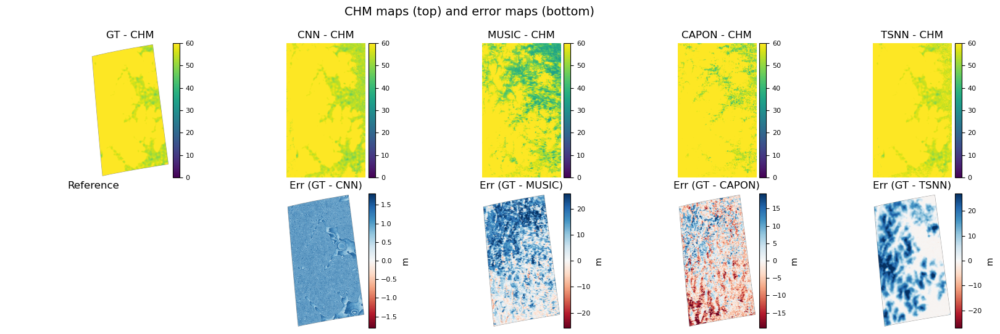

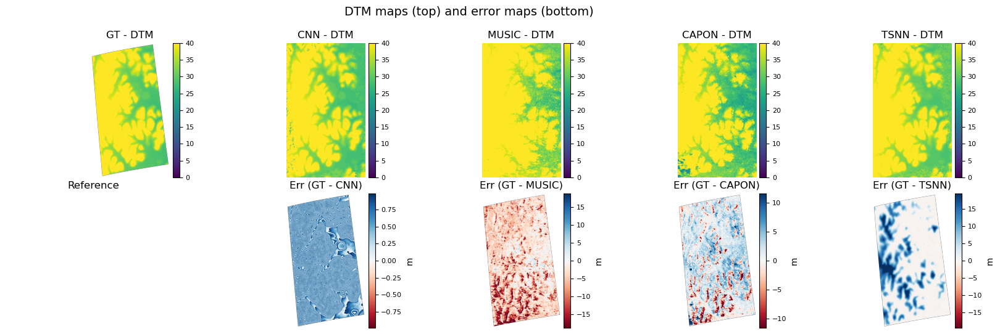

Displaying in-memory metrics dataframe 'df':


,method,variable,rmse,mae,bias,count
0,CAPON,CHM,7.649497,5.893505,1.673226,2555060
1,CNN,CHM,1.079259,0.997777,-0.997712,2555060
2,MUSIC,CHM,12.614684,10.033870,-8.838491,2555060
3,TSNN,CHM,12.275260,9.185355,-8.905140,2555060
4,CAPON,DTM,4.114496,3.011088,-0.965534,2555060
5,CNN,DTM,0.577758,0.499935,-0.499213,2555060
6,MUSIC,DTM,6.987821,5.133546,4.943580,2555060
7,TSNN,DTM,7.114720,4.355483,-3.771540,2555060


Montage save failed: [Errno 2] No such file or directory: 'test/FINAL_ALL_PAPER/combined_CHM_DTM_overview.png'
saved


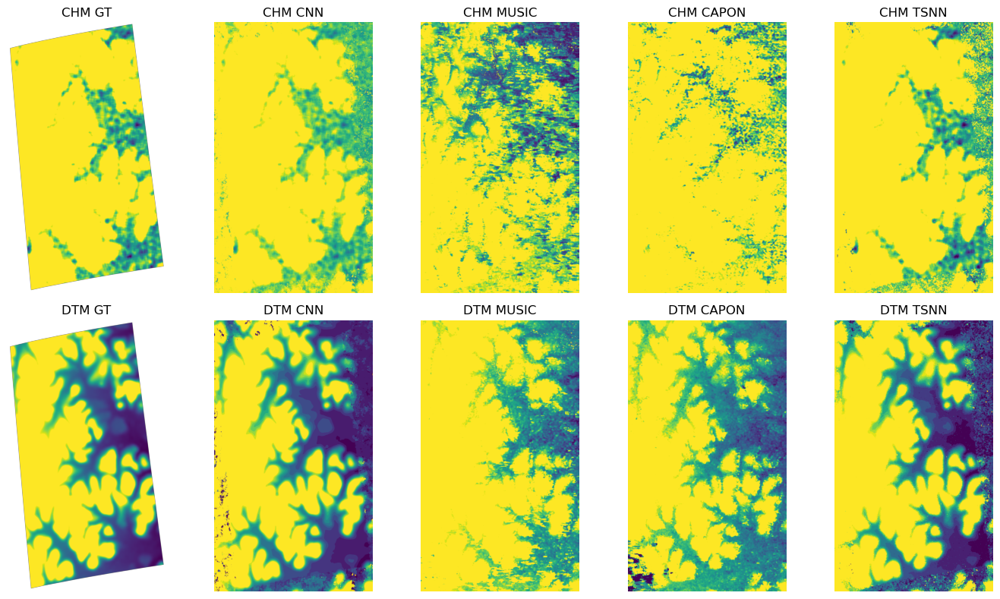

In [58]:
# Visualization cell — paste into your notebook and run
import os, math
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib import gridspec
from scipy.ndimage import zoom
from IPython.display import display, HTML

# --- Edit if your outputs folder is different ---
OUT_DIR = "test/FINAL_ALL_PAPER"   # <- change this if you saved to a different folder

# --- Helper to align arrays to GT shape if necessary ---
def align_to_shape(a, shape):
    if a is None:
        return None
    a = np.array(a, dtype=np.float64)
    if a.shape == shape:
        return a
    if a.T.shape == shape:
        return a.T
    if a.size == shape[0]*shape[1]:
        return a.reshape(shape)
    return zoom(a, (shape[0]/a.shape[0], shape[1]/a.shape[1]), order=1)

# --- Try to reuse in-memory variables; else load from disk ---
use_disk = False
try:
    CHM_real  # if this exists we use it
    print("Using in-memory CHM_real / DTM_real / methods_* variables.")
    have_memory = True
except Exception:
    have_memory = False
    use_disk = True

if not have_memory:
    # try load from files
    if os.path.exists(os.path.join(OUT_DIR, "predictions_test.npz")):
        # this file likely contains pred maps but not CHM_real — load GT from MAT
        print("Loading predictions_test.npz and GT from MAT if available.")
    else:
        print("In-memory variables not found; attempting to load from OUT_DIR files.")

# Load GT from .mat if not in memory
if not have_memory:
    import scipy.io
    MAT_PATH = "Datasets_TomoSar/dataset_Guiana_6FPimages_Pband.mat"
    if os.path.exists(MAT_PATH):
        mat = scipy.io.loadmat(MAT_PATH)
        GT_CHM = np.array(mat['CHM'], dtype=np.float64)
        GT_DTM = np.array(mat['DTM'], dtype=np.float64)
        SHIFT = 25.0
        DTM_real = GT_DTM + SHIFT
        CHM_real = GT_DTM + GT_CHM + SHIFT
        mask_gt = np.isfinite(GT_CHM) & np.isfinite(GT_DTM)
        H, W = CHM_real.shape
        print("Loaded GT from mat:", MAT_PATH, "shape:", CHM_real.shape)
    else:
        raise FileNotFoundError("GT MAT file not found and CHM_real not in memory. Please set MAT_PATH or provide variables.")

# methods_chm / methods_dtm: try memory then try to reconstruct from saved PNG/NPZ
if 'methods_chm' in globals():
    mc = methods_chm
    md = methods_dtm
else:
    # try to load predictions npz or images — prefer continuous maps if saved earlier
    mc = {}
    md = {}
    # attempt to load saved predictions npz (from earlier cell)
    npz_pred = os.path.join(OUT_DIR, "predictions_test.npz")
    if os.path.exists(npz_pred):
        arrs = dict(np.load(npz_pred, allow_pickle=True))
        if 'pred_chm_map' in arrs and 'pred_dtm_map' in arrs:
            pc = arrs['pred_chm_map']
            pdm = arrs['pred_dtm_map']
            mc['CNN'] = align_to_shape(pc, CHM_real.shape)
            md['CNN'] = align_to_shape(pdm, DTM_real.shape)
            print("Loaded CNN predictions from", npz_pred)
    # attempt to load MUSIC/CAPON MATs avg keys
    def load_mat_avg(path):
        if not os.path.exists(path):
            return None, None
        import h5py
        d = {}
        with h5py.File(path, 'r') as f:
            for k in f.keys():
                try:
                    d[k] = np.array(f[k])
                except Exception:
                    pass
        # average chm/dtm keys (simple heuristic)
        chm_keys = [k for k in d.keys() if 'chm' in k.lower()]
        dtm_keys = [k for k in d.keys() if 'dtm' in k.lower()]
        def avg(kl):
            if not kl: return None
            arrs = [np.array(d[k], dtype=np.float64) for k in kl]
            ref = arrs[0].shape
            arrs2 = []
            for a in arrs:
                if a.shape == ref: arrs2.append(a)
                elif a.T.shape == ref: arrs2.append(a.T)
                elif a.size == ref[0]*ref[1]: arrs2.append(a.reshape(ref))
            if not arrs2: arrs2 = arrs
            return np.mean(np.stack(arrs2, axis=0), axis=0)
        return avg(chm_keys), avg(dtm_keys)
    music_mat = "TM/MUSIC_Height_FullScene.mat"
    capon_mat = "TM/CAPON_Height_FullScene.mat"
    mch, mdh = load_mat_avg(music_mat)
    cch, cdh = load_mat_avg(capon_mat)
    if mch is not None:
        mc['MUSIC'] = align_to_shape(mch, CHM_real.shape)
        md['MUSIC'] = align_to_shape(mdh, DTM_real.shape)
    if cch is not None:
        mc['CAPON'] = align_to_shape(cch, CHM_real.shape)
        md['CAPON'] = align_to_shape(cdh, DTM_real.shape)

# TSNN: try use pred_c / pred_g variables (as requested you have them)
if 'pred_c' in globals() and 'pred_g' in globals():
    pc = pred_c
    pg = pred_g
    try:
        import torch
        if isinstance(pc, torch.Tensor):
            pc = pc.cpu().numpy()
        if isinstance(pg, torch.Tensor):
            pg = pg.cpu().numpy()
    except Exception:
        pass
    # if classes (integer), convert to center-of-bin continuous
    if np.allclose(pc, np.round(pc)):
        pc = pc + 0.5
    if np.allclose(pg, np.round(pg)):
        pg = pg + 0.5
    mc['TSNN'] = align_to_shape(np.array(pc, dtype=np.float64), CHM_real.shape)
    md['TSNN'] = align_to_shape(np.array(pg, dtype=np.float64), DTM_real.shape)
    print("Loaded TSNN from pred_c / pred_g")

# Ensure GT present in dicts
methods_chm = {'GT': CHM_real}
methods_chm.update({k:v for k,v in mc.items() if v is not None})
methods_dtm = {'GT': DTM_real}
methods_dtm.update({k:v for k,v in md.items() if v is not None})

print("Final methods CHM:", list(methods_chm.keys()))
print("Final methods DTM:", list(methods_dtm.keys()))

# --- Parameters for display ranges (readers-friendly) ---
CHM_VMIN, CHM_VMAX = 0.0, 60.0   # canopy range
DTM_VMIN, DTM_VMAX = 0.0, 40.0   # ground range

# ---------- Function to display a grid of maps with consistent scales and symmetric error maps ----------
def display_maps_and_errors(methods_dict, GT_arr, vmin, vmax, varname="CHM"):
    names = list(methods_dict.keys())
    # we show GT + methods (GT is first)
    display_names = names  # includes GT
    n = len(display_names)
    fig = plt.figure(figsize=(4*n, 6))
    gs = gridspec.GridSpec(2, n, height_ratios=[1,1], hspace=0.12, wspace=0.12)

    # Top row: maps
    for i, name in enumerate(display_names):
        ax = fig.add_subplot(gs[0, i])
        arr = methods_dict[name]
        im = ax.imshow(np.clip(arr, vmin, vmax), vmin=vmin, vmax=vmax)
        ax.set_title(f"{name} - {varname}")
        ax.axis('off')
        # add colorbar per axis
        cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        cbar.ax.tick_params(labelsize=8)

    # Bottom row: error maps (GT - method); GT column left empty
    for i, name in enumerate(display_names):
        ax = fig.add_subplot(gs[1, i])
        if name == 'GT':
            ax.axis('off')
            ax.set_title("Reference")
            continue
        arr = methods_dict[name]
        err = GT_arr - arr
        # use robust symmetric range using percentiles
        mag = np.nanpercentile(np.abs(err), 98)
        if mag == 0 or np.isnan(mag):
            mag = np.nanpercentile(np.abs(err[~np.isnan(err)]), 90) if np.any(~np.isnan(err)) else 1.0
        plot_vmin, plot_vmax = -mag, mag
        im = ax.imshow(err, cmap='RdBu', vmin=plot_vmin, vmax=plot_vmax)
        ax.set_title(f"Err (GT - {name})")
        ax.axis('off')
        cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        cbar.set_label("m")
        cbar.ax.tick_params(labelsize=8)

    plt.suptitle(f"{varname} maps (top) and error maps (bottom)", fontsize=14)
    plt.tight_layout(rect=[0,0,1,0.96])
    plt.show()

# ---------- Display CHM and DTM with errors ----------
display_maps_and_errors(methods_chm, CHM_real, CHM_VMIN, CHM_VMAX, varname="CHM")
display_maps_and_errors(methods_dtm, DTM_real, DTM_VMIN, DTM_VMAX, varname="DTM")

# ---------- Show metrics table if exists (dataframe or csv) ----------
if 'df' in globals():
    print("Displaying in-memory metrics dataframe 'df':")
    display(df)
else:
    csv_path = os.path.join(OUT_DIR, "comparison_metrics.csv")
    if os.path.exists(csv_path):
        df2 = pd.read_csv(csv_path)
        print("Loaded metrics from CSV:")
        display(df2)
    else:
        print("No metrics dataframe found (variable 'df' or CSV).")

# ---------- Save a combined montage image (optional) ----------
montage_path = os.path.join(OUT_DIR, "combined_CHM_DTM_overview.png")
try:
    # small combined figure: CHM GT + CNN + TSNN etc and DTM GT + CNN + TSNN
    fig2 = plt.figure(figsize=(14,8))
    # top left CHM GT, top row methods CHM; bottom DTM
    nCHM = len(methods_chm)
    axs = []
    # show CHM GT + up to 4 other methods side by side
    keys_chm = list(methods_chm.keys())
    for i, k in enumerate(keys_chm[:5]):
        ax = fig2.add_subplot(2, 5, i+1)
        ax.imshow(np.clip(methods_chm[k], CHM_VMIN, CHM_VMAX))
        ax.set_title(f"CHM {k}"); ax.axis('off')
    keys_dtm = list(methods_dtm.keys())
    for i, k in enumerate(keys_dtm[:5]):
        ax = fig2.add_subplot(2, 5, 5 + i + 1)
        ax.imshow(np.clip(methods_dtm[k], DTM_VMIN, DTM_VMAX))
        ax.set_title(f"DTM {k}"); ax.axis('off')
    plt.tight_layout()
    plt.savefig(montage_path, dpi=160, bbox_inches='tight')
    print("Saved montage to:", montage_path)
except Exception as e:
    print("Montage save failed:", e)

print("saved")


Using in-memory GT arrays
Added TSNN to methods (treated as absolute)
Added MUSIC
Added CAPON
Saved metrics CSV: test/test10/comparison_metrics_all_methods.csv


,method,variable,ref,rmse,mae,bias,count
0,TSNN,CHM,GT_real,12.275260,9.185355,-8.905140,2555060
1,TSNN,DTM,GT_real,7.114720,4.355483,-3.771540,2555060
2,TSNN,Canopy_rel,GT_canopy_rel,6.606019,5.306982,-5.123489,2570197
3,MUSIC,CHM,GT_real,12.614684,10.033870,-8.838491,2555060
4,MUSIC,DTM,GT_real,6.987821,5.133546,4.943580,2555060
5,MUSIC,Canopy_rel,GT_canopy_rel,16.074945,14.025672,-13.772917,2570197
6,CAPON,CHM,GT_real,7.649497,5.893505,1.673226,2555060
7,CAPON,DTM,GT_real,4.114496,3.011088,-0.965534,2555060
8,CAPON,Canopy_rel,GT_canopy_rel,8.641762,6.611997,2.649248,2570197


Saved: test/test10/GT_CHM_real.png


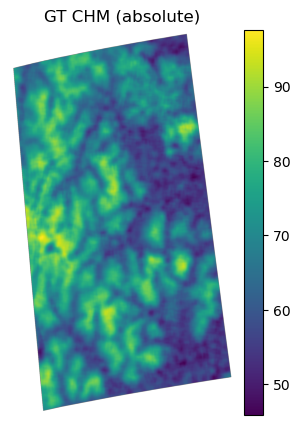

Saved: test/test10/GT_DTM_real.png


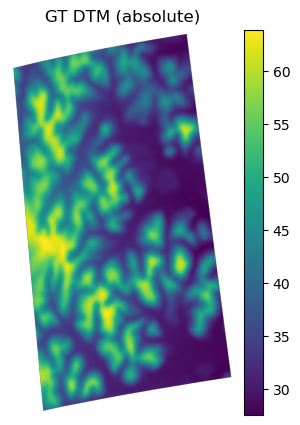

Saved: test/test10/TSNN_CHM_real.png


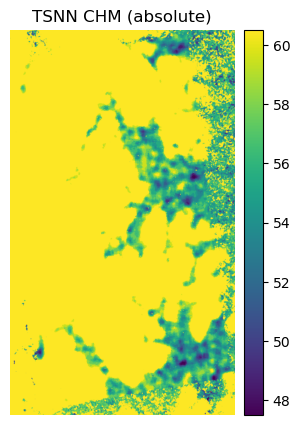

Saved: test/test10/TSNN_CHM_error.png


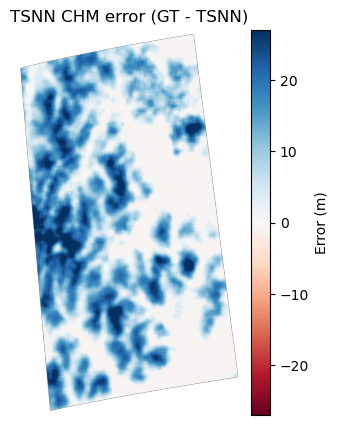

Saved: test/test10/TSNN_scatter_CHM.png


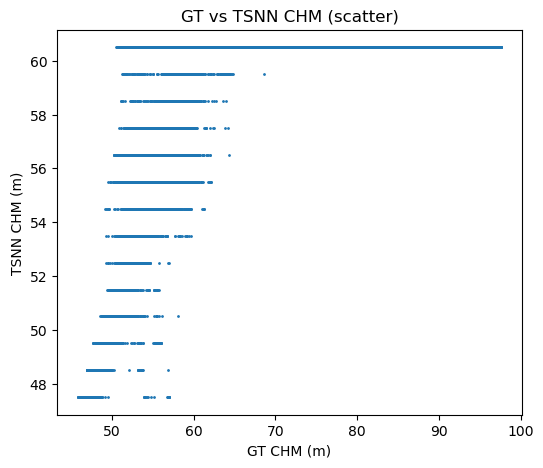

Saved: test/test10/TSNN_DTM_real.png


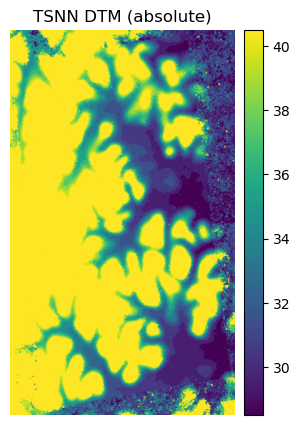

Saved: test/test10/TSNN_DTM_error.png


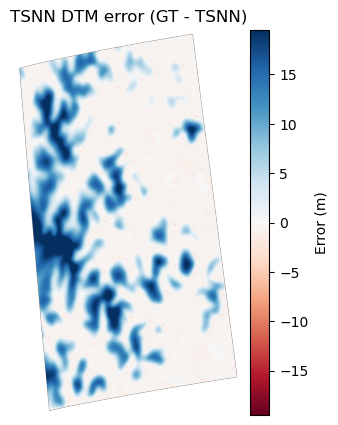

Saved: test/test10/TSNN_scatter_DTM.png


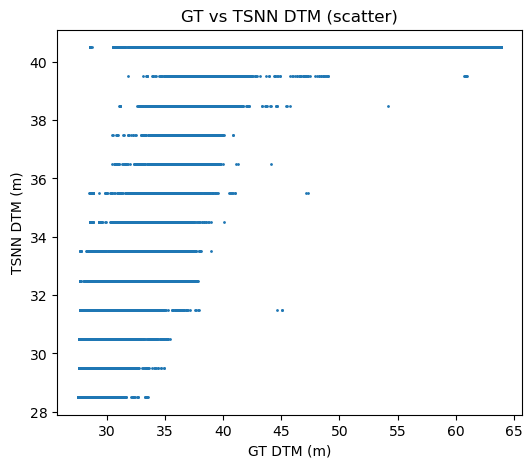

Saved: test/test10/TSNN_scatter_canopy.png


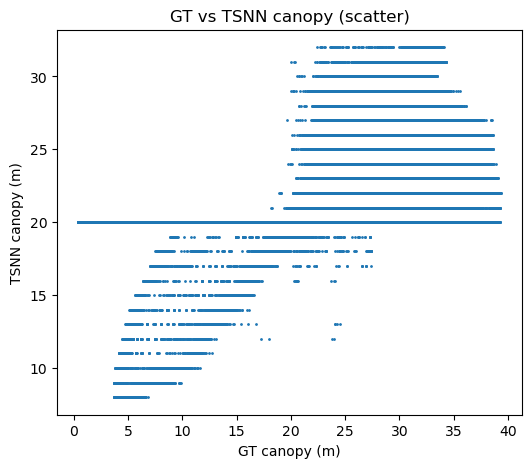

Saved: test/test10/MUSIC_CHM_real.png


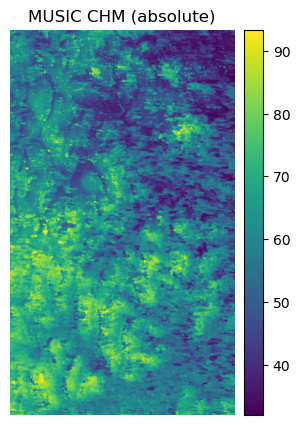

Saved: test/test10/MUSIC_CHM_error.png


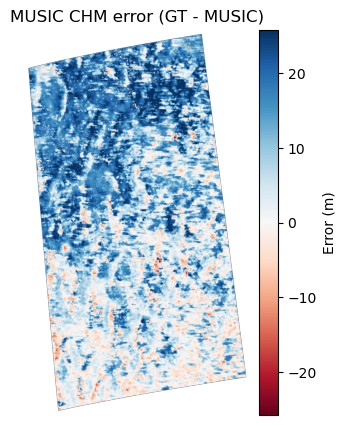

Saved: test/test10/MUSIC_scatter_CHM.png


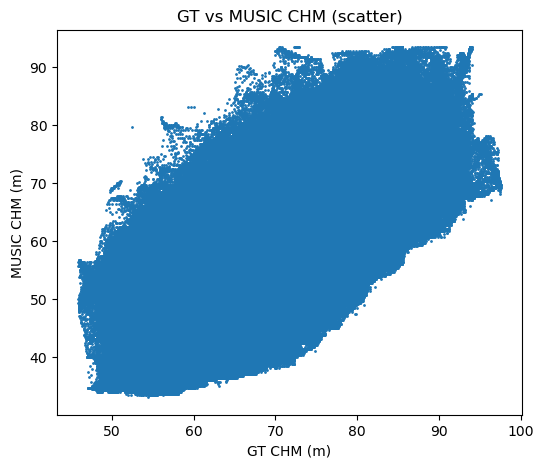

Saved: test/test10/MUSIC_DTM_real.png


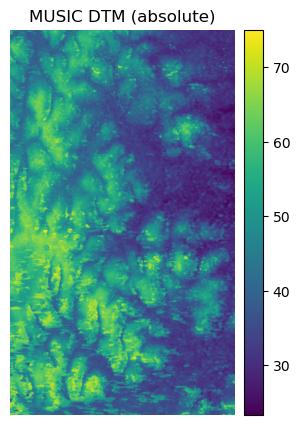

Saved: test/test10/MUSIC_DTM_error.png


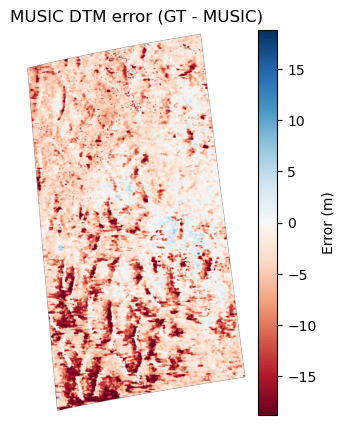

Saved: test/test10/MUSIC_scatter_DTM.png


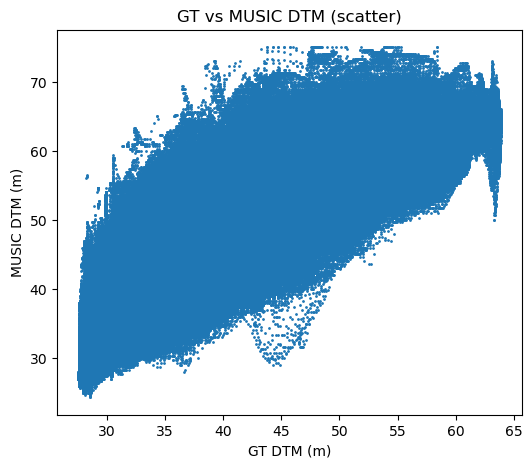

Saved: test/test10/MUSIC_scatter_canopy.png


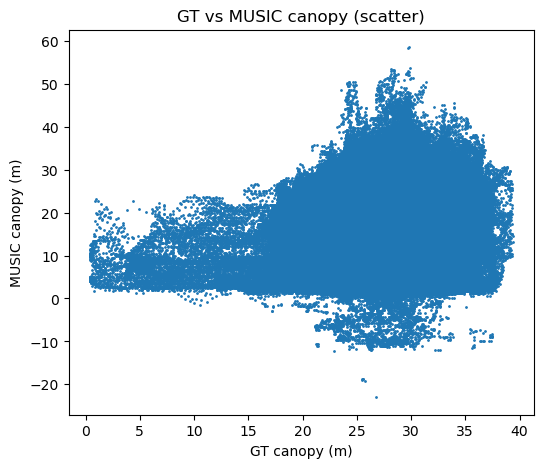

Saved: test/test10/CAPON_CHM_real.png


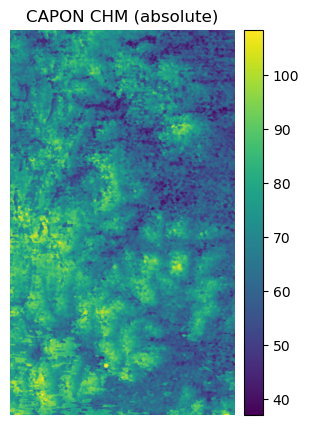

Saved: test/test10/CAPON_CHM_error.png


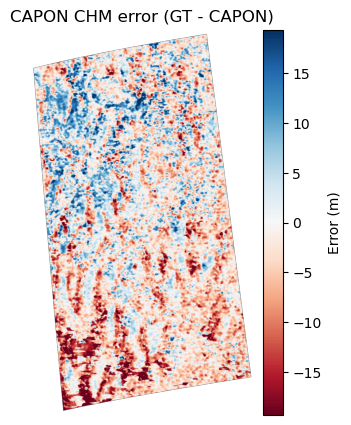

Saved: test/test10/CAPON_scatter_CHM.png


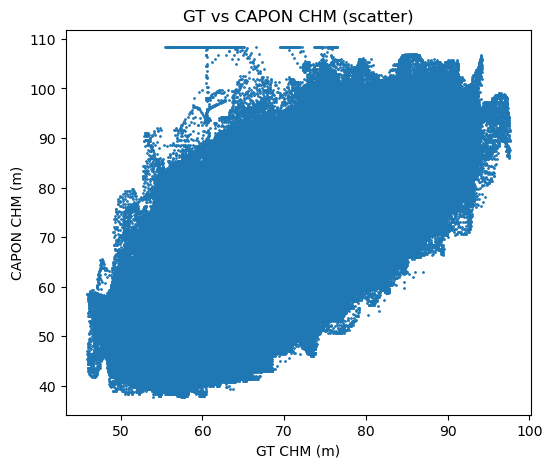

Saved: test/test10/CAPON_DTM_real.png


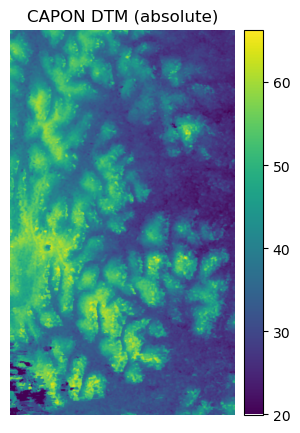

Saved: test/test10/CAPON_DTM_error.png


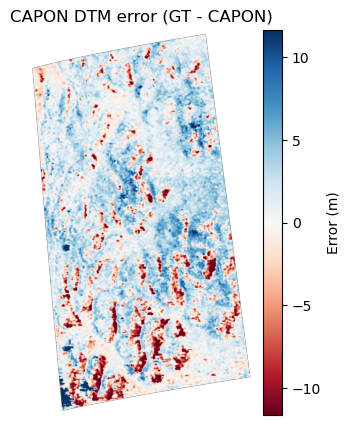

Saved: test/test10/CAPON_scatter_DTM.png


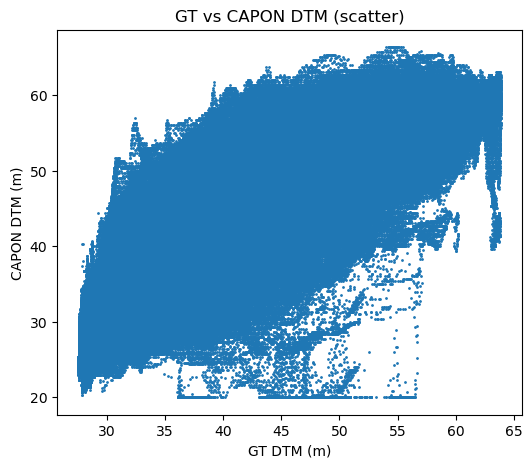

Saved: test/test10/CAPON_scatter_canopy.png


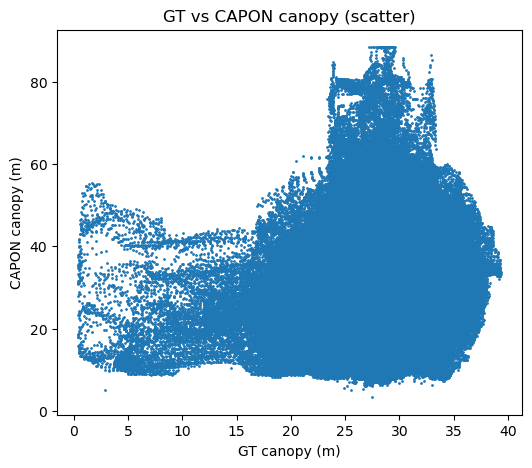

All plots & metrics saved under: test/test10


In [61]:
# === Display + metrics cell (includes CNN display + metrics for all methods) ===
import os, math, time
import numpy as np
import scipy.io
import h5py
import pandas as pd
import matplotlib.pyplot as plt
from scipy.ndimage import zoom
from matplotlib import gridspec
from IPython.display import display

OUT_DIR = "test/test10"
os.makedirs(OUT_DIR, exist_ok=True)
SHIFT = 25.0   # LiDAR "absolute" offset (you used +25 earlier)

# --- helpers ---
def align_to_shape(a, ref_shape):
    if a is None:
        return None
    a = np.array(a, dtype=np.float64)
    if a.shape == ref_shape:
        return a
    if a.T.shape == ref_shape:
        return a.T
    if a.size == ref_shape[0]*ref_shape[1]:
        return a.reshape(ref_shape)
    return zoom(a, (ref_shape[0]/a.shape[0], ref_shape[1]/a.shape[1]), order=1)

def rmse_mae_bias(pred, gt):
    mask = np.isfinite(pred) & np.isfinite(gt)
    if mask.sum() == 0:
        return (np.nan, np.nan, np.nan, 0)
    err = pred[mask].astype(np.float64) - gt[mask].astype(np.float64)
    return (math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(mask.sum()))

# --- 1) ensure GT arrays (relative) and GT real (absolute) available ---
if 'CHM_real' not in globals() or 'DTM_real' not in globals() or 'CHM_rel' not in globals():
    MAT_PATH = "DataSets/dataset_Guiana_6FPimages_Pband.mat"
    assert os.path.exists(MAT_PATH), f"GT mat not found at {MAT_PATH}"
    mat = scipy.io.loadmat(MAT_PATH)
    CHM_rel = np.array(mat['CHM'], dtype=np.float64)   # relative canopy
    DTM_rel = np.array(mat['DTM'], dtype=np.float64)   # relative ground
    DTM_real = DTM_rel + SHIFT
    CHM_real = DTM_rel + CHM_rel + SHIFT  # same as DTM_real + CHM_rel
    print("Loaded GT from mat: shapes:", CHM_rel.shape, DTM_rel.shape)
else:
    # assume CHM_real/DTM_real and relative CHM_rel/DTM_rel exist or derive
    if 'CHM_rel' not in globals():
        CHM_rel = CHM_real - DTM_real
    if 'DTM_rel' not in globals():
        DTM_rel = DTM_real - SHIFT
    print("Using in-memory GT arrays")

H, W = CHM_real.shape

# --- 2) collect method maps (CHM_rel / DTM_rel where available) ---
methods = {}   # dictionary: method -> dict with keys: chm_rel, dtm_rel, chm_real, dtm_real, is_absolute

# --- CNN predictions (relative expected) ---
cnn_chm_rel = None; cnn_dtm_rel = None
# prefer in-memory arrays
if 'pred_chm_cont' in globals() and 'pred_dtm_cont' in globals():
    cnn_chm_rel = np.array(pred_chm_cont, dtype=np.float64)
    cnn_dtm_rel = np.array(pred_dtm_cont, dtype=np.float64)
elif os.path.exists(os.path.join(OUT_DIR, "predictions_test.npz")):
    arrs = dict(np.load(os.path.join(OUT_DIR, "predictions_test.npz"), allow_pickle=True))
    if 'pred_chm_cont' in arrs and 'pred_dtm_cont' in arrs:
        cnn_chm_rel = np.array(arrs['pred_chm_cont'], dtype=np.float64)
        cnn_dtm_rel = np.array(arrs['pred_dtm_cont'], dtype=np.float64)
    elif 'pred_chm_map' in arrs and 'pred_dtm_map' in arrs:
        cnn_chm_rel = np.array(arrs['pred_chm_map'], dtype=np.float64)
        cnn_dtm_rel = np.array(arrs['pred_dtm_map'], dtype=np.float64)

if cnn_chm_rel is not None and cnn_dtm_rel is not None:
    cnn_chm_rel = align_to_shape(cnn_chm_rel, (H, W))
    cnn_dtm_rel = align_to_shape(cnn_dtm_rel, (H, W))
    methods['CNN'] = {
        'chm_rel': cnn_chm_rel,
        'dtm_rel': cnn_dtm_rel,
        'chm_real': cnn_dtm_rel + cnn_chm_rel + SHIFT,   # CNN predictions are relative -> build real
        'dtm_real': cnn_dtm_rel + SHIFT,
        'is_absolute': False
    }
    print("Added CNN to methods")

# --- TSNN predictions (you said TSNN is absolute, and you have pred_c/pred_g arrays) ---
if 'pred_c' in globals() and 'pred_g' in globals():
    pc = pred_c
    pg = pred_g
    # if torch tensors -> convert
    try:
        import torch
        if isinstance(pc, torch.Tensor): pc = pc.cpu().numpy()
        if isinstance(pg, torch.Tensor): pg = pg.cpu().numpy()
    except Exception:
        pass
    # If class labels (integers) convert to continuous by center (x + 0.5)
    if np.allclose(pc, np.round(pc)):
        pc_cont = pc + 0.5
    else:
        pc_cont = pc
    if np.allclose(pg, np.round(pg)):
        pg_cont = pg + 0.5
    else:
        pg_cont = pg
    tsnn_chm = align_to_shape(pc_cont, (H, W))
    tsnn_dtm = align_to_shape(pg_cont, (H, W))
    # TSNN is absolute (per your instruction) -> do NOT add SHIFT
    methods['TSNN'] = {
        'chm_rel': (tsnn_chm - tsnn_dtm) if (tsnn_chm is not None and tsnn_dtm is not None) else None,
        'dtm_rel': None,   # can't infer reliably if both absolute without more rules (we keep dtm absolute below)
        'chm_real': tsnn_chm,
        'dtm_real': tsnn_dtm,
        'is_absolute': True
    }
    print("Added TSNN to methods (treated as absolute)")

# --- MUSIC & CAPON (v7.3 MAT files with multiple polarizations). they are absolute maps ---
def avg_chm_dtm_from_mat(path):
    if not os.path.exists(path):
        return None, None
    d = {}
    with h5py.File(path, 'r') as f:
        for k in f.keys():
            try: d[k] = np.array(f[k])
            except: pass
    chm_keys = [k for k in d.keys() if 'chm' in k.lower()]
    dtm_keys = [k for k in d.keys() if 'dtm' in k.lower()]
    def avg_list(keys):
        if not keys: return None
        arrs=[]
        ref=None
        for k in keys:
            a = np.array(d[k], dtype=np.float64)
            if ref is None: ref = a.shape
            if a.shape == ref: arrs.append(a)
            elif a.T.shape == ref: arrs.append(a.T)
            elif a.size == ref[0]*ref[1]: arrs.append(a.reshape(ref))
        if not arrs: return None
        return np.mean(np.stack(arrs, axis=0), axis=0)
    return avg_list(chm_keys), avg_list(dtm_keys)

music_mat = "TM/MUSIC_Height_FullScene.mat"
capon_mat = "TM/CAPON_Height_FullScene.mat"
m_chm_raw, m_dtm_raw = avg_chm_dtm_from_mat(music_mat)
c_chm_raw, c_dtm_raw = avg_chm_dtm_from_mat(capon_mat)

if m_chm_raw is not None:
    m_chm = align_to_shape(m_chm_raw, (H, W)); m_dtm = align_to_shape(m_dtm_raw, (H, W))
    # MUSIC maps are absolute -> do not add SHIFT
    methods['MUSIC'] = {'chm_rel': (m_chm - m_dtm), 'dtm_rel': None, 'chm_real': m_chm, 'dtm_real': m_dtm, 'is_absolute': True}
    print("Added MUSIC")
if c_chm_raw is not None:
    c_chm = align_to_shape(c_chm_raw, (H, W)); c_dtm = align_to_shape(c_dtm_raw, (H, W))
    methods['CAPON'] = {'chm_rel': (c_chm - c_dtm), 'dtm_rel': None, 'chm_real': c_chm, 'dtm_real': c_dtm, 'is_absolute': True}
    print("Added CAPON")

# --- 3) Build metrics comparing each method to GT (GT_real & GT_canopy_rel) ---
GT_canopy_rel = CHM_rel  # GT canopy relative (CHM - DTM)
GT_CHM_real = CHM_real
GT_DTM_real = DTM_real

rows = []
for name, d in methods.items():
    # prepare arrays in a canonical form (real absolute heights where possible)
    chm_real = d.get('chm_real', None)
    dtm_real = d.get('dtm_real', None)
    # for methods marked relative (CNN), ensure we have real versions already in dict
    if not d['is_absolute']:
        # for CNN we created chm_real and dtm_real earlier
        pass

    # CHM metrics vs GT_real (if available)
    if chm_real is not None:
        rm, mae, bias, cnt = rmse_mae_bias(chm_real, GT_CHM_real)
        rows.append({'method': name, 'variable': 'CHM', 'ref': 'GT_real', 'rmse': rm, 'mae': mae, 'bias': bias, 'count': cnt})
    # DTM metrics vs GT_real (if available)
    if dtm_real is not None:
        rm, mae, bias, cnt = rmse_mae_bias(dtm_real, GT_DTM_real)
        rows.append({'method': name, 'variable': 'DTM', 'ref': 'GT_real', 'rmse': rm, 'mae': mae, 'bias': bias, 'count': cnt})

    # Canopy (relative) metrics vs GT_canopy_rel
    # define method_canopy_rel: prefer provided chm_rel; otherwise chm_real - dtm_real
    method_canopy_rel = d.get('chm_rel', None)
    if method_canopy_rel is None and chm_real is not None and dtm_real is not None:
        method_canopy_rel = chm_real - dtm_real
    if method_canopy_rel is not None:
        rm, mae, bias, cnt = rmse_mae_bias(method_canopy_rel, GT_canopy_rel)
        rows.append({'method': name, 'variable': 'Canopy_rel', 'ref': 'GT_canopy_rel', 'rmse': rm, 'mae': mae, 'bias': bias, 'count': cnt})

# Put in dataframe and save
df = pd.DataFrame(rows)
csv_path = os.path.join(OUT_DIR, "comparison_metrics_all_methods.csv")
df.to_csv(csv_path, index=False)
print("Saved metrics CSV:", csv_path)
display(df.head(40))

# --- 4) Plotting: CHM and DTM maps and error maps (each map its own color scaling), plus scatter GT vs pred ---
def save_map(fig, outname):
    p = os.path.join(OUT_DIR, outname)
    fig.savefig(p, dpi=160, bbox_inches='tight')
    print("Saved:", p)

# function to plot single map with colorbar (no numeric vmin/vmax)
def plot_single_map(arr, title, fname):
    fig = plt.figure(figsize=(6,5))
    ax = fig.add_subplot(1,1,1)
    im = ax.imshow(arr)
    ax.set_title(title)
    ax.axis('off')
    cb = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
    save_map(fig, fname)
    plt.show()

# function to plot error map (GT_real - method_real), symmetric color range using 98th percentile
def plot_error_map(pred_arr, gt_arr, title, fname):
    err = gt_arr - pred_arr
    mag = np.nanpercentile(np.abs(err), 98)
    if (not np.isfinite(mag)) or mag == 0:
        mag = np.nanpercentile(np.abs(err[~np.isnan(err)]), 90) if np.any(~np.isnan(err)) else 1.0
    fig = plt.figure(figsize=(6,5))
    ax = fig.add_subplot(1,1,1)
    im = ax.imshow(err, cmap='RdBu', vmin=-mag, vmax=mag)
    ax.set_title(title)
    ax.axis('off')
    cb = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
    cb.set_label("Error (m)")
    save_map(fig, fname)
    plt.show()

# Plot GT maps
plot_single_map(GT_CHM_real, "GT CHM (absolute)", "GT_CHM_real.png")
plot_single_map(GT_DTM_real, "GT DTM (absolute)", "GT_DTM_real.png")

# For each method plot CHM, DTM and errors, plus scatter GT vs pred (CHM & DTM & Canopy)
for name, d in methods.items():
    chm_real = d.get('chm_real', None)
    dtm_real = d.get('dtm_real', None)
    method_canopy_rel = d.get('chm_rel', None)
    if method_canopy_rel is None and chm_real is not None and dtm_real is not None:
        method_canopy_rel = chm_real - dtm_real

    if chm_real is not None:
        plot_single_map(chm_real, f"{name} CHM (absolute)", f"{name}_CHM_real.png")
        plot_error_map(chm_real, GT_CHM_real, f"{name} CHM error (GT - {name})", f"{name}_CHM_error.png")

        # scatter GT vs pred (CHM)
        fig = plt.figure(figsize=(6,5))
        ax = fig.add_subplot(1,1,1)
        mask = np.isfinite(chm_real) & np.isfinite(GT_CHM_real)
        ax.scatter(GT_CHM_real[mask].ravel(), chm_real[mask].ravel(), s=1)
        ax.set_xlabel("GT CHM (m)"); ax.set_ylabel(f"{name} CHM (m)")
        ax.set_title(f"GT vs {name} CHM (scatter)")
        save_map(fig, f"{name}_scatter_CHM.png")
        plt.show()

    if dtm_real is not None:
        plot_single_map(dtm_real, f"{name} DTM (absolute)", f"{name}_DTM_real.png")
        plot_error_map(dtm_real, GT_DTM_real, f"{name} DTM error (GT - {name})", f"{name}_DTM_error.png")

        # scatter GT vs pred (DTM)
        fig = plt.figure(figsize=(6,5))
        ax = fig.add_subplot(1,1,1)
        mask = np.isfinite(dtm_real) & np.isfinite(GT_DTM_real)
        ax.scatter(GT_DTM_real[mask].ravel(), dtm_real[mask].ravel(), s=1)
        ax.set_xlabel("GT DTM (m)"); ax.set_ylabel(f"{name} DTM (m)")
        ax.set_title(f"GT vs {name} DTM (scatter)")
        save_map(fig, f"{name}_scatter_DTM.png")
        plt.show()

    # canopy scatter if available
    if method_canopy_rel is not None:
        fig = plt.figure(figsize=(6,5))
        ax = fig.add_subplot(1,1,1)
        mask = np.isfinite(method_canopy_rel) & np.isfinite(GT_canopy_rel)
        ax.scatter(GT_canopy_rel[mask].ravel(), method_canopy_rel[mask].ravel(), s=1)
        ax.set_xlabel("GT canopy (m)"); ax.set_ylabel(f"{name} canopy (m)")
        ax.set_title(f"GT vs {name} canopy (scatter)")
        save_map(fig, f"{name}_scatter_canopy.png")
        plt.show()

print("All plots & metrics saved under:", OUT_DIR)


Saved figure to test/test12/transect_midrow_CHM.png


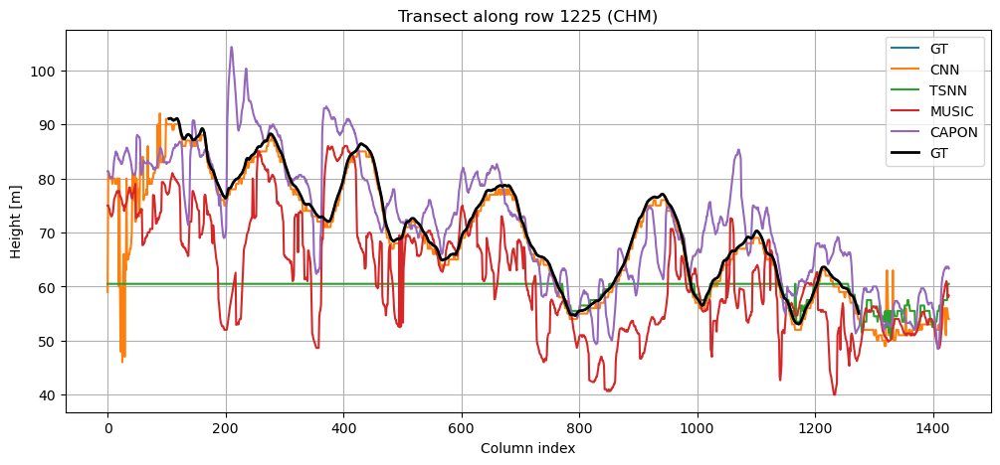

Saved transect data to test/test12/transect_midrow_CHM.csv


In [73]:
# ---------- Dynamic transect line plot with save option ----------
import matplotlib.pyplot as plt
import pandas as pd

def plot_transect(row_idx=None, var="CHM", save_path=None, also_csv=False):
    """
    row_idx : int or None
        If None, will use middle row. Otherwise plot the given row index.
    var : "CHM" or "DTM"
    save_path : str or None
        If provided, saves the figure as PNG to this path.
    also_csv : bool
        If True, also saves transect values as CSV next to the figure.
    """
    if var not in ["CHM","DTM"]:
        raise ValueError("var must be 'CHM' or 'DTM'")

    ref = CHM_real if var=="CHM" else DTM_real
    names = list(display_chm.keys()) if var=="CHM" else list(display_dtm.keys())
    methods_dict = display_chm if var=="CHM" else display_dtm

    if row_idx is None:
        row_idx = ref.shape[0]//2

    # --- Plot ---
    plt.figure(figsize=(12,5))
    for name in names:
        arr = methods_dict[name]
        if arr is None: continue
        plt.plot(arr[row_idx, :], label=name)

    plt.plot(ref[row_idx, :], label="GT", color="black", linewidth=2)
    plt.title(f"Transect along row {row_idx} ({var})")
    plt.xlabel("Column index")
    plt.ylabel("Height [m]")
    plt.legend()
    plt.grid(True)

    if save_path:
        plt.savefig(save_path, dpi=160, bbox_inches='tight')
        print(f"Saved figure to {save_path}")

    plt.show()

    # --- Save CSV if requested ---
    if also_csv and save_path:
        df = pd.DataFrame({"col": np.arange(ref.shape[1])})
        for name in names:
            arr = methods_dict[name]
            if arr is not None:
                df[name] = arr[row_idx, :]
        csv_path = save_path.replace(".png", ".csv")
        df.to_csv(csv_path, index=False)
        print(f"Saved transect data to {csv_path}")


# Example usage:
# plot_transect(150, "CHM", save_path="test/test/transect_row150_CHM.png", also_csv=True)
# plot_transect(220, "DTM", save_path="test/test/transect_row220_DTM.png")
plot_transect(None, "CHM", save_path="test/test12/transect_midrow_CHM.png", also_csv=True)


Saved figure to test/test12/transect_row500_DTM.png


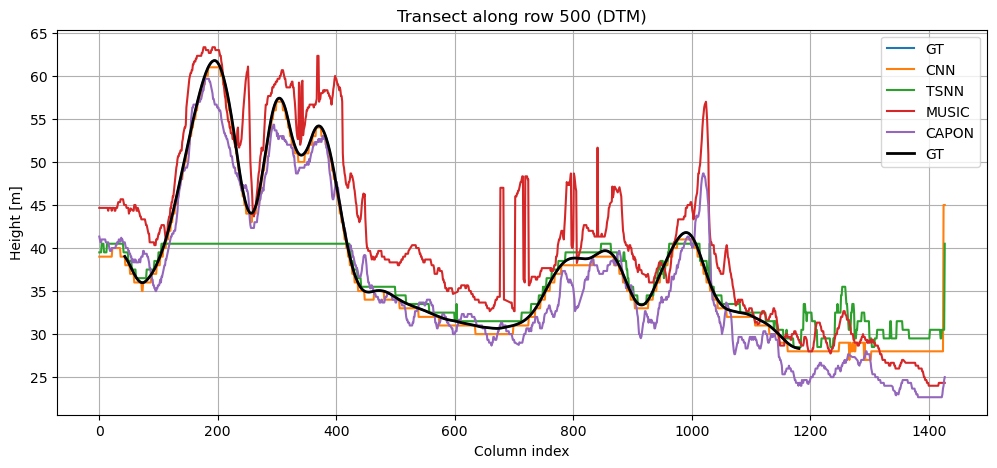

Saved transect data to test/test12/transect_row500_DTM.csv


In [74]:
plot_transect(500, "DTM", save_path="test/test12/transect_row500_DTM.png", also_csv=True)

In [ ]:
#plot_transect(500, "DTM", save_path="test/test12/transect_row220_DTM.png")

GT shapes: (2450, 1428) (2450, 1428)
CNN shapes: (2450, 1428) (2450, 1428)
MUSIC shapes (raw): (2450, 1428) (2450, 1428)
CAPON shapes (raw): (2450, 1428) (2450, 1428)
Saved metrics to: test/test7/metrics_all_vs_GT_real.csv
   source variable  reference       rmse        mae       bias    count
0     CNN      CHM    GT_real   1.079259   0.997777  -0.997712  2555060
1   MUSIC      CHM    GT_real  12.614684  10.033870  -8.838491  2555060
2   CAPON      CHM    GT_real   7.649497   5.893505   1.673226  2555060
3    TSNN      CHM    GT_real  12.642672   9.506821  -9.405140  2555060
4     CNN      DTM    GT_real   0.577758   0.499935  -0.499213  2555060
5   MUSIC      DTM    GT_real   6.987821   5.133546   4.943580  2555060
6   CAPON      DTM    GT_real   4.114496   3.011088  -0.965534  2555060
7    TSNN      DTM    GT_real   7.391940   4.471109  -4.271540  2555060
8     CNN   Canopy  GT_canopy   0.577265   0.499256  -0.498499  2555060
9   MUSIC   Canopy  GT_canopy  16.081494  14.033719 -13.7

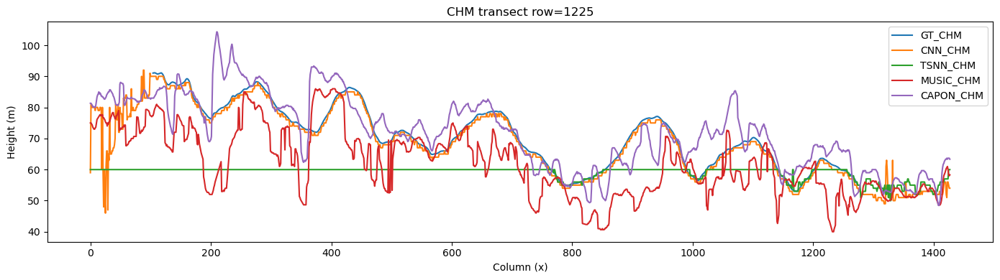

Saved: test/test7/transect_chm.png


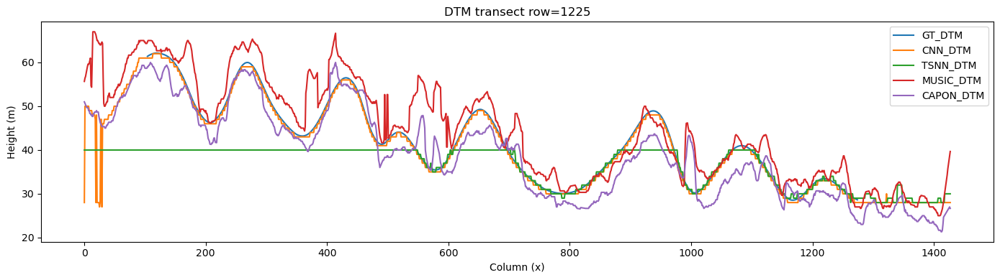

Saved: test/test7/transect_dtm.png
Done. Metrics, maps and transect plots saved to test/test7


In [53]:
# === Evaluation & plotting cell (fixed) ===
import os, math
import numpy as np
import scipy.io
import h5py
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from scipy.ndimage import zoom

# --- USER PATHS (edit if needed) ---
GT_MAT    = "DataSets/dataset_Guiana_6FPimages_Pband.mat"
PRED_NPZ  = "predictions_unlabeled/predictions_unlabeled_with_uncertainty.npz"
MUSIC_MAT = "TM/MUSIC_Height_FullScene.mat"
CAPON_MAT = "TM/CAPON_Height_FullScene.mat"
OUT_DIR   = "test/test7"
os.makedirs(OUT_DIR, exist_ok=True)

SHIFT = 25.0   # only used to build GT_real & CNN_real (if pred are relative)
# If your CNN predictions are already "relative", we convert the same way you did earlier.

# --- helpers ---
def rmse_mae_bias(pred, gt):
    mask = np.isfinite(pred) & np.isfinite(gt)
    if mask.sum() == 0:
        return (np.nan, np.nan, np.nan, 0)
    err = pred[mask].astype(np.float64) - gt[mask].astype(np.float64)
    return (math.sqrt((err**2).mean()), float(np.mean(np.abs(err))), float(np.mean(err)), int(mask.sum()))

def load_mat_v73(path):
    d = {}
    if not os.path.exists(path):
        return d
    with h5py.File(path, 'r') as f:
        for k in f.keys():
            try:
                d[k] = np.array(f[k])
            except Exception:
                d[k] = None
    return d

def avg_chm_dtm_from_matdict(d):
    if not d: return None, None
    keys = list(d.keys())
    chm_keys = [k for k in keys if 'chm' in k.lower()]
    dtm_keys = [k for k in keys if 'dtm' in k.lower()]
    def avg_list(kl):
        arrs = []
        for k in kl:
            a = d.get(k)
            if a is None: continue
            try:
                arrs.append(np.array(a, dtype=np.float64))
            except:
                pass
        if not arrs:
            return None
        ref = arrs[0].shape
        arrs2 = []
        for a in arrs:
            if a.shape == ref: arrs2.append(a)
            elif a.T.shape == ref: arrs2.append(a.T)
            elif a.size == ref[0]*ref[1]:
                arrs2.append(a.reshape(ref))
        if not arrs2:
            arrs2 = arrs
        return np.mean(np.stack(arrs2, axis=0), axis=0)
    return avg_list(chm_keys), avg_list(dtm_keys)

def align_to_ref(a, ref):
    if a is None: return None
    a = np.array(a, dtype=np.float64)
    if a.shape == ref.shape:
        return a
    if a.T.shape == ref.shape:
        return a.T
    if a.size == ref.size:
        return a.reshape(ref.shape)
    # fallback: resize by zoom
    return zoom(a, (ref.shape[0]/a.shape[0], ref.shape[1]/a.shape[1]), order=1)

# --- 1) Load GT LiDAR (relative arrays in mat) and build "real" absolute heights ---
mat = scipy.io.loadmat(GT_MAT)
CHM_rel = np.array(mat['CHM'], dtype=np.float64)      # relative canopy above ground
DTM_rel = np.array(mat['DTM'], dtype=np.float64)      # relative ground (DTM)
H, W = CHM_rel.shape
DTM_real = DTM_rel + SHIFT
CHM_real = DTM_rel + CHM_rel + SHIFT   # GT_real canopy absolute height

print("GT shapes:", CHM_rel.shape, DTM_rel.shape)

# --- 2) Load CNN predictions (either continuous or map) ---
pred = np.load(PRED_NPZ, allow_pickle=True)
cnn_chm_rel = pred.get('pred_chm_cont', pred.get('pred_chm_map', None))
cnn_dtm_rel = pred.get('pred_dtm_cont', pred.get('pred_dtm_map', None))
if cnn_chm_rel is None or cnn_dtm_rel is None:
    raise RuntimeError("CNN predictions not found in npz. Need pred_chm_cont/pred_chm_map and pred_dtm_cont/pred_dtm_map.")
cnn_chm_rel = np.array(cnn_chm_rel, dtype=np.float64)
cnn_dtm_rel = np.array(cnn_dtm_rel, dtype=np.float64)
# build real absolute as you did earlier:
CNN_DTM_real = cnn_dtm_rel + SHIFT
CNN_CHM_real = cnn_dtm_rel + cnn_chm_rel + SHIFT

print("CNN shapes:", cnn_chm_rel.shape, cnn_dtm_rel.shape)

# --- 3) Load MUSIC & CAPON (average across polarizations) ---
music_dict = load_mat_v73(MUSIC_MAT)
capon_dict = load_mat_v73(CAPON_MAT)
MUSIC_chm_raw, MUSIC_dtm_raw = avg_chm_dtm_from_matdict(music_dict)
CAPON_chm_raw, CAPON_dtm_raw = avg_chm_dtm_from_matdict(capon_dict)

# Align to GT shape
MUSIC_chm_raw = align_to_ref(MUSIC_chm_raw, CHM_rel) if MUSIC_chm_raw is not None else None
MUSIC_dtm_raw = align_to_ref(MUSIC_dtm_raw, DTM_rel) if MUSIC_dtm_raw is not None else None
CAPON_chm_raw = align_to_ref(CAPON_chm_raw, CHM_rel) if CAPON_chm_raw is not None else None
CAPON_dtm_raw = align_to_ref(CAPON_dtm_raw, DTM_rel) if CAPON_dtm_raw is not None else None

print("MUSIC shapes (raw):", None if MUSIC_chm_raw is None else MUSIC_chm_raw.shape, None if MUSIC_dtm_raw is None else MUSIC_dtm_raw.shape)
print("CAPON shapes (raw):", None if CAPON_chm_raw is None else CAPON_chm_raw.shape, None if CAPON_dtm_raw is None else CAPON_dtm_raw.shape)

# --- 4) TSNN predictions (you already have pred_c, pred_g shaped (H,W)) ---
# Make sure pred_c and pred_g are numpy arrays and same shape as GT:
# pred_c: predicted canopy above ground (relative), pred_g: predicted ground (DTM) absolute (if TSNN is absolute)
# The user said TSNN is absolute like MUSIC/CAPON. If pred_g is already absolute, we use as is.
# If pred_c is canopy above ground, then TSNN_CHM_real = pred_g + pred_c
pred_c = np.array(pred_c)  # canopy above ground (class->cont or continuous)
pred_g = np.array(pred_g)  # DTM (absolute)  -- user indicated TSNN is absolute
if pred_c.shape != (H, W) or pred_g.shape != (H, W):
    raise RuntimeError(f"TSNN pred shapes must match GT. Got pred_c {pred_c.shape}, pred_g {pred_g.shape}, GT {H,W}")

TSNN_DTM_real = pred_g                # absolute
TSNN_CHM_real = pred_c      # absolute canopy

# --- 5) Metrics (CHM, DTM, CANOPY (CHM-DTM)) ---
rows = []
def add_metric_row(source, var, ref_name, ref_arr, pred_arr):
    if pred_arr is None:
        return
    # ensure same shape/alignment
    pred_al = align_to_ref(pred_arr, ref_arr) if pred_arr.shape != ref_arr.shape else pred_arr
    r = rmse_mae_bias(pred_al, ref_arr)
    rows.append({"source":source, "variable":var, "reference":ref_name,
                 "rmse":r[0], "mae":r[1], "bias":r[2], "count":r[3]})

# CHM: compare everything to GT_real (absolute CHM_real)
add_metric_row("CNN",  "CHM", "GT_real", CHM_real, CNN_CHM_real)
add_metric_row("MUSIC","CHM", "GT_real", CHM_real, MUSIC_chm_raw)
add_metric_row("CAPON","CHM", "GT_real", CHM_real, CAPON_chm_raw)
add_metric_row("TSNN", "CHM", "GT_real", CHM_real, TSNN_CHM_real)

# DTM: compare to GT_real (DTM_real)
add_metric_row("CNN",  "DTM", "GT_real", DTM_real, CNN_DTM_real)
add_metric_row("MUSIC","DTM", "GT_real", DTM_real, MUSIC_dtm_raw)
add_metric_row("CAPON","DTM", "GT_real", DTM_real, CAPON_dtm_raw)
add_metric_row("TSNN", "DTM", "GT_real", DTM_real, TSNN_DTM_real)

# Canopy (relative CHM - DTM): compute reference and predictions
GT_canopy = CHM_real - DTM_real                   # equals CHM_rel
CNN_canopy = CNN_CHM_real - CNN_DTM_real
TSNN_canopy = TSNN_CHM_real - TSNN_DTM_real
MUSIC_canopy = None if (MUSIC_chm_raw is None or MUSIC_dtm_raw is None) else (MUSIC_chm_raw - MUSIC_dtm_raw)
CAPON_canopy = None if (CAPON_chm_raw is None or CAPON_dtm_raw is None) else (CAPON_chm_raw - CAPON_dtm_raw)

add_metric_row("CNN",  "Canopy", "GT_canopy", GT_canopy, CNN_canopy)
add_metric_row("MUSIC","Canopy", "GT_canopy", GT_canopy, MUSIC_canopy)
add_metric_row("CAPON","Canopy", "GT_canopy", GT_canopy, CAPON_canopy)
add_metric_row("TSNN", "Canopy", "GT_canopy", GT_canopy, TSNN_canopy)

df = pd.DataFrame(rows)
csv_path = os.path.join(OUT_DIR, "metrics_all_vs_GT_real.csv")
df.to_csv(csv_path, index=False)
print("Saved metrics to:", csv_path)
print(df)

# --- 6) Save prediction maps (so you can inspect later) ---
np.savez_compressed(os.path.join(OUT_DIR, "maps_all.npz"),
                    GT_CHM=CHM_real, GT_DTM=DTM_real,
                    CNN_CHM=CNN_CHM_real, CNN_DTM=CNN_DTM_real,
                    TSNN_CHM=TSNN_CHM_real, TSNN_DTM=TSNN_DTM_real,
                    MUSIC_CHM=MUSIC_chm_raw, MUSIC_DTM=MUSIC_dtm_raw,
                    CAPON_CHM=CAPON_chm_raw, CAPON_DTM=CAPON_dtm_raw)
print("Saved maps to:", os.path.join(OUT_DIR, "maps_all.npz"))

# --- 7) Transect plots (middle row by default) ---
row = H // 2
x = np.arange(W)

def transect_plot(ylist, labels, title, fname):
    plt.figure(figsize=(14,4))
    for arr, lab in zip(ylist, labels):
        if arr is None: 
            continue
        plt.plot(x, arr[row, :], label=lab)
    plt.xlabel("Column (x)")
    plt.ylabel("Height (m)")
    plt.title(title)
    plt.legend()
    outp = os.path.join(OUT_DIR, fname)
    plt.tight_layout()
    plt.savefig(outp, dpi=160)
    plt.show()
    print("Saved:", outp)

# Build arrays list (only include if available)
chm_arrays = [CHM_real, CNN_CHM_real, TSNN_CHM_real, MUSIC_chm_raw, CAPON_chm_raw]
chm_labels = ["GT_CHM", "CNN_CHM", "TSNN_CHM", "MUSIC_CHM", "CAPON_CHM"]

dtm_arrays = [DTM_real, CNN_DTM_real, TSNN_DTM_real, MUSIC_dtm_raw, CAPON_dtm_raw]
dtm_labels = ["GT_DTM", "CNN_DTM", "TSNN_DTM", "MUSIC_DTM", "CAPON_DTM"]

transect_plot(chm_arrays, chm_labels, f"CHM transect row={row}", "transect_chm.png")
transect_plot(dtm_arrays, dtm_labels, f"DTM transect row={row}", "transect_dtm.png")

print("Done. Metrics, maps and transect plots saved to", OUT_DIR)


In [102]:
print("CNN_canopy:", CNN_canopy.shape)
print("MUSIC_canopy:", MUSIC_canopy.shape)
print("CAPON_canopy:", CAPON_canopy.shape)
print("mask_chm:", mask_chm.shape)


CNN_canopy: (2450, 1428)
MUSIC_canopy: (2450, 1428)
CAPON_canopy: (2450, 1428)
mask_chm: (2450, 1428)
